#                         SriLanka Chapter-Predicting Dengue Fever Outbreaks
 

Mir Tahmid 

mirtahmid@gmail.com

# Dataset Overview

The dataset contains 22,950 entries and 19 columns. The columns cover various weather-related metrics, along with dengue case counts, district names, and dates. Here's a summary of the key aspects:

Date Columns: Week_Start_Date, Week_End_Date (currently as strings).

Weather Data: Temperature, precipitation, wind speed, daylight duration, etc.

Dengue Case Data: Number_of_Cases.

District Information: District.

The dataset has no missing values, and the date columns have been successfully converted to datetime format. Additional time-related features, such as Weekday_Start, Weekday_End, and Day_of_Year, have been extracted.

Next, we'll proceed with the following steps:

**This notebpok performs dengue case forecasting for different districts in Sri Lanka, using the Gradient Boosting Regressor model. Here’s a step by step process of workflows**

**1. Import Libraries, Load and Preprocess Data**

The dataset is loaded, and the Week_Start_Date column is converted to datetime format.

The dataset is sorted by date to ensure temporal consistency.

**2. Exploratory Data Analysis (EDA)**

Basic Info: Displays the dataset’s structure and summary statistics.

Pie Chart: Shows the distribution of total dengue cases across districts.

Bar Plot: Displays total dengue cases for each district.

Line Plot: Plots total dengue cases over time.

**3. Feature Engineering**

Two new features are created:

lag_1: Number of dengue cases lagged by 1 week.

rolling_mean_3: 3-week rolling mean of dengue cases for each district.

Missing values after these calculations are dropped.

**4. Model Training and Forecasting per District**

For each district, the data is split into training (up to May 7, 2024) and testing (from May 8, 2024, to July 30, 2024) sets.

Gradient Boosting Regressor is trained on the features: Avg Max Temp, Total Precipitation, lag_1, and rolling_mean_3.

Predictions are made for the test period and for 12 weeks ahead (starting from July 30, 2024).
The forecasts for each district are stored, and plots show actual vs. predicted cases.

**5. RMSE Calculation**

Root Mean Squared Error (RMSE) is calculated for each district, comparing actual vs. predicted values for the test period.

Mean RMSE across all districts is also calculated.

**6. Visualization**

For each district, a plot shows:

Training data (2007 to May 2024),

Actual test data (May 2024 to July 2024),

Forecast for the 12 weeks after July 2024.

**7. Hyperparameter Tuning:** Hyperparamter Tuning across all the districts to find out better RMSE. 

**This notebook provides a descriptive workflow for analyzing and forecasting dengue cases across different districts in Sri Lanka. The model captures both historical trends and forecasts future cases using weather data and lag/rolling features to improve predictive accuracy.**

# Predicting Dengue Fever Outbreaks using Gradient Boosting

Basic Info of the dataset:

<class 'pandas.core.frame.DataFrame'>
Index: 22900 entries, 0 to 22899
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   District                       22900 non-null  object        
 1   Number_of_Cases                22900 non-null  int64         
 2   Week_Start_Date                22900 non-null  datetime64[ns]
 3   Month                          22900 non-null  int64         
 4   Year                           22900 non-null  int64         
 5   Week                           22900 non-null  int64         
 6   Week_End_Date                  22900 non-null  object        
 7   Avg Max Temp (°C)              22900 non-null  float64       
 8   Avg Min Temp (°C)              22900 non-null  float64       
 9   Avg Apparent Max Temp (°C)     22900 non-null  float64       
 10  Avg Apparent Min Temp (°C)     22900 non-null  float64     

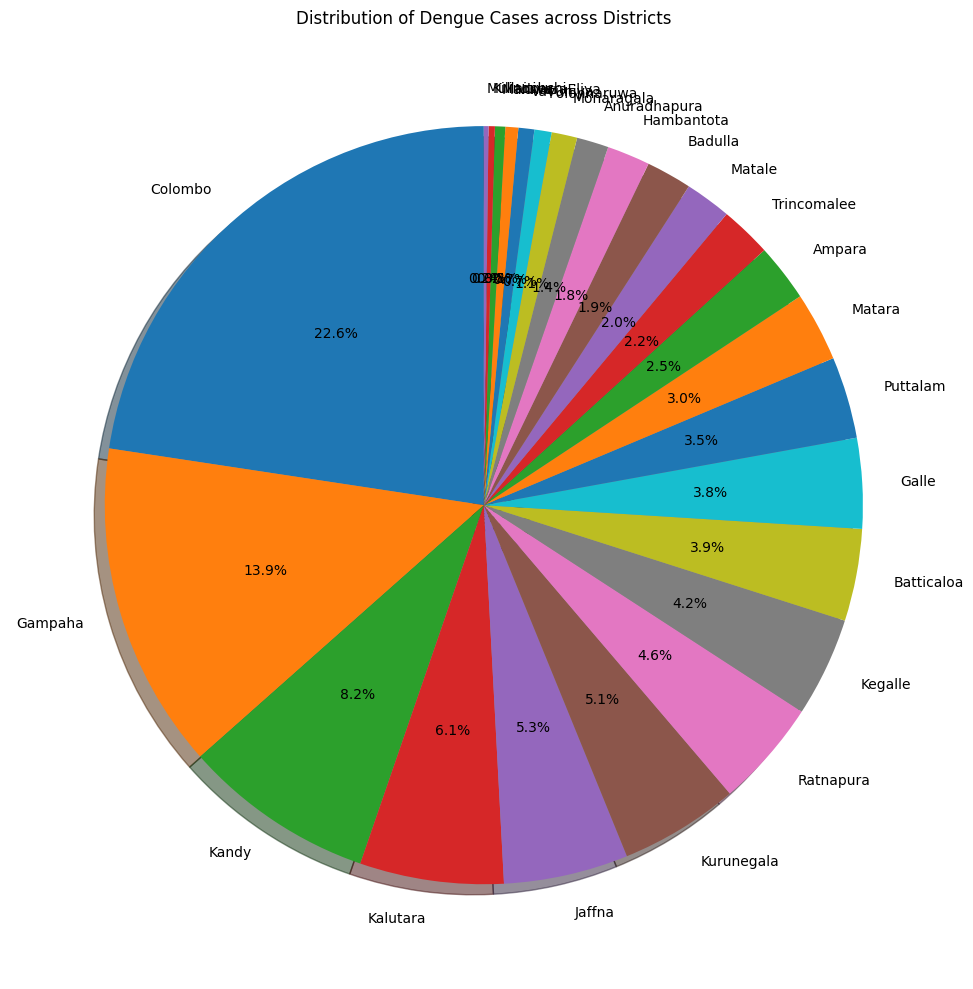

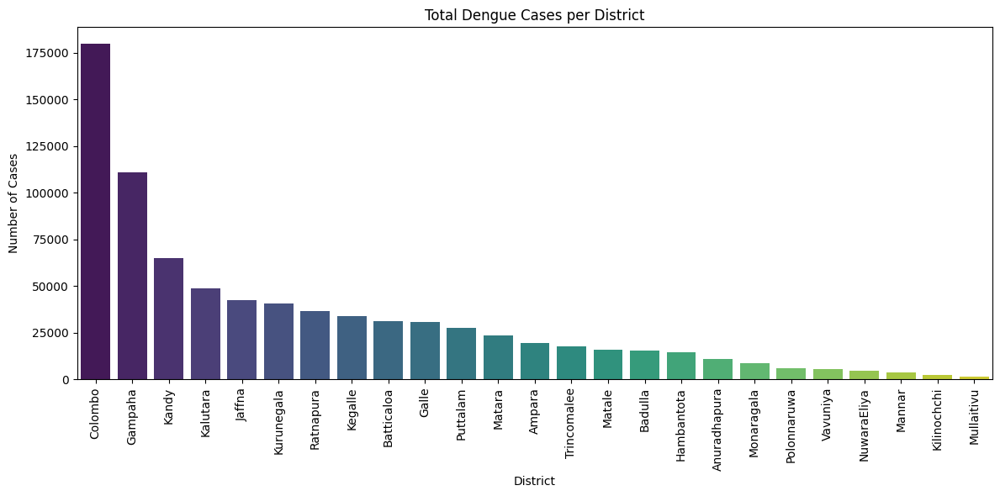

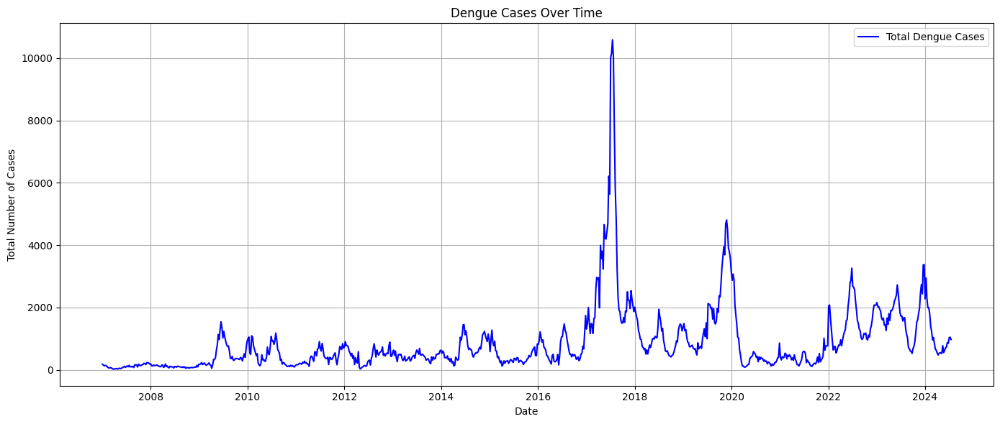

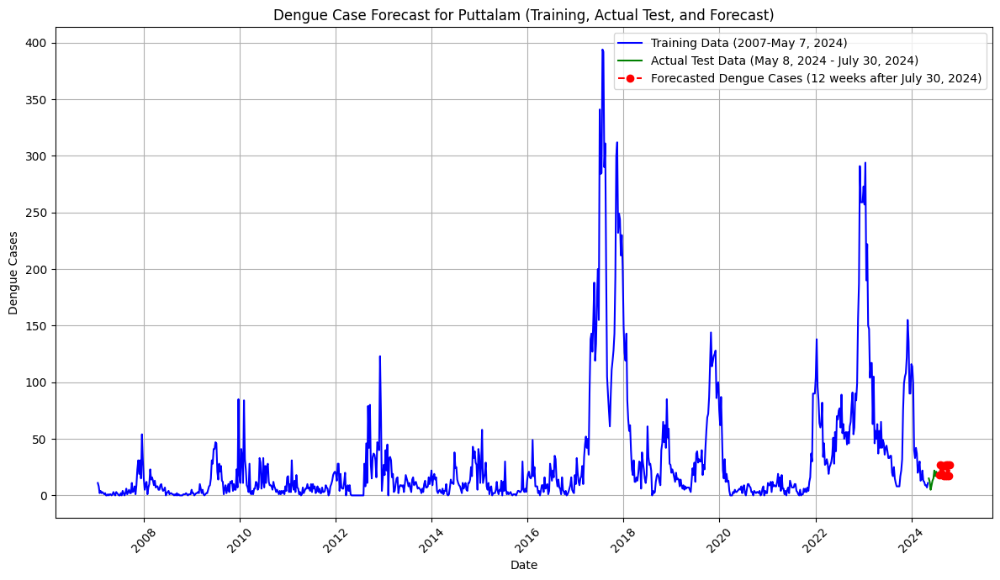

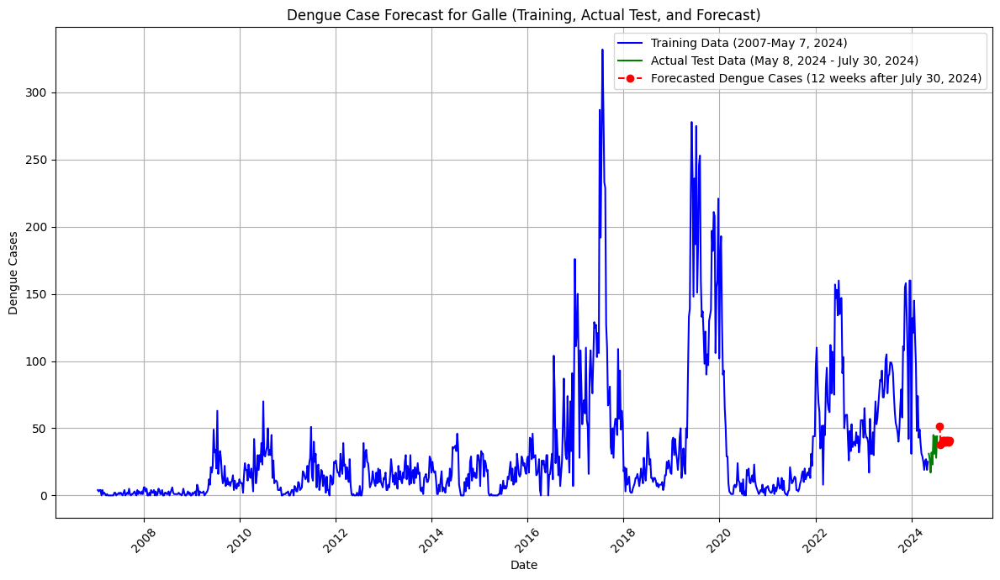

...

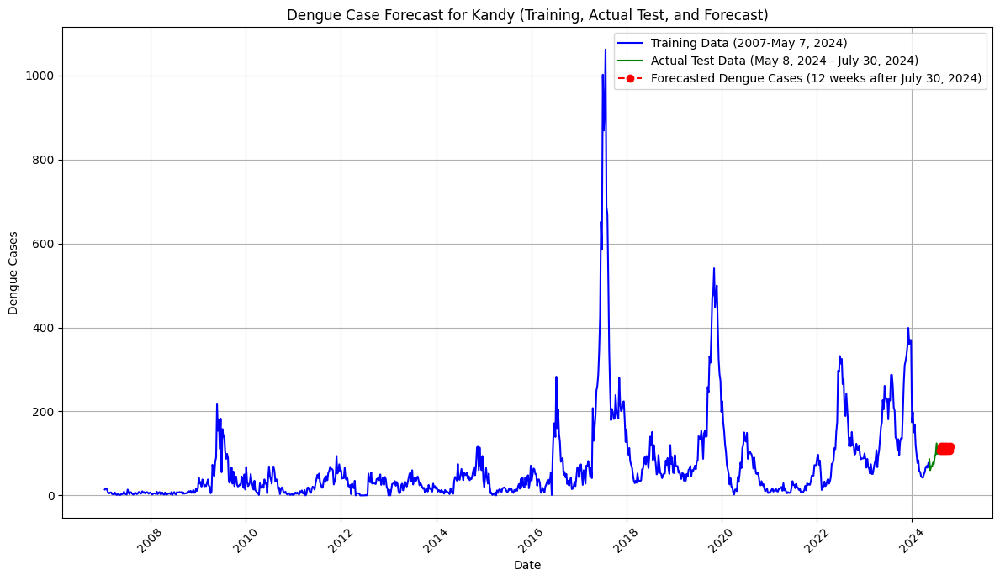

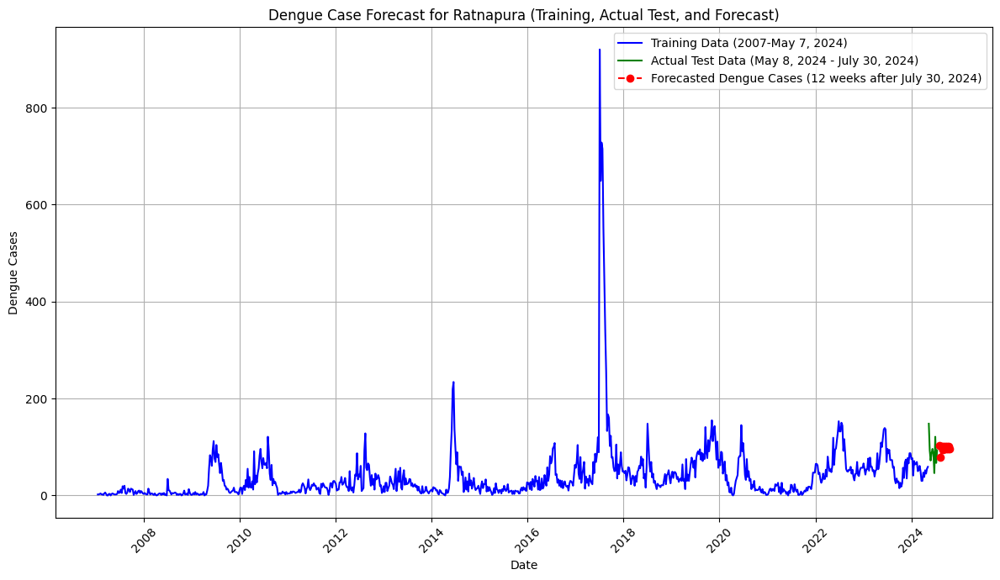

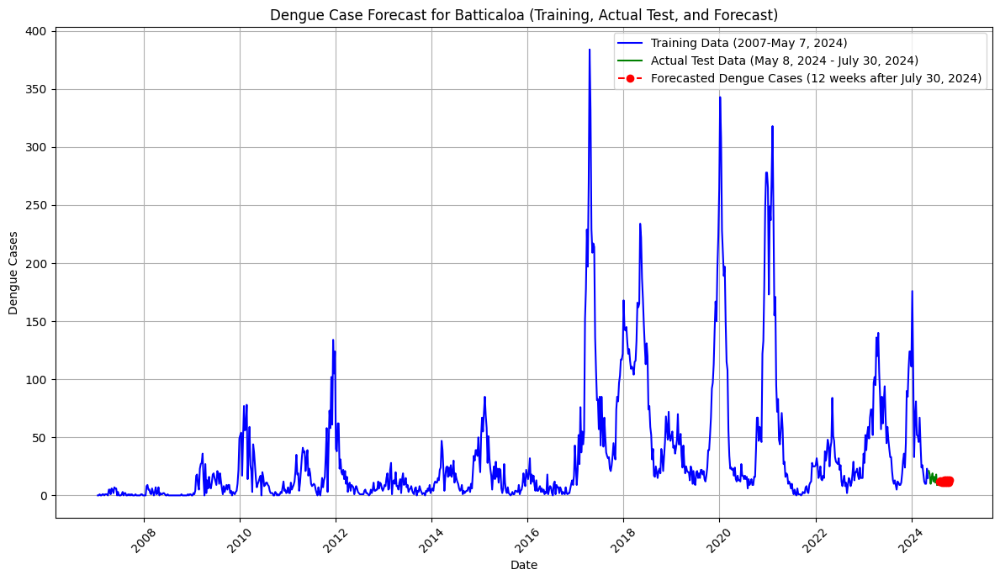

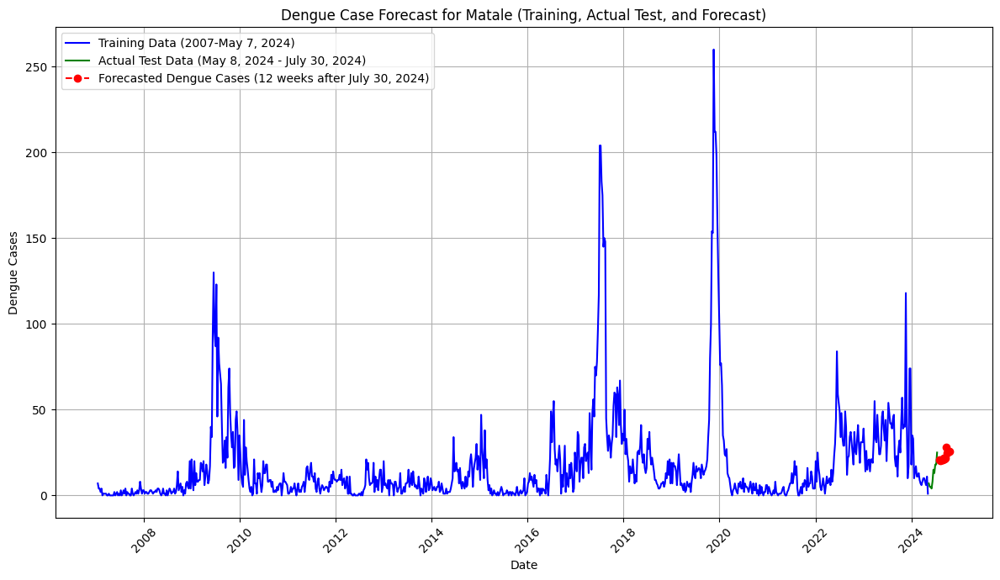

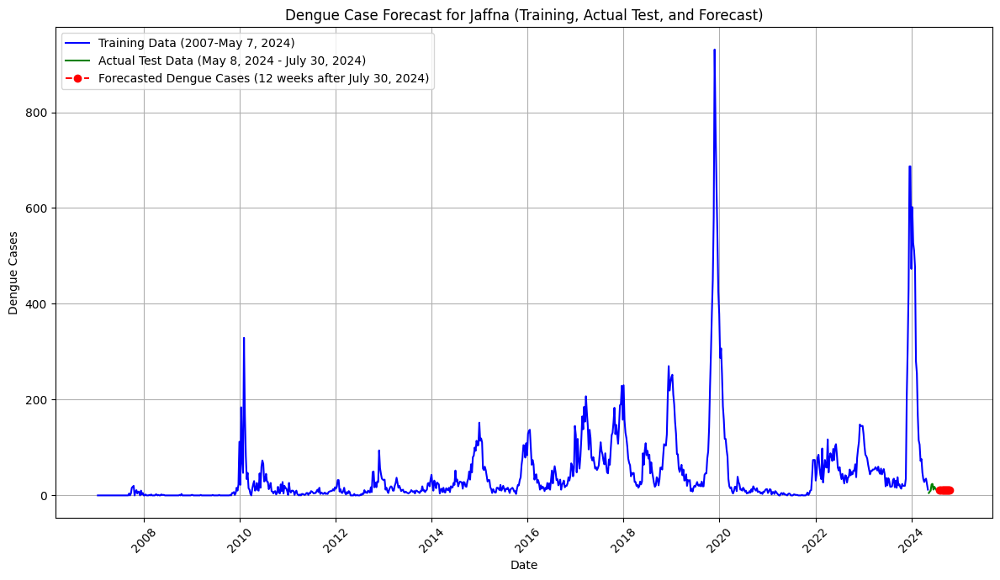


GradientBoosting RMSE per district:
Puttalam: 3.615445191515036
Galle: 7.236580656994891
Badulla: 3.7938571318722216
Vavuniya: 0.7168326064031835
Trincomalee: 2.504301230274566
Hambantota: 3.22493267477146
Kurunegala: 11.768119060974978
Ampara: 3.0403616264932714
Mullaitivu: 0.4180591353412288
Mannar: 1.6928563429318515
Colombo: 29.46553250238825
Kegalle: 4.526281640391346
Matara: 4.406576079350543
Anuradhapura: 2.9192278024671685
NuwaraEliya: 0.8674538815830712
Gampaha: 14.129505715403164
Kalutara: 8.376873026020476
Monaragala: 3.2955445483867414
Polonnaruwa: 2.029115641421138
Kilinochchi: 0.5965210560333518
Kandy: 8.692843358192844
Ratnapura: 19.74441873014018
Batticaloa: 2.7062097659126607
Matale: 3.591991541124734
Jaffna: 4.016198505556252

Mean RMSE across all districts: 5.895025578077784


In [36]:
import pandas as pd
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')

# Load the dataset
data = pd.read_csv('/kaggle/input/final-sri-lanka-dengue-cases-weather-weekly-07-24/Final Sri_lanka_dengue_cases_weather_weekly_2007_2024.csv')

# Ensure the date is in datetime format
data['Week_Start_Date'] = pd.to_datetime(data['Week_Start_Date'])

# Sort the data by date
data = data.sort_values(by='Week_Start_Date')

# EDA Section: Exploratory Data Analysis

# 1. Basic Info about Data
print("Basic Info of the dataset:\n")
print(data.info())

# 2. Statistical Summary
print("\nStatistical Summary:\n")
print(data.describe())

# 3. Pie Chart: Distribution of dengue cases across districts
district_case_counts = data.groupby('District')['Number_of_Cases'].sum().sort_values(ascending=False)
plt.figure(figsize=(10, 10))
district_case_counts.plot.pie(autopct='%1.1f%%', shadow=True, startangle=90)
plt.title('Distribution of Dengue Cases across Districts')
plt.ylabel('')
plt.tight_layout()
plt.show()

# 4. Bar Plot: Total dengue cases per district
plt.figure(figsize=(12, 6))
sns.barplot(x=district_case_counts.index, y=district_case_counts.values, palette='viridis')
plt.xticks(rotation=90)
plt.title('Total Dengue Cases per District')
plt.ylabel('Number of Cases')
plt.xlabel('District')
plt.tight_layout()
plt.show()

# 5. Line Plot: Total dengue cases over time
total_cases_over_time = data.groupby('Week_Start_Date')['Number_of_Cases'].sum()
plt.figure(figsize=(14, 6))
plt.plot(total_cases_over_time.index, total_cases_over_time.values, label='Total Dengue Cases', color='blue')
plt.title('Dengue Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Total Number of Cases')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# Feature Engineering: Adding Lag and Rolling Mean Features
data['lag_1'] = data.groupby('District')['Number_of_Cases'].shift(1)
data['rolling_mean_3'] = data.groupby('District')['Number_of_Cases'].rolling(window=3).mean().reset_index(0, drop=True)
data = data.dropna()  # Drop rows with missing values after feature engineering

# Select features and target
features = ['Avg Max Temp (°C)', 'Total Precipitation (mm)', 'lag_1', 'rolling_mean_3']
target = 'Number_of_Cases'

# Initialize dictionary to store forecasts and RMSE
forecast_results = {}
rmse_comparison = []

# Iterate through districts
for district in data['District'].unique():
    # Filter data for the current district
    district_data = data[data['District'] == district]
    
    # Ensure there are enough data points
    if len(district_data) < 532:
        print(f"Not enough data for {district}. Skipping.")
        continue

    X = district_data[features]
    y = district_data[target]

    # Split training data (2007 up to May 7, 2024)
    train_data = district_data[district_data['Week_Start_Date'] <= '2024-05-07']
    
    # Split testing data (May 8, 2024 to July 30, 2024)
    test_data = district_data[(district_data['Week_Start_Date'] > '2024-05-07') & 
                              (district_data['Week_Start_Date'] <= '2024-07-30')]
    
    # Prepare the data for 12 weeks forecasting beyond July 30, 2024
    forecast_start_date = '2024-07-30'
    forecast_end_date = pd.to_datetime(forecast_start_date) + pd.Timedelta(weeks=12)
    forecast_data = pd.DataFrame(pd.date_range(forecast_start_date, periods=12, freq='W'), columns=['Week_Start_Date'])

    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]

    # Train Gradient Boosting model
    model_gb = GradientBoostingRegressor(n_estimators=1000, learning_rate=0.01, max_depth=6)
    model_gb.fit(X_train, y_train)
    
    # Test period forecast (May 8, 2024 to July 30, 2024)
    y_pred_gb = model_gb.predict(X_test)
    rmse_gb = np.sqrt(mean_squared_error(y_test, y_pred_gb))
    rmse_comparison.append((district, rmse_gb))

    # Keep actual test data (May 8, 2024, to July 30, 2024)
    forecast_actual_data = pd.DataFrame({
        'Week_Start_Date': test_data['Week_Start_Date'],
        'Actual_Dengue_Cases': test_data[target].values
    })

    # Forecast 12 weeks ahead from July 30, 2024
    X_forecast = X_test.iloc[-1].values.reshape(1, -1)  # Use the last row from the test data for initial forecast
    future_forecasts = []

    for _ in range(12):
        y_forecast = model_gb.predict(X_forecast)[0]
        future_forecasts.append(y_forecast)
        
        # Update lag and rolling mean for the next prediction
        lag_1 = y_forecast
        rolling_mean_3 = np.mean([lag_1, X_forecast[0, 2], X_forecast[0, 3]])  # Update rolling mean with last 3 values
        avg_max_temp = X_forecast[0, 0]  # Keep weather features the same (or update if available)
        total_precipitation = X_forecast[0, 1]
        
        # Prepare the new row with updated features for next forecast
        X_forecast = np.array([avg_max_temp, total_precipitation, lag_1, rolling_mean_3]).reshape(1, -1)

    forecast_12_weeks = pd.DataFrame({
        'Week_Start_Date': forecast_data['Week_Start_Date'],
        'Forecasted_Dengue_Cases': future_forecasts
    })

    # Store forecast results
    forecast_results[district] = {
        'test_period': forecast_actual_data,
        'future_forecast': forecast_12_weeks
    }

    # Plot training, test, and forecast results for this district
    plt.figure(figsize=(12, 7))
    
    # Plot training data
    plt.plot(train_data['Week_Start_Date'], train_data[target], label='Training Data (2007-May 7, 2024)', color='blue')

    # Plot test data (actual)
    plt.plot(forecast_actual_data['Week_Start_Date'], forecast_actual_data['Actual_Dengue_Cases'], label='Actual Test Data (May 8, 2024 - July 30, 2024)', color='green')

    # Plot forecast data for 12 weeks ahead
    plt.plot(forecast_12_weeks['Week_Start_Date'], forecast_12_weeks['Forecasted_Dengue_Cases'], 
             label='Forecasted Dengue Cases (12 weeks after July 30, 2024)', linestyle='--', color='red', marker='o')
    
    # Formatting the graph
    plt.xlabel('Date')
    plt.ylabel('Dengue Cases')
    plt.title(f'Dengue Case Forecast for {district} (Training, Actual Test, and Forecast)')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()

# Calculate mean RMSE across all districts
mean_rmse = np.mean([rmse for _, rmse in rmse_comparison])

# Print RMSE results for each district
print("\nGradientBoosting RMSE per district:")
for district, rmse in rmse_comparison:
    print(f"{district}: {rmse}")
print(f"\nMean RMSE across all districts: {mean_rmse}")

Training Data

Time Period: From 2007 to May 7, 2024.

The training data consists of all available historical data from each district up to May 7, 2024.

This period is used to train the Gradient Boosting Regressor model, using the lag features (lag_1), rolling mean (rolling_mean_3), and weather data (Avg Max Temp (°C) and Total Precipitation (mm)).

Test Data:

Time Period: From May 7, 2024, to July 30, 2024.

This period is used to evaluate the model's predictions on unseen data (test the model's performance).

The Root Mean Squared Error (RMSE) is calculated by comparing the actual dengue cases during this period with the model's predictions.

Future Forecasting:

Time Period: From July 31, 2024, to 12 weeks into the future.

After evaluating the model on the test set, the model is used to forecast the number of dengue cases for the next 12 weeks, from July 31, 2024, onward.

For each of the 12 future weeks, features such as lag, rolling mean, and weather variables are updated dynamically based on the model’s predictions and seasonal averages.

Conlusion Note

Training Period: 2007 to May 7, 2024 (includes the past 17 years of weekly data).

Test Period: May 7, 2024, to July 30, 2024 (12 weeks).

Future Forecasting: July 31, 2024, to 12 weeks into the future

Lag Feature (lag_1)

This feature represents the number of dengue cases in the previous week ( a one-week lag). For future weeks, once the model makes a prediction for the current week, that predicted value is used as the lag_1 value for the next week.

Example: If the model predicts 50 cases for the first future week, that predicted value (50) will be used as the lag_1 feature for predicting the second future week.

Rolling Mean (rolling_mean_3)

This feature is a 3-week rolling average of dengue cases. For future weeks, once the model makes a prediction, the rolling average is updated using the predicted cases from the most recent weeks. Example: If the model predicts 50 cases for week 1, 60 cases for week 2, and 55 cases for week 3, the rolling_mean_3 for week 4 will be the average of these three predictions: (50 + 60 + 55) / 3.

# Hyperparameter Tuning

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Ampara: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}


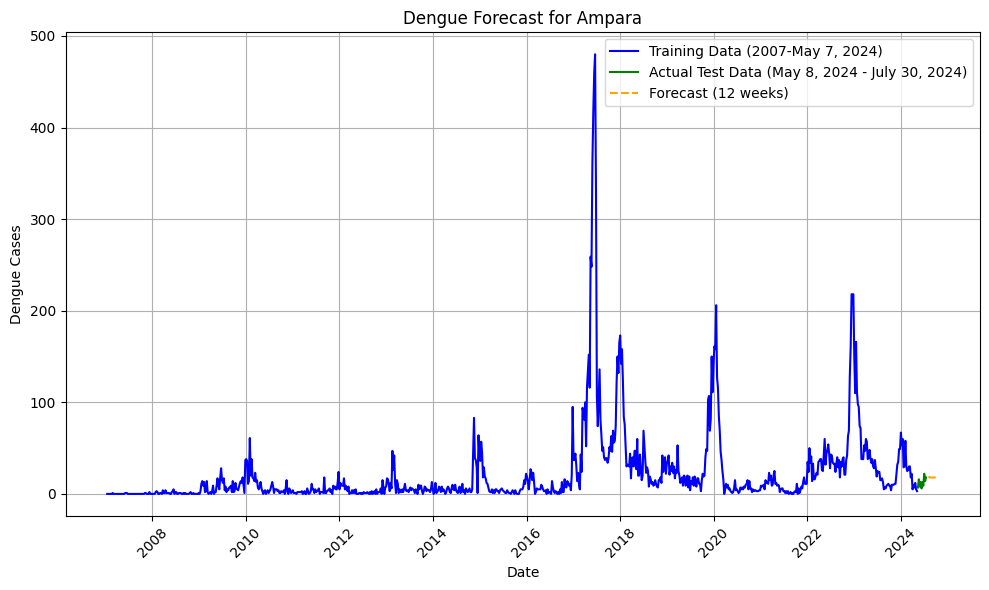

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Vavuniya: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}


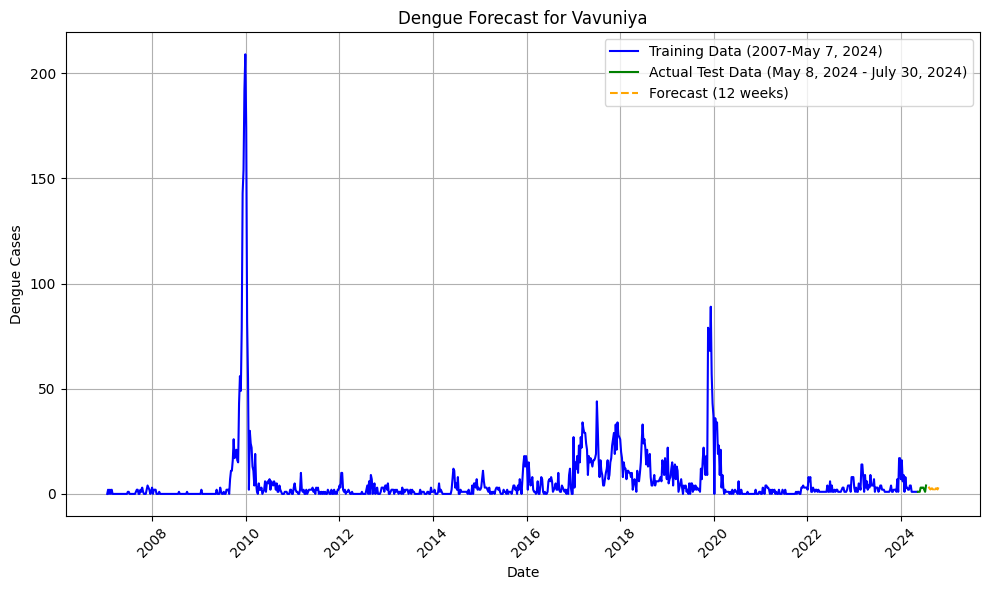

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200

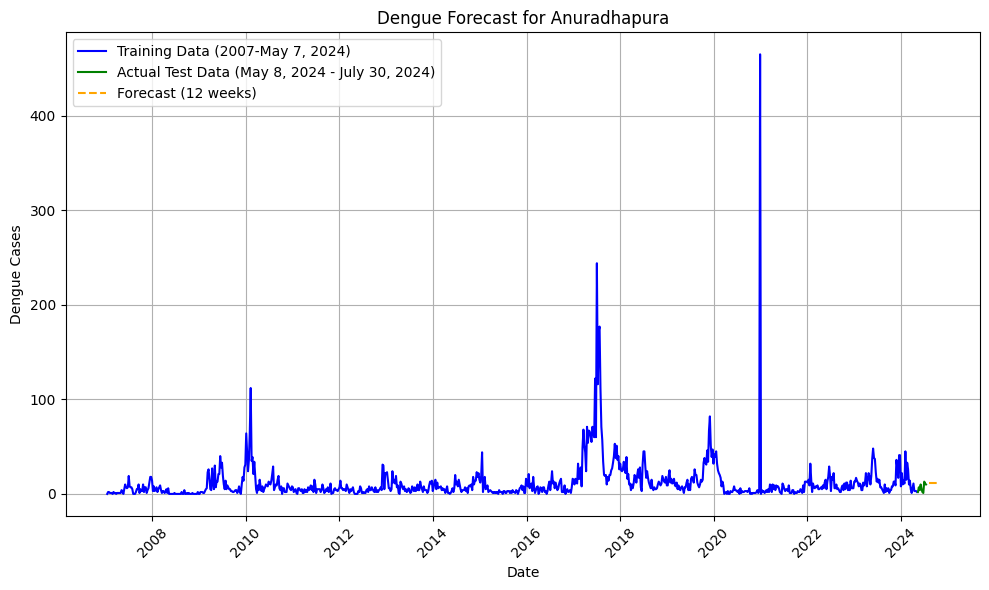

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100

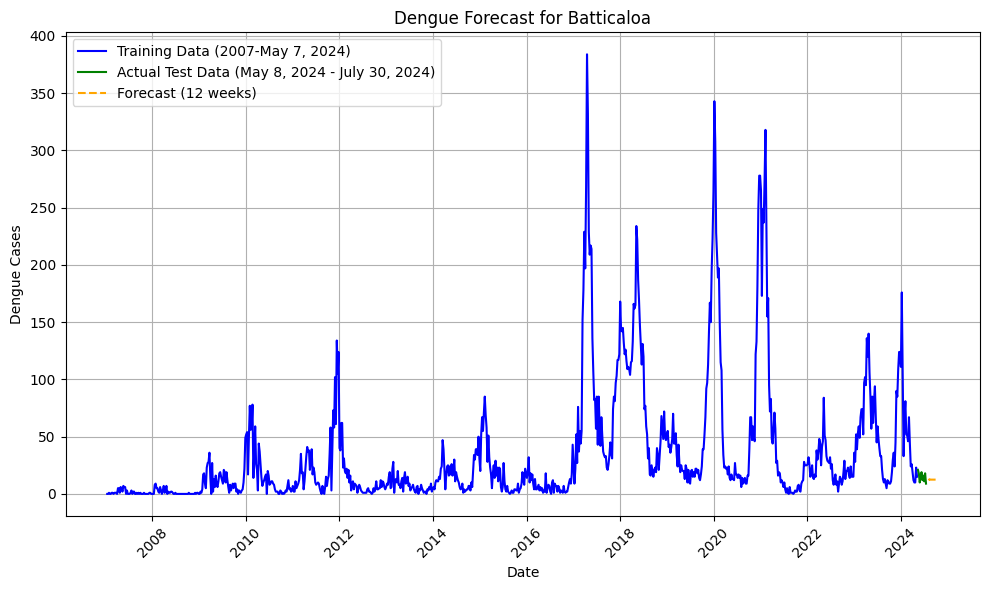

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Ratnapura: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}


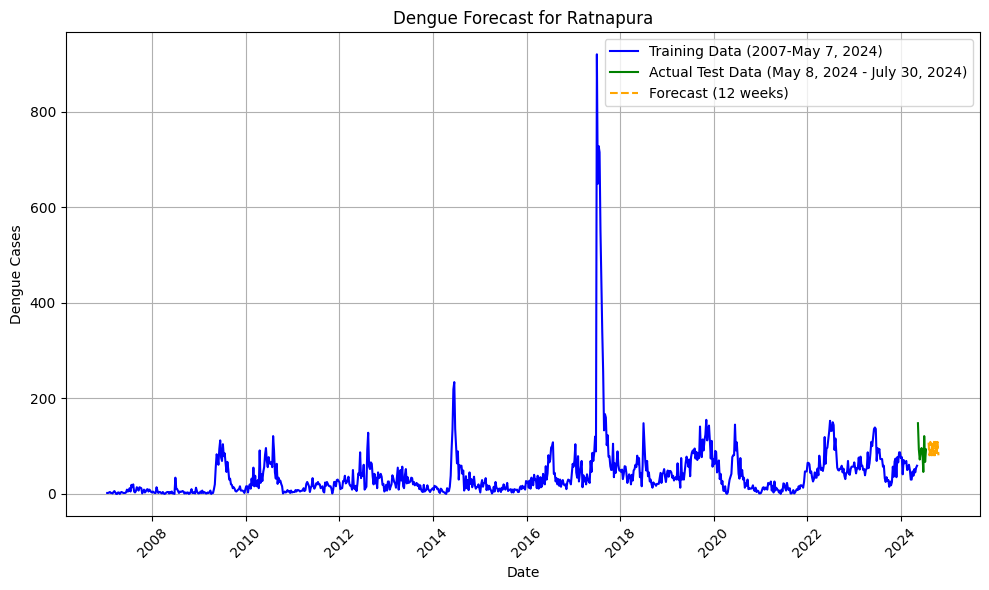

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total 

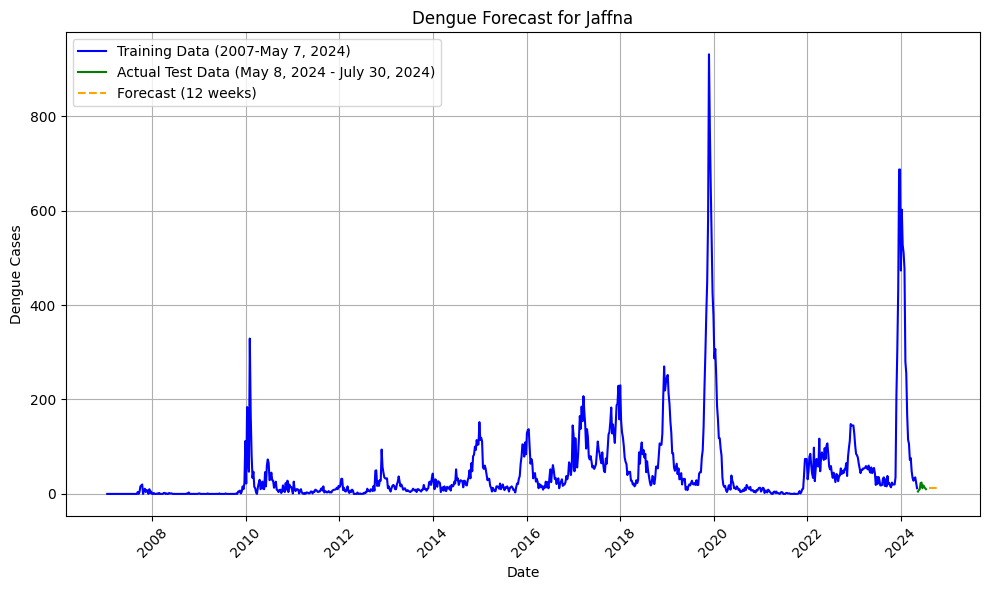

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Monaragala: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


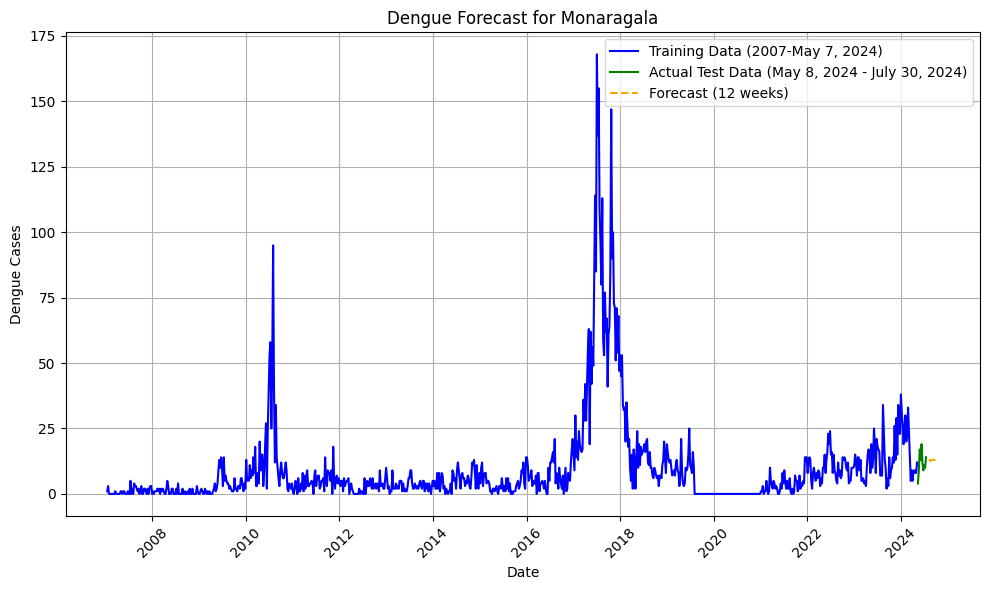

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Matale: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 100}


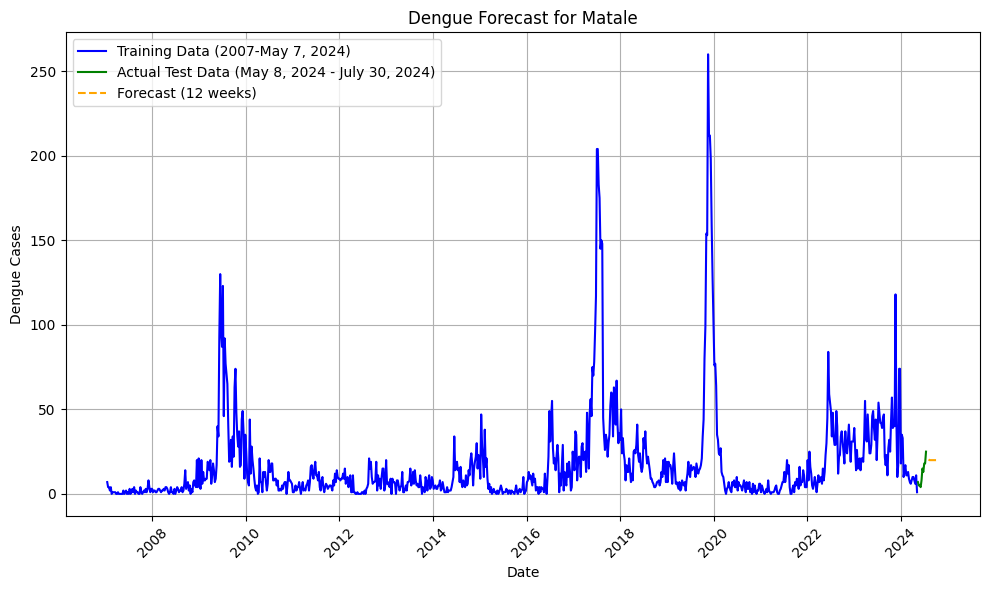

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; 

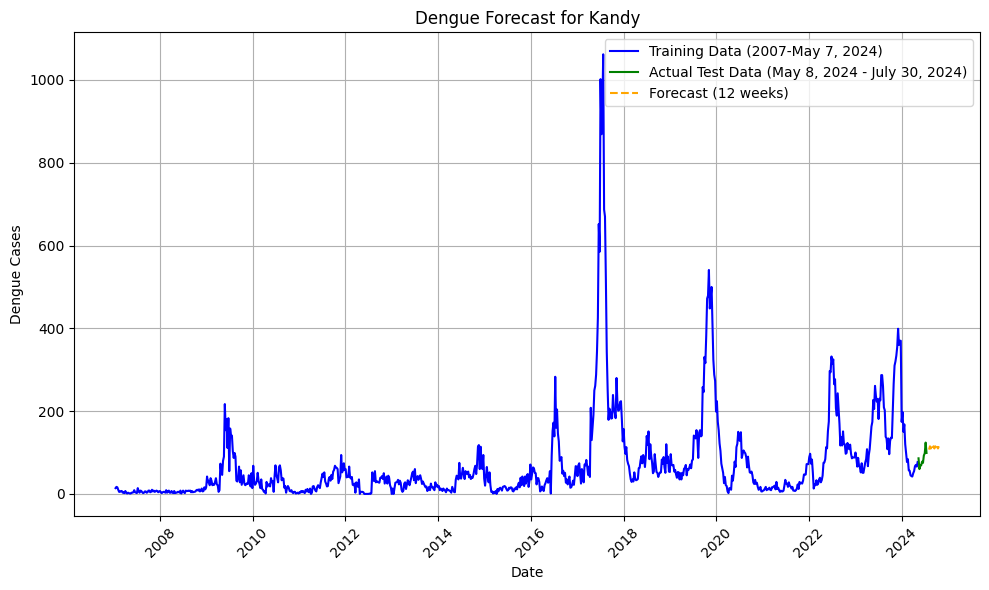

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Polonnaruwa: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}


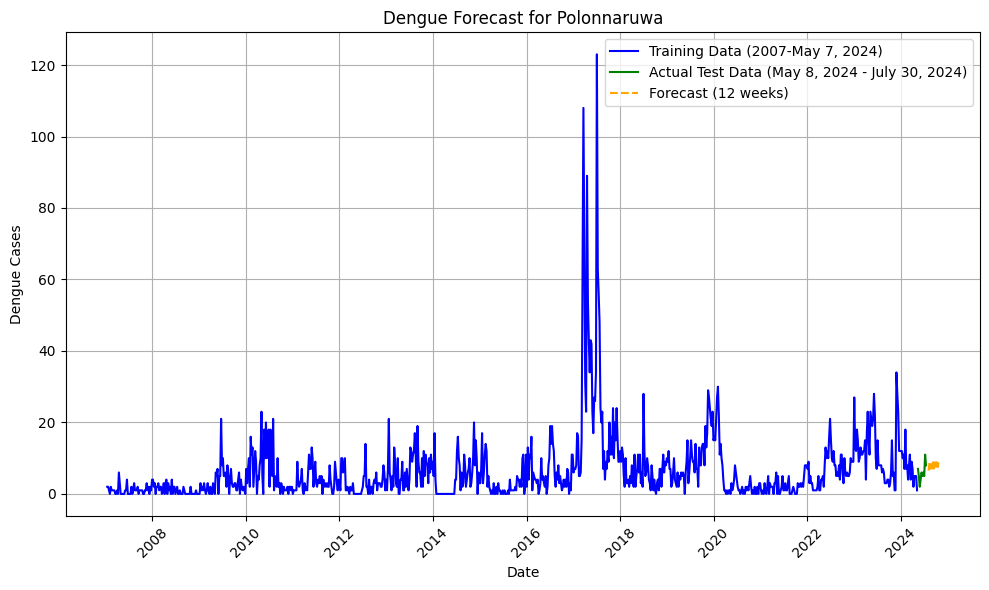

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100

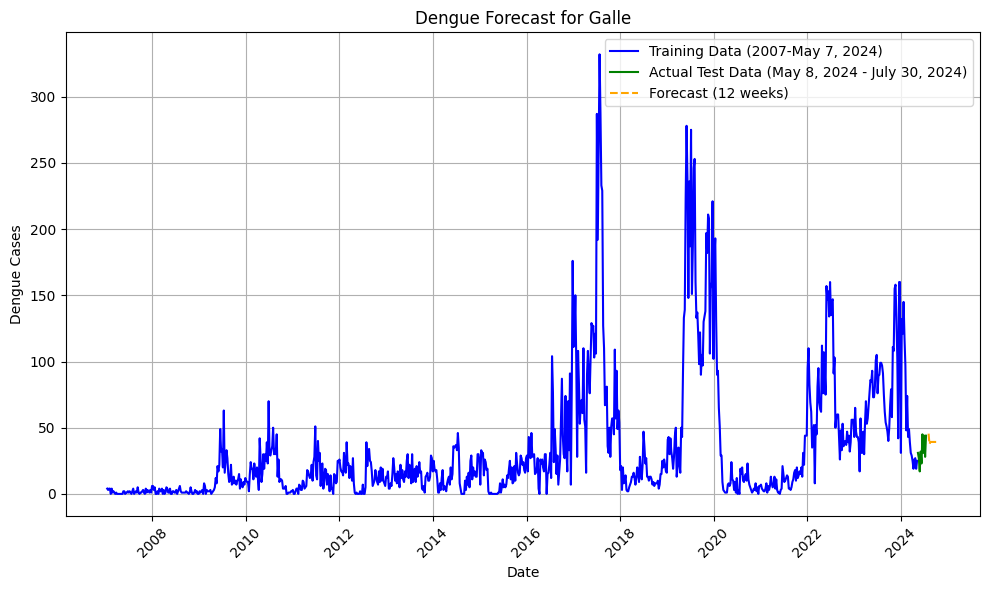

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total 

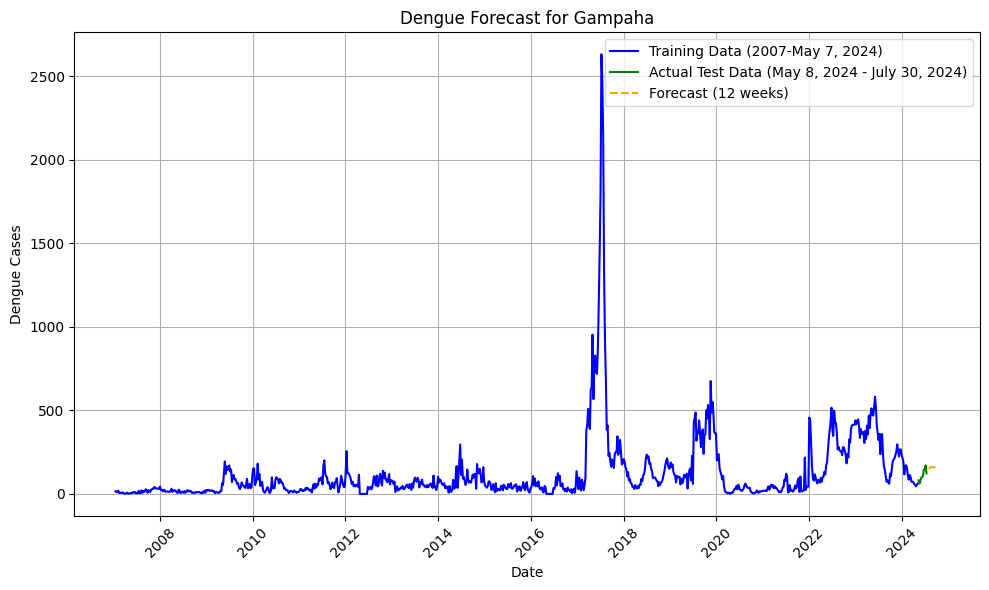

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for NuwaraEliya: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}


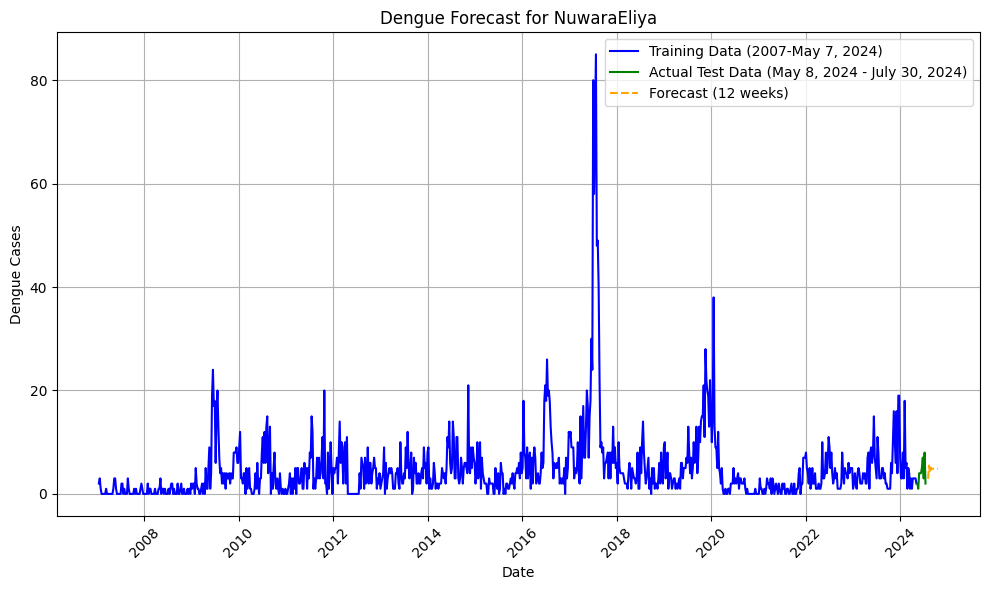

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200

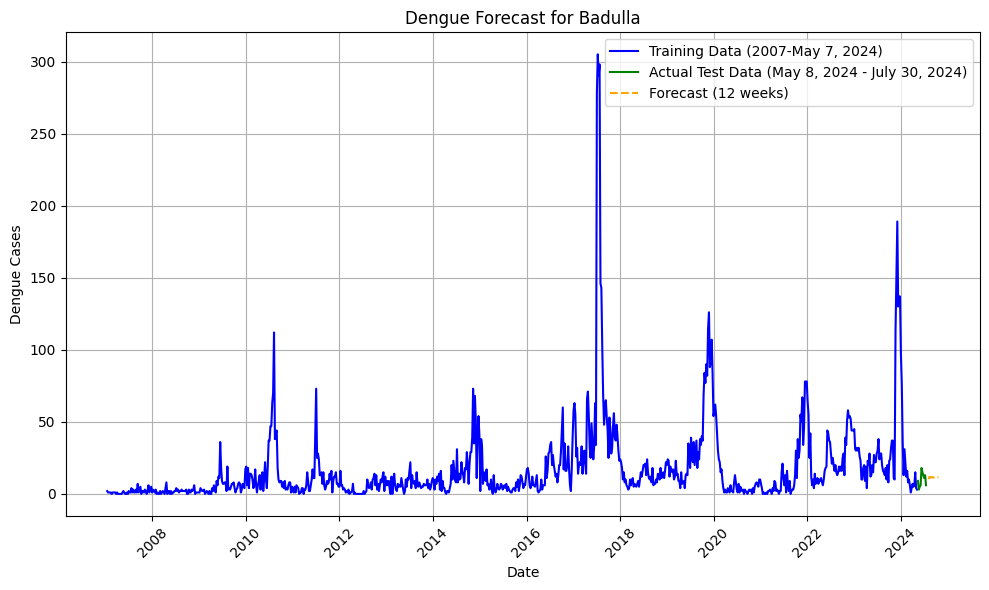

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total 

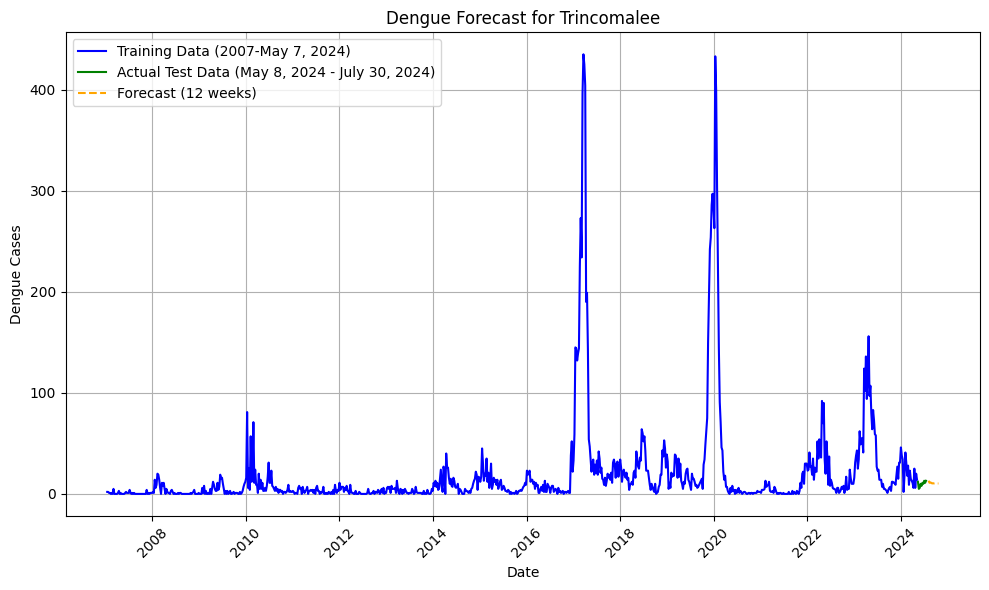

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Hambantota: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


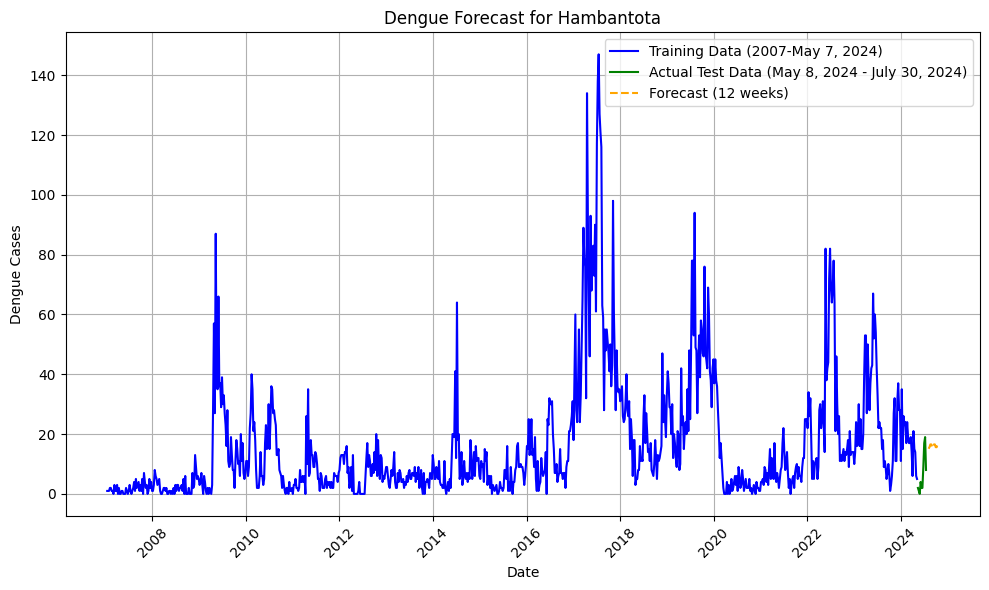

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; t

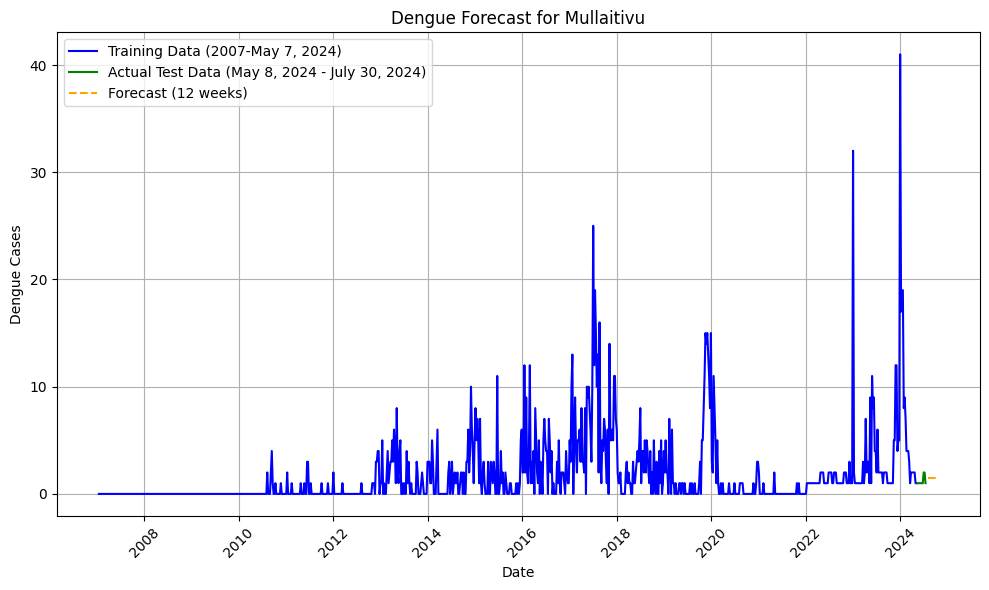

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.8s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.7s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; 

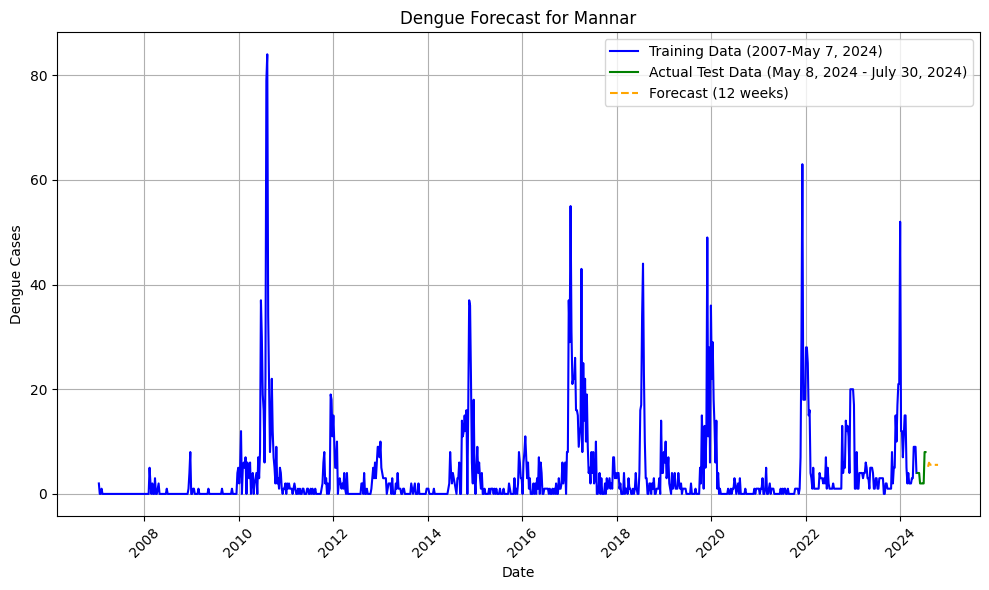

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Kurunegala: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}


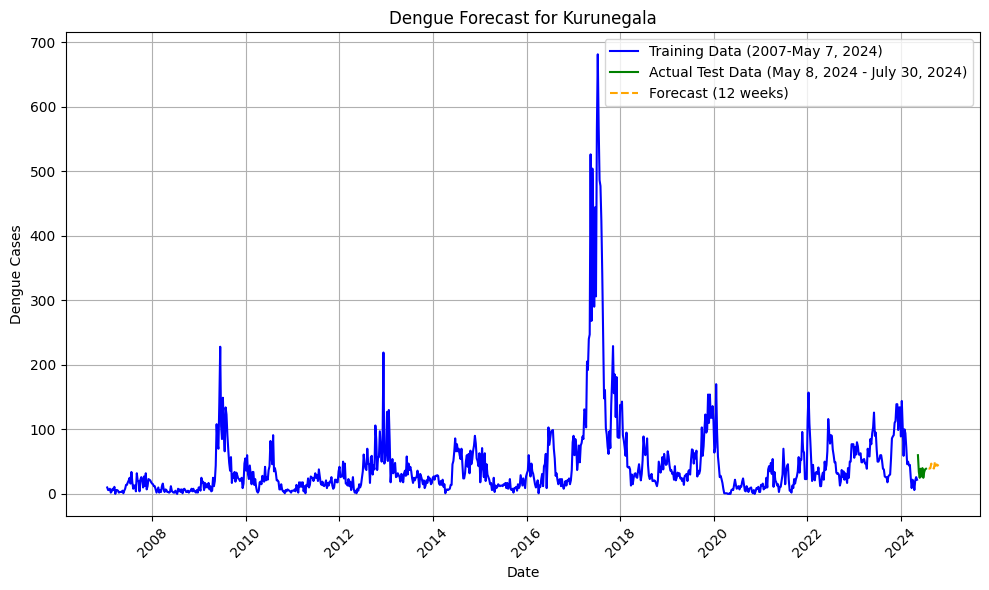

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total 

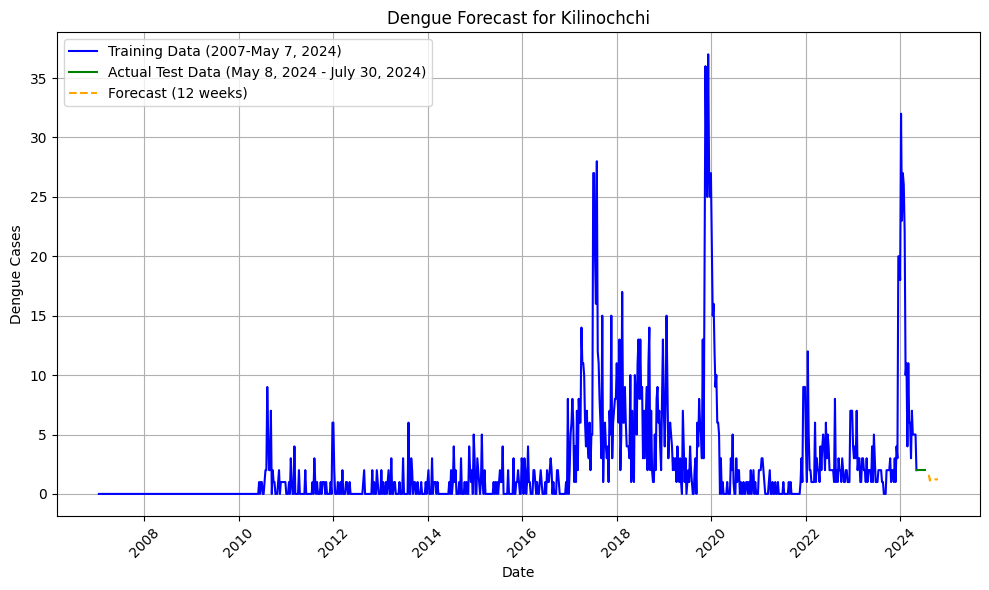

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200

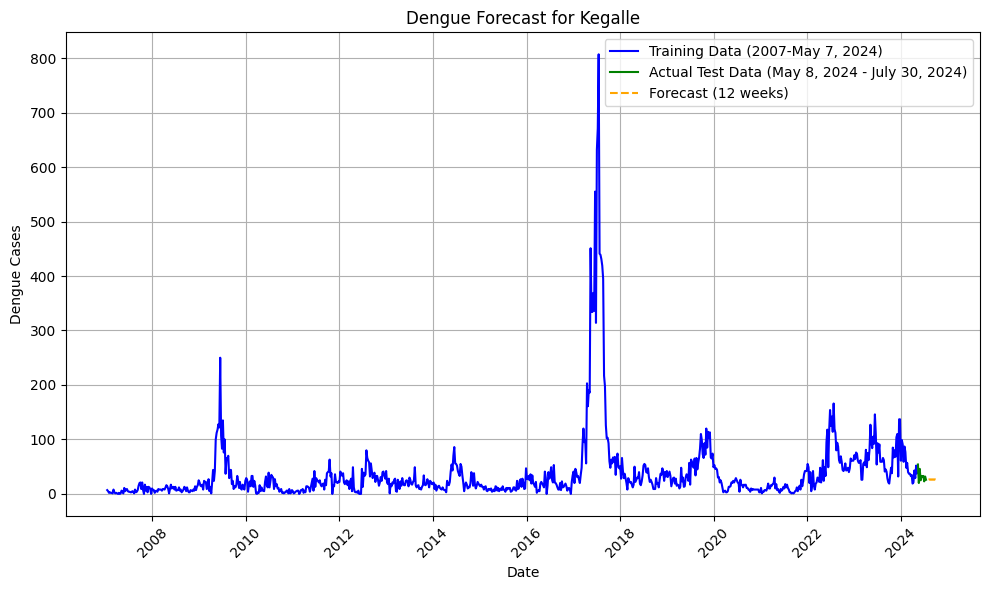

Fitting 3 folds for each of 32 candidates, totalling 96 fits

Best parameters for Colombo: {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


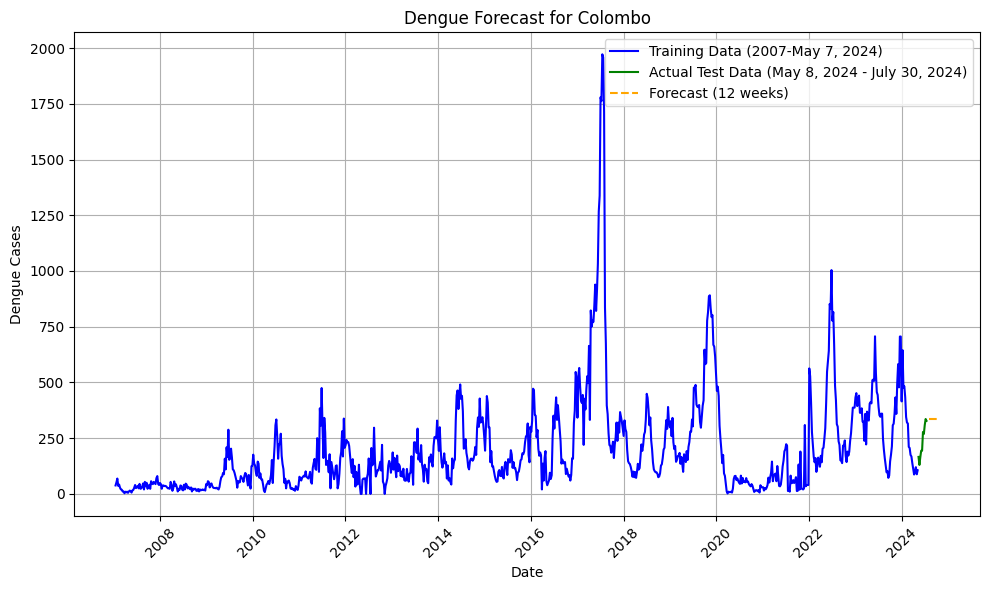

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100; t

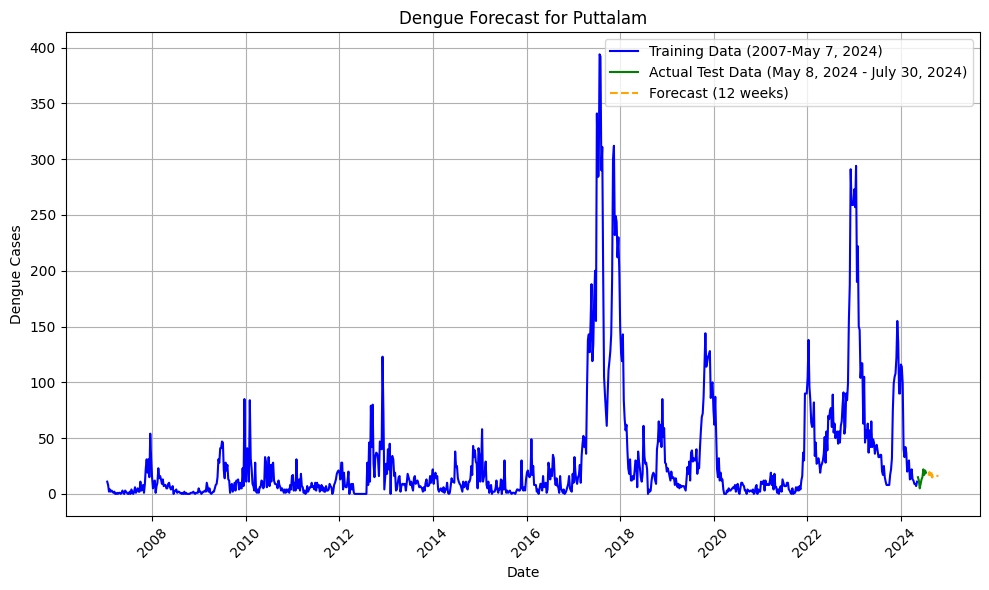

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; 

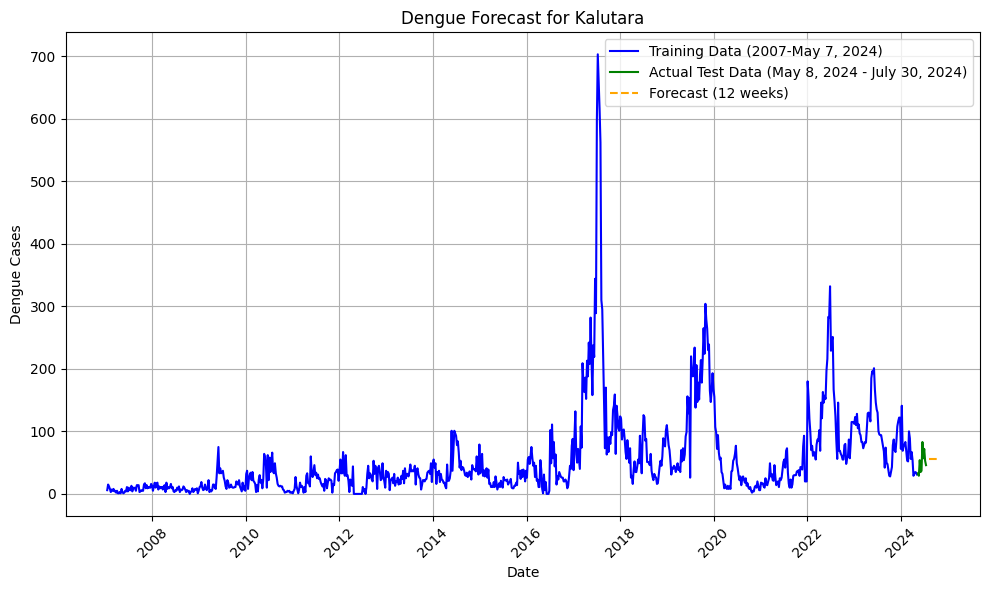

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100;

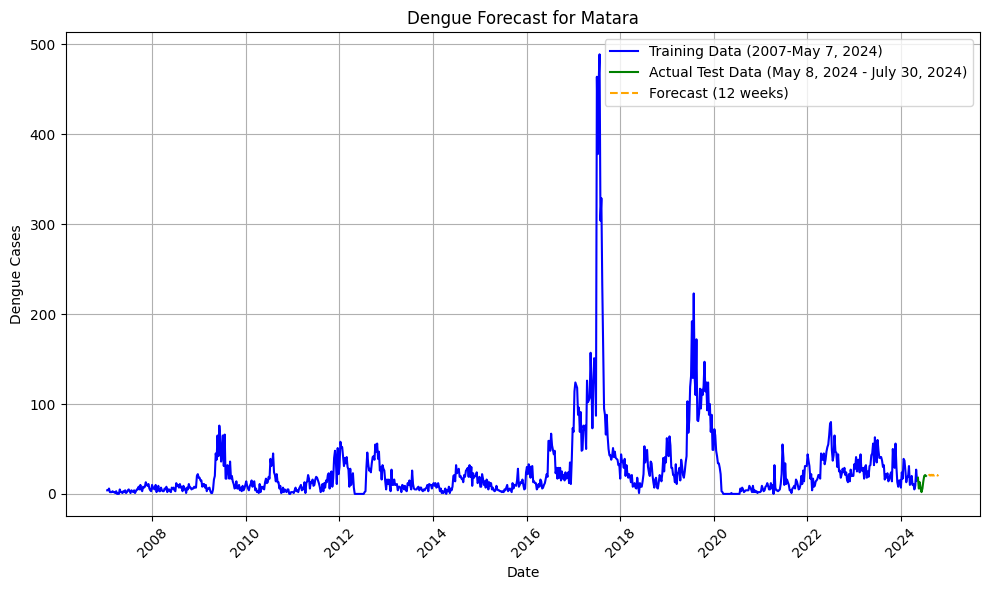


GradientBoosting RMSE per district:
Ampara: 3.303769883888679
Vavuniya: 0.6078863840119423
Anuradhapura: 3.1635121465698637
Batticaloa: 2.971014137269408
Ratnapura: 21.034610665413602
Jaffna: 4.712916230990024
Monaragala: 3.0027705532936477
Matale: 2.7680560746637988
Kandy: 8.273050595406392
Polonnaruwa: 1.7207569767706943
Galle: 5.657272898444541
Gampaha: 17.20583248995631
NuwaraEliya: 0.8555164987611796
Badulla: 3.5660578752223207
Trincomalee: 2.4464554828746565
Hambantota: 4.057003042504154
Mullaitivu: 0.294282308649648
Mannar: 1.5878105681746575
Kurunegala: 11.688073298641307
Kilinochchi: 0.49936820825288636
Kegalle: 4.5520035173292746
Colombo: 23.643902288891187
Puttalam: 3.476438205965722
Kalutara: 9.366433913133426
Matara: 3.9519475417761964

Mean RMSE across all districts: 5.776269671474221
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=1, min_sam

In [37]:
import pandas as pd
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
import numpy as np
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings('ignore')

# Load the dataset
data = pd.read_csv('/kaggle/input/final-sri-lanka-dengue-cases-weather-weekly-07-24/Final Sri_lanka_dengue_cases_weather_weekly_2007_2024.csv')

# Ensure the date is in datetime format
data['Week_Start_Date'] = pd.to_datetime(data['Week_Start_Date'])

# Sort the data by date
data = data.sort_values(by='Week_Start_Date')

# Select features and target
features = ['Avg Max Temp (°C)', 'Total Precipitation (mm)']
target = 'Number_of_Cases'

# Initialize dictionary to store forecasts and RMSE
forecast_results = {}
rmse_comparison = []

# Iterate through districts
for district in data['District'].unique():
    # Filter data for the current district
    district_data = data[data['District'] == district]
    
    # Ensure there are enough data points
    if len(district_data) < 532:
        print(f"Not enough data for {district}. Skipping.")
        continue

    # Prepare features and target variables
    district_data['lag_1'] = district_data[target].shift(1)
    district_data['rolling_mean_3'] = district_data[target].rolling(window=3).mean()
    district_data = district_data.dropna()

    X = district_data[['lag_1', 'rolling_mean_3'] + features]
    y = district_data[target]

    # Split training data (up to May 7, 2024) and testing data (May 8, 2024 to July 30, 2024)
    train_data = district_data[district_data['Week_Start_Date'] <= '2024-05-07']
    test_data = district_data[(district_data['Week_Start_Date'] > '2024-05-07') & 
                              (district_data['Week_Start_Date'] <= '2024-07-30')]

    X_train = train_data[['lag_1', 'rolling_mean_3'] + features]
    y_train = train_data[target]
    X_test = test_data[['lag_1', 'rolling_mean_3'] + features]
    y_test = test_data[target]

    # Define the hyperparameter grid
    param_grid = {
        'n_estimators': [100, 200],
        'learning_rate': [0.01, 0.1],
        'max_depth': [3, 5],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    }

    # Initialize Gradient Boosting Regressor
    model_gb = GradientBoostingRegressor()

    # Initialize GridSearchCV
    grid_search = GridSearchCV(estimator=model_gb, param_grid=param_grid, 
                               scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=2)

    # Fit GridSearchCV
    grid_search.fit(X_train, y_train)

    # Retrieve the best parameters and model
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    
    print(f"\nBest parameters for {district}: {best_params}")

    # Test period forecast (May 8, 2024 to July 30, 2024)
    y_pred_gb = best_model.predict(X_test)
    rmse_gb = np.sqrt(mean_squared_error(y_test, y_pred_gb))
    rmse_comparison.append((district, rmse_gb))

    # Keep actual data from May 8, 2024, to July 30, 2024
    forecast_actual_data = pd.DataFrame({
        'Week_Start_Date': test_data['Week_Start_Date'],
        'Actual_Dengue_Cases': test_data[target].values
    })

    # Forecast 12 weeks ahead from July 30, 2024
    last_row = test_data.iloc[-1]
    X_forecast = last_row[['lag_1', 'rolling_mean_3'] + features].values.reshape(1, -1)
    future_forecasts = []

    for _ in range(12):
        y_forecast = best_model.predict(X_forecast)[0]
        future_forecasts.append(y_forecast)
        
        # Update lag and rolling mean for the next prediction
        lag_1 = y_forecast
        rolling_mean_3 = np.mean([lag_1, X_forecast[0, 0], X_forecast[0, 1]])  # Update rolling mean with last 3 values
        avg_max_temp = X_forecast[0, 2]  # Keep weather features the same
        total_precipitation = X_forecast[0, 3]
        
        # Prepare the new row with updated features for next forecast
        X_forecast = np.array([lag_1, rolling_mean_3, avg_max_temp, total_precipitation]).reshape(1, -1)

    # Store forecast results
    forecast_data = pd.DataFrame({
        'Week_Start_Date': pd.date_range('2024-07-31', periods=12, freq='W'),
        'Forecasted_Dengue_Cases': future_forecasts
    })
    forecast_results[district] = {
        'test_period': forecast_actual_data,
        'future_forecast': forecast_data
    }

    # Plot training, test, and forecast results for this district
    plt.figure(figsize=(10, 6))
    plt.plot(train_data['Week_Start_Date'], train_data[target], label='Training Data (2007-May 7, 2024)', color='blue')
    plt.plot(test_data['Week_Start_Date'], test_data[target], label='Actual Test Data (May 8, 2024 - July 30, 2024)', color='green')
    plt.plot(forecast_data['Week_Start_Date'], forecast_data['Forecasted_Dengue_Cases'], 
             label='Forecast (12 weeks)', linestyle='--', color='orange')
    
    # Formatting the graph
    plt.xlabel('Date')
    plt.ylabel('Dengue Cases')
    plt.title(f'Dengue Forecast for {district}')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()

# Calculate mean RMSE across all districts
mean_rmse = np.mean([rmse for _, rmse in rmse_comparison])

# Print RMSE results for each district
print("\nGradientBoosting RMSE per district:")
for district, rmse in rmse_comparison:
    print(f"{district}: {rmse}")
print(f"\nMean RMSE across all districts: {mean_rmse}")

Training Data:

Period: From the start of the dataset up to May 7, 2024.

Test Data:

Period: From May 8, 2024, to July 30, 2024.

Forecast Period:

Period: From July 31, 2024, to September 25, 2024 (12 weeks).

Description: This is the future period for which the model generates forecasts. The forecasts are made 12 weeks ahead from the end of the test period.

Summary of Data Periods:

Training Period: Up to May 7, 2024

Test Period: May 8, 2024 to July 30, 2024

Forecast Period: July 31, 2024 to September 25, 2024

# Comparison between GB, CatBoost, XGBoost, LGBoost, Random Forest


Evaluating GradientBoosting for district Puttalam...


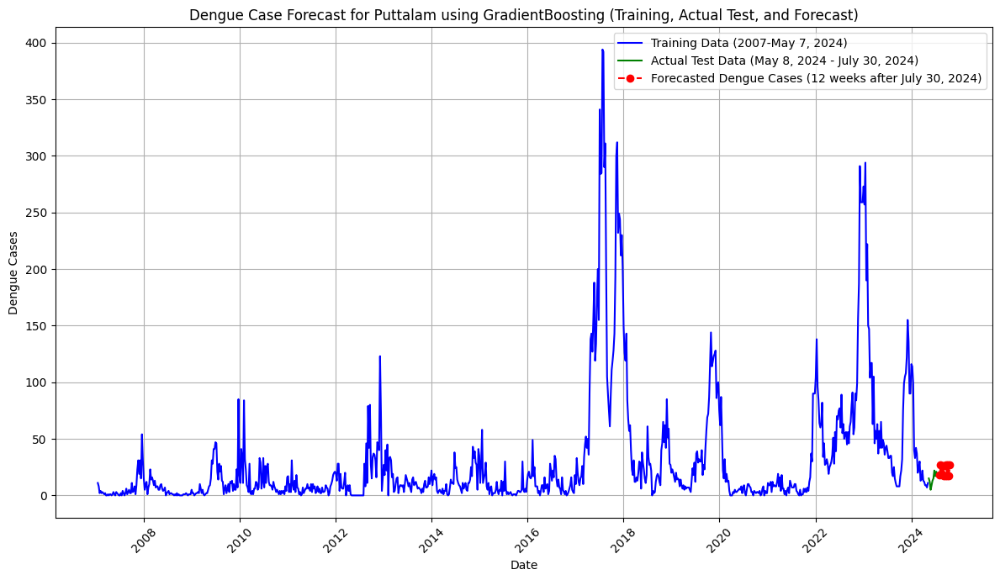


Evaluating XGBoost for district Puttalam...


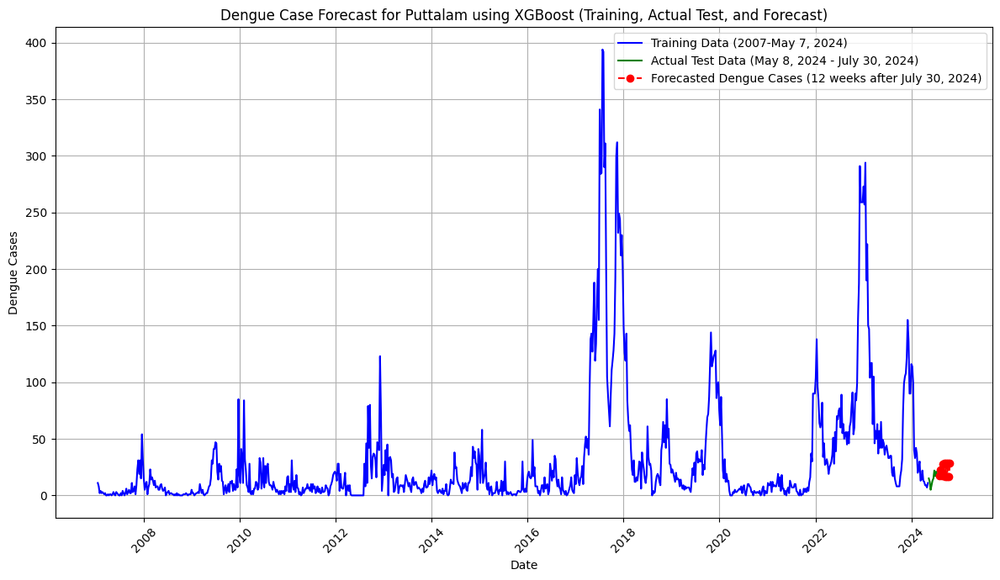


Evaluating LightGBM for district Puttalam...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 831
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 30.491150
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

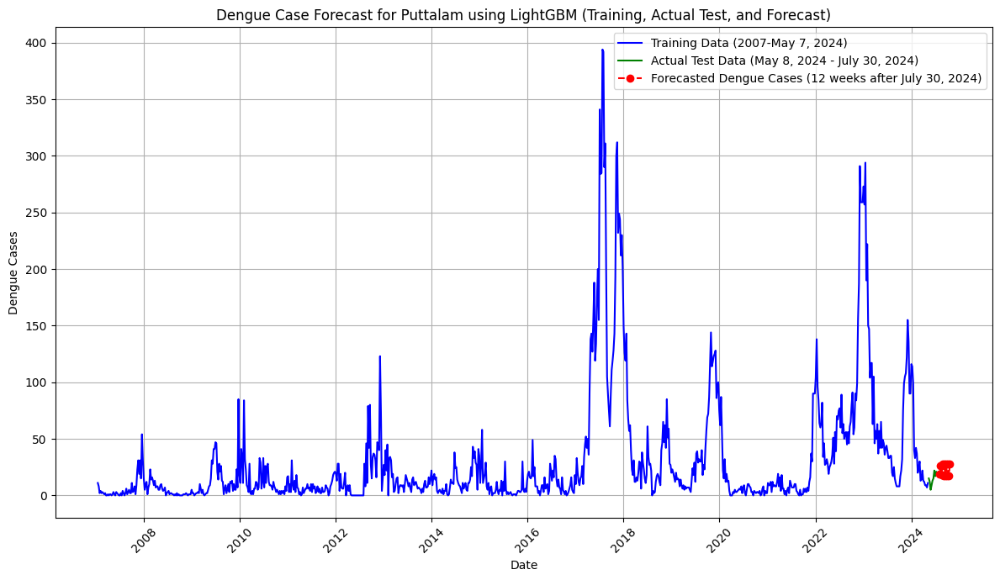


Evaluating CatBoost for district Puttalam...


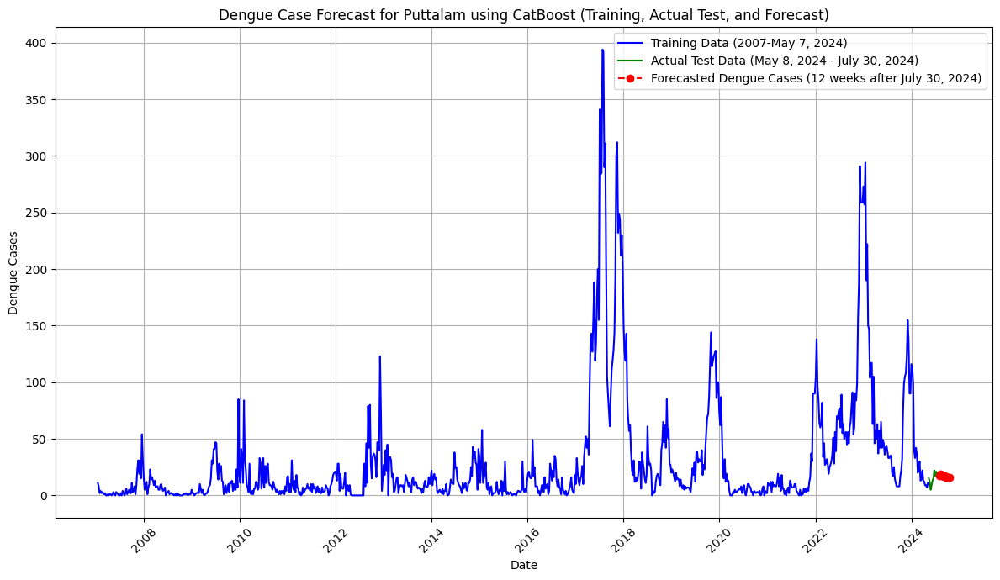


Evaluating RandomForest for district Puttalam...


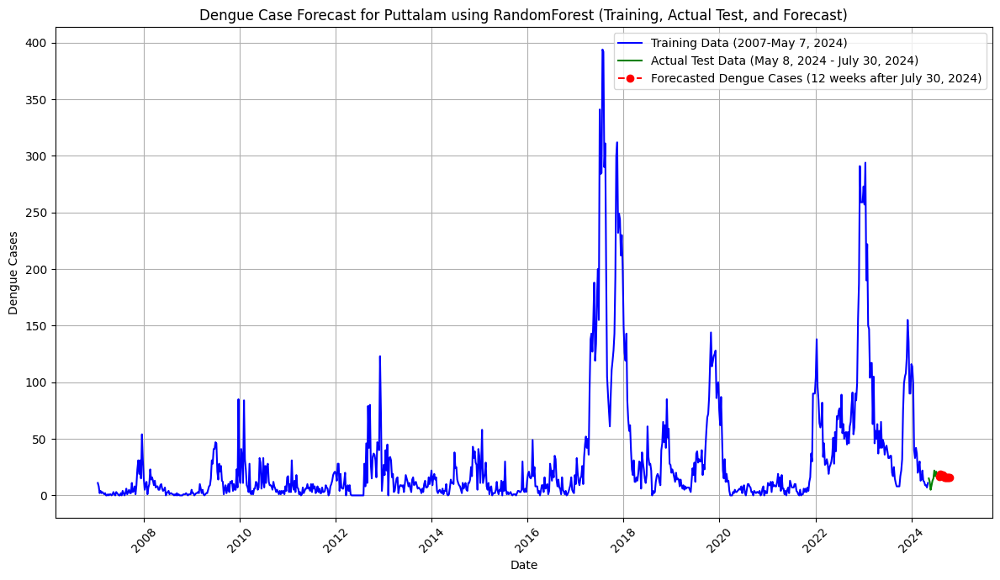


Evaluating GradientBoosting for district Galle...


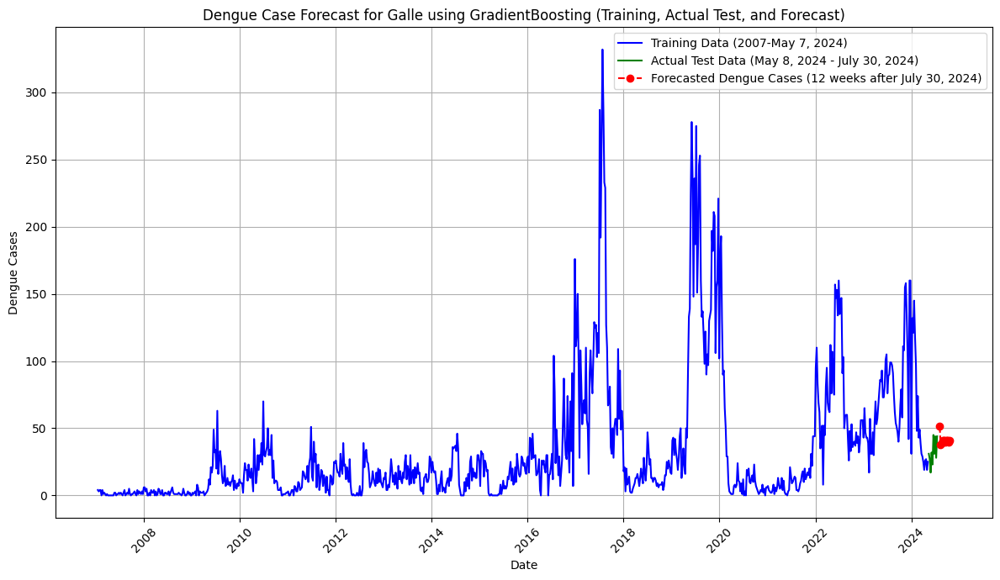


Evaluating XGBoost for district Galle...


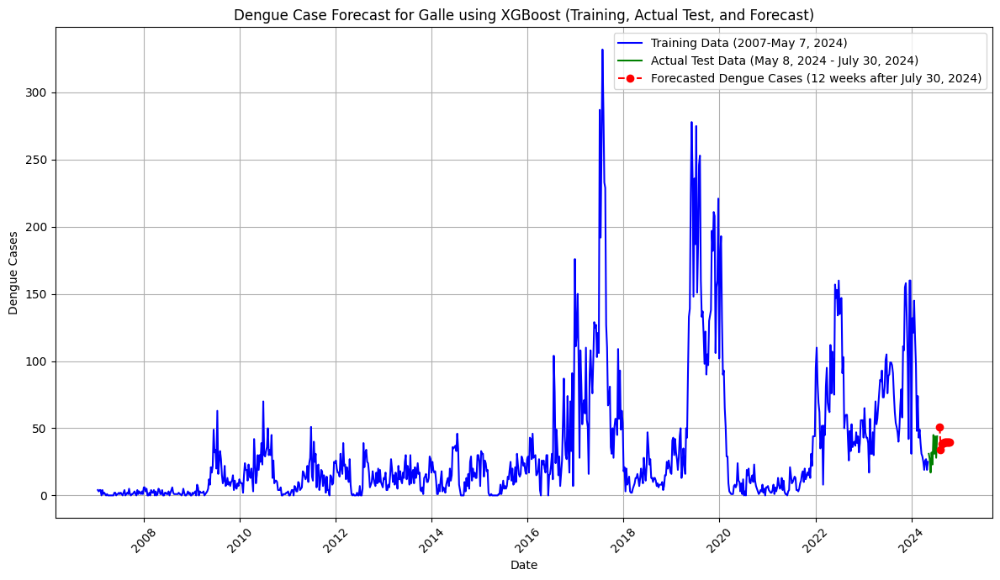


Evaluating LightGBM for district Galle...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 847
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 33.506637
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

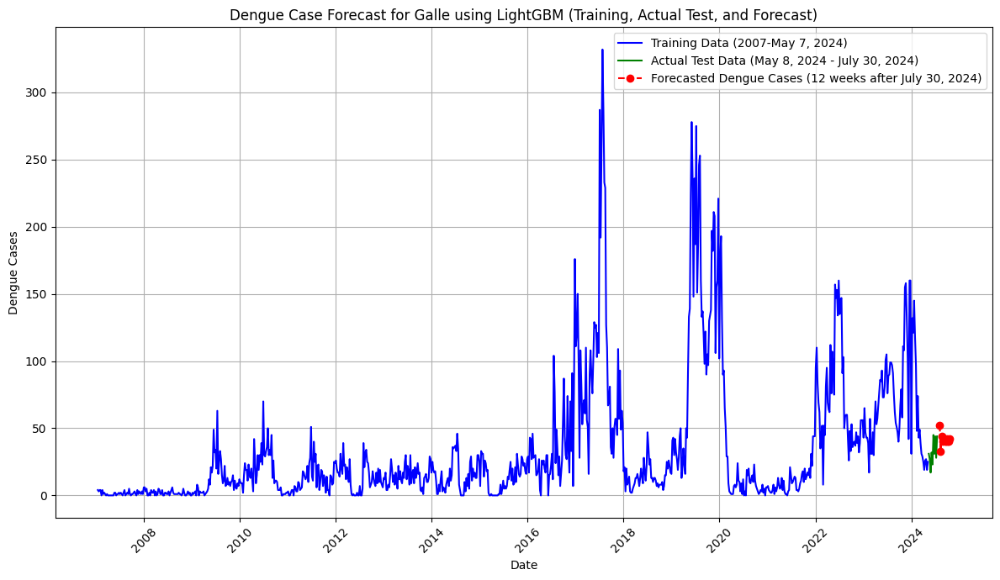


Evaluating CatBoost for district Galle...


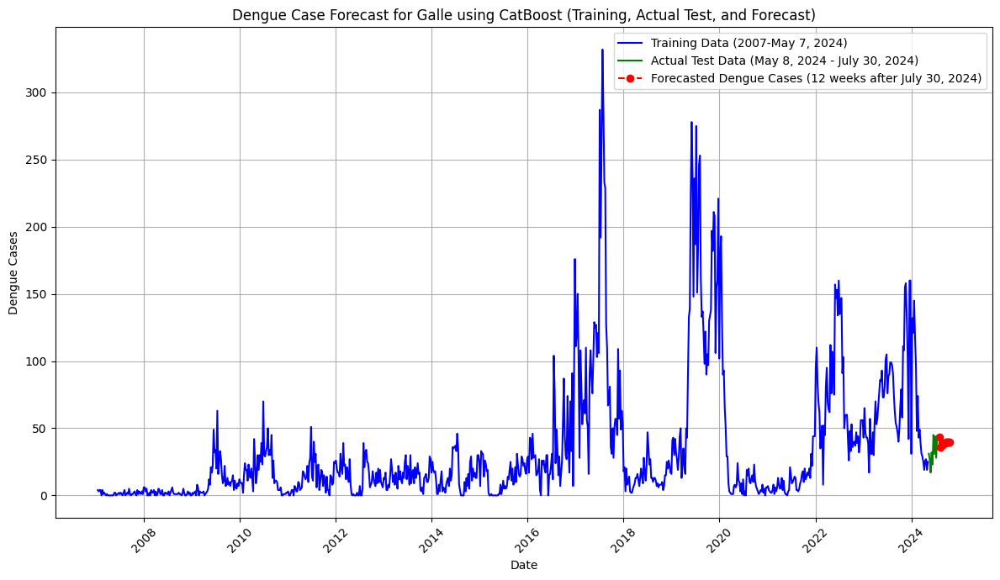


Evaluating RandomForest for district Galle...


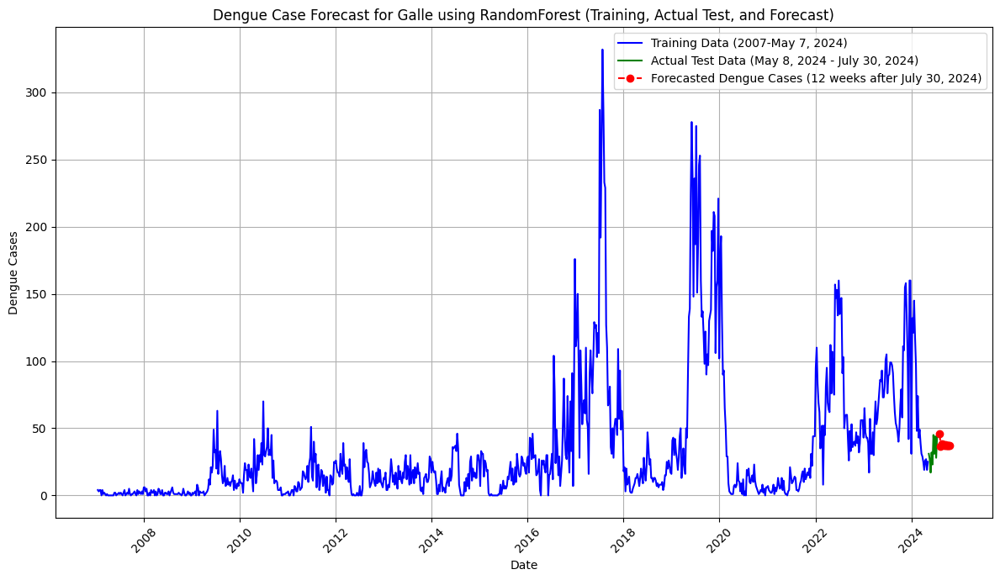


Evaluating GradientBoosting for district Badulla...


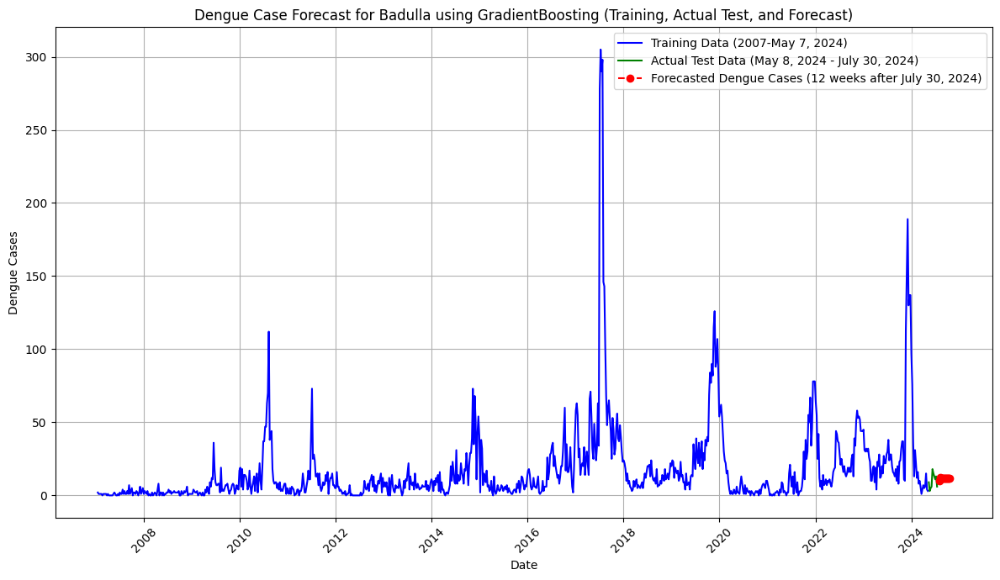


Evaluating XGBoost for district Badulla...


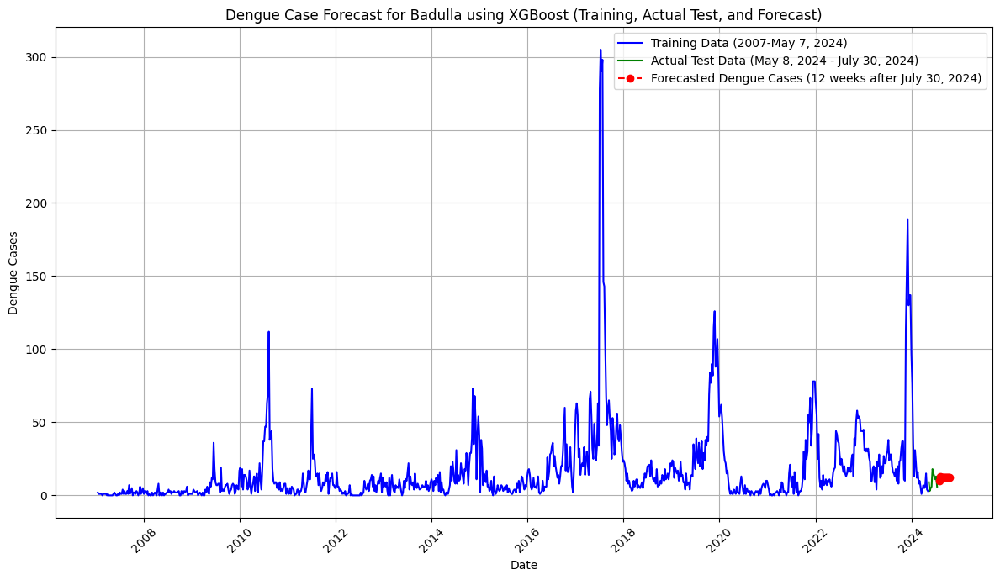


Evaluating LightGBM for district Badulla...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 690
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 16.978982
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

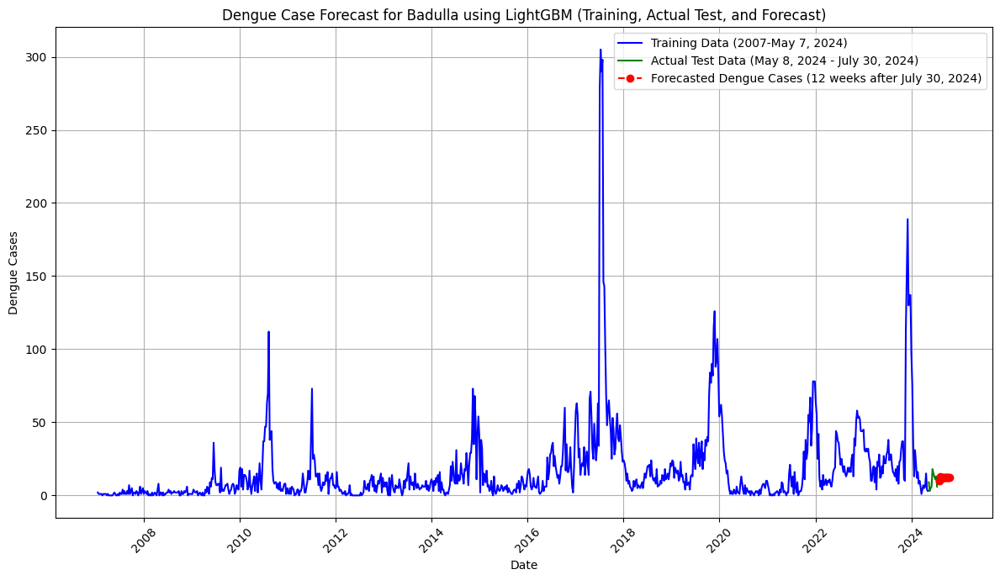


Evaluating CatBoost for district Badulla...


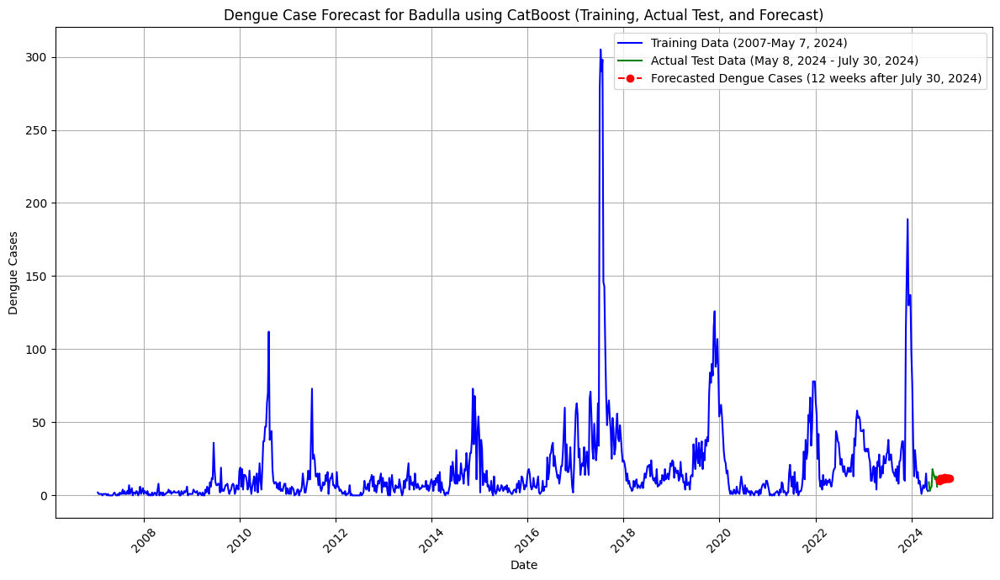


Evaluating RandomForest for district Badulla...


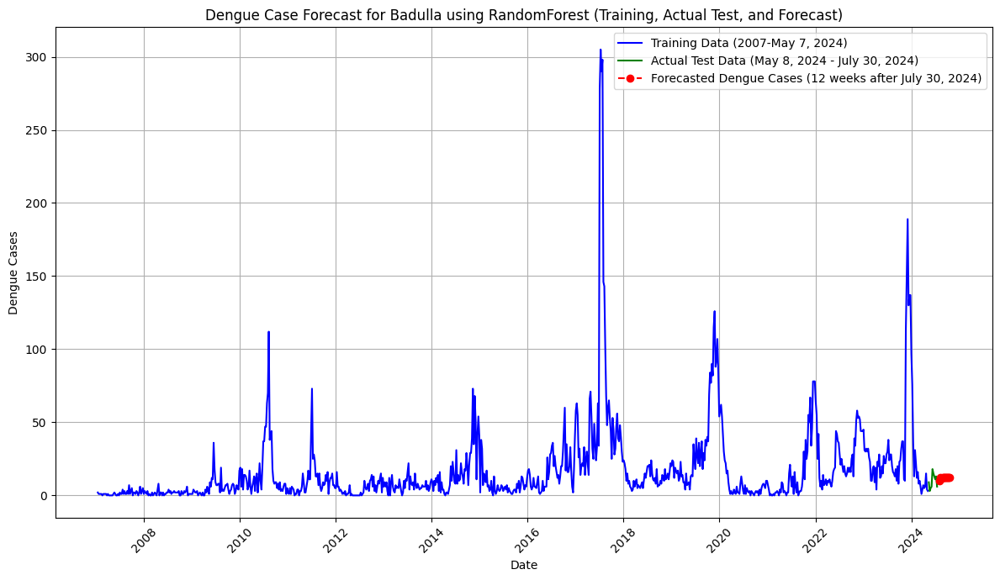


Evaluating GradientBoosting for district Vavuniya...


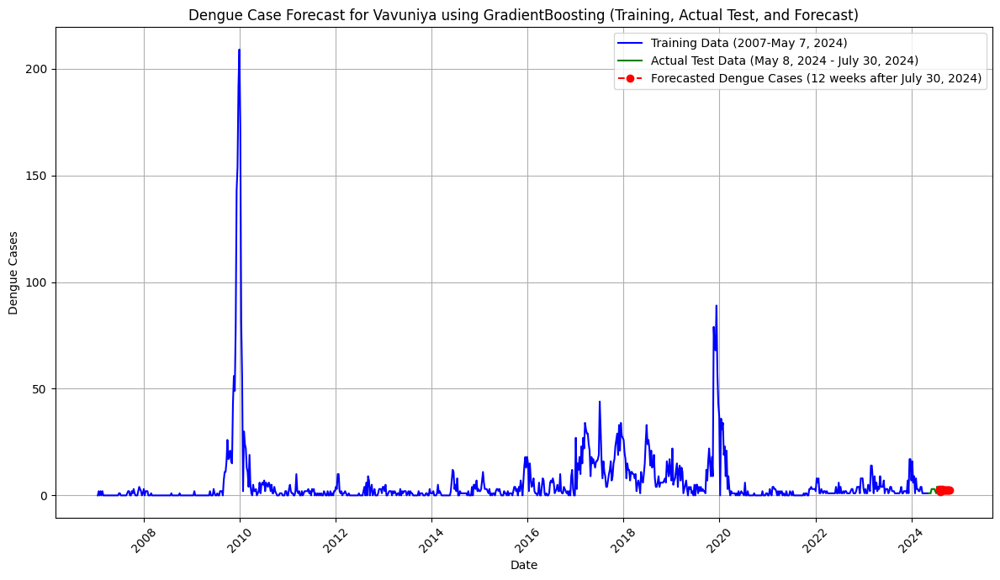


Evaluating XGBoost for district Vavuniya...


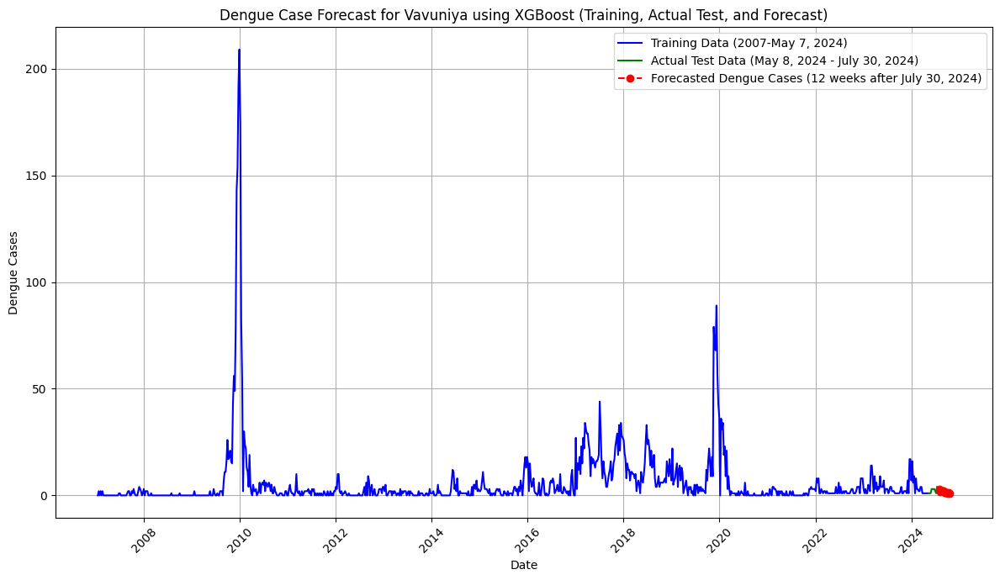


Evaluating LightGBM for district Vavuniya...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 611
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 5.945796
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

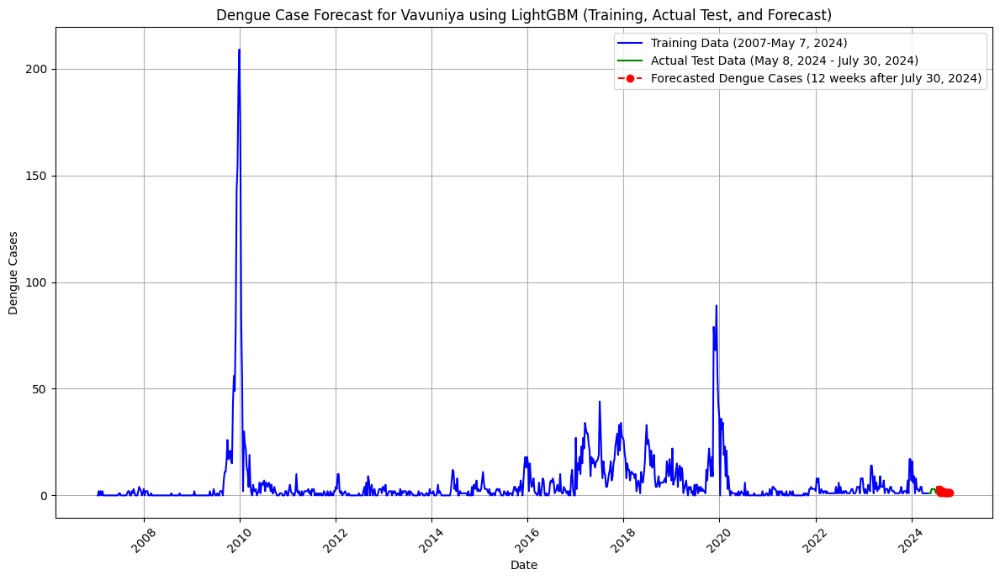


Evaluating CatBoost for district Vavuniya...


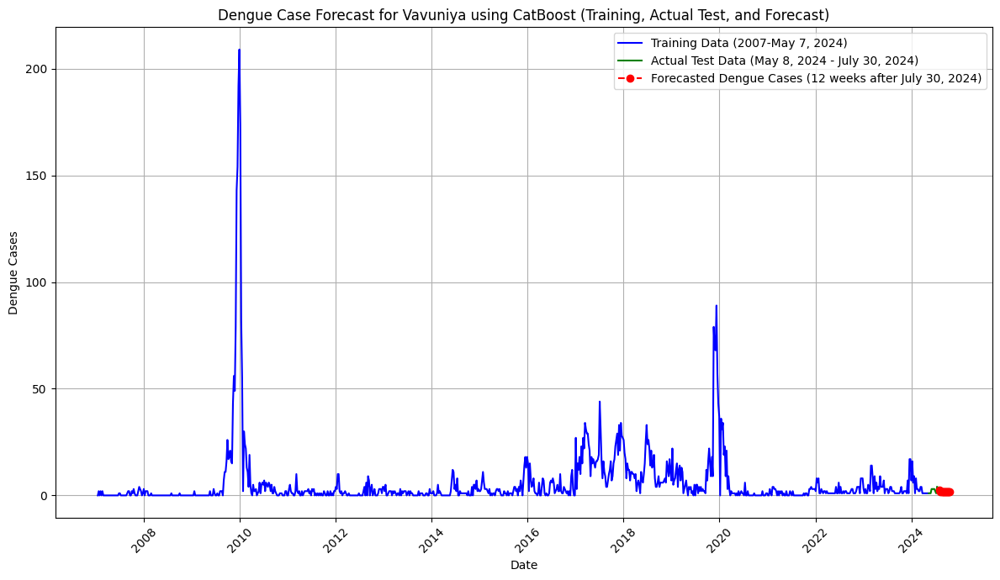


Evaluating RandomForest for district Vavuniya...


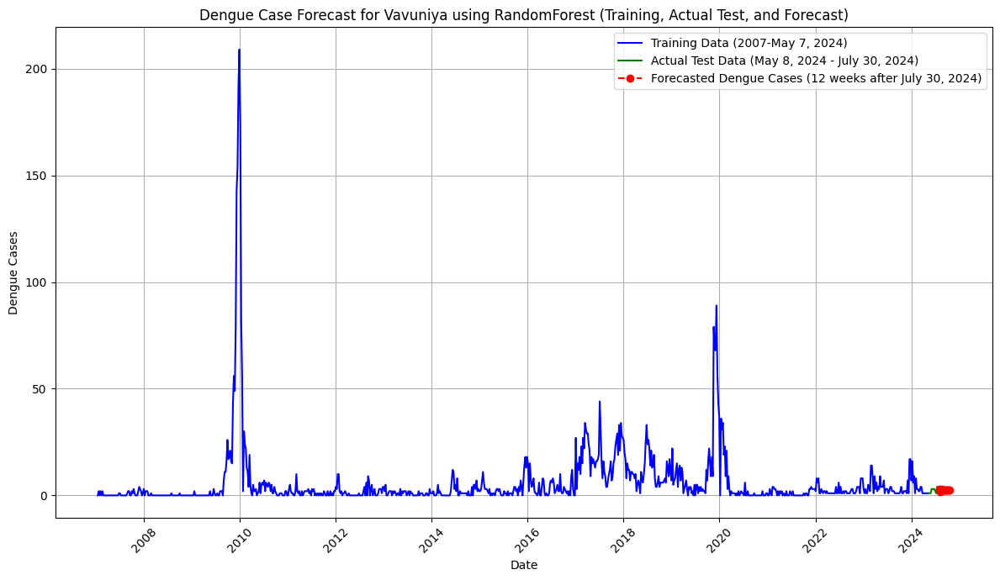


Evaluating GradientBoosting for district Trincomalee...


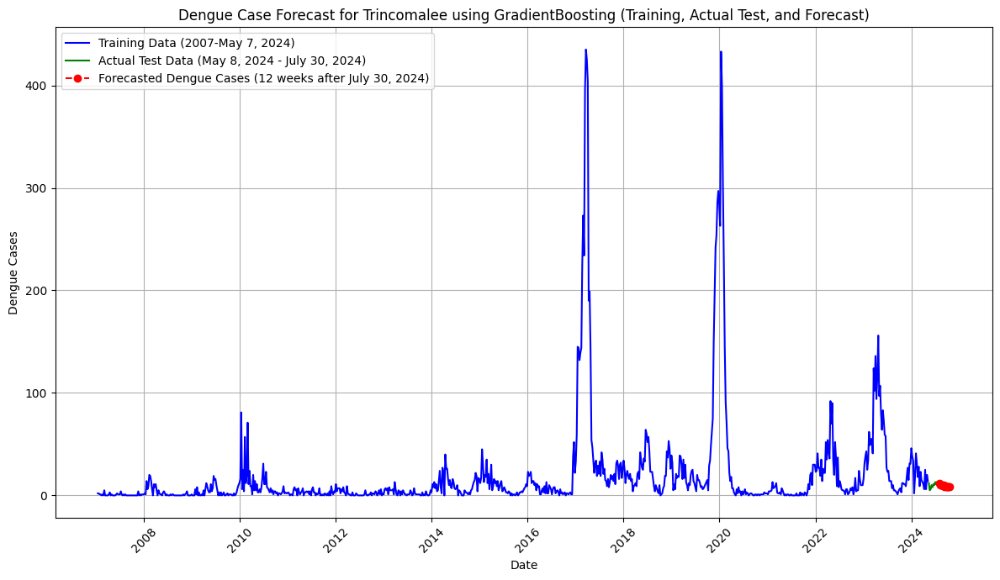


Evaluating XGBoost for district Trincomalee...


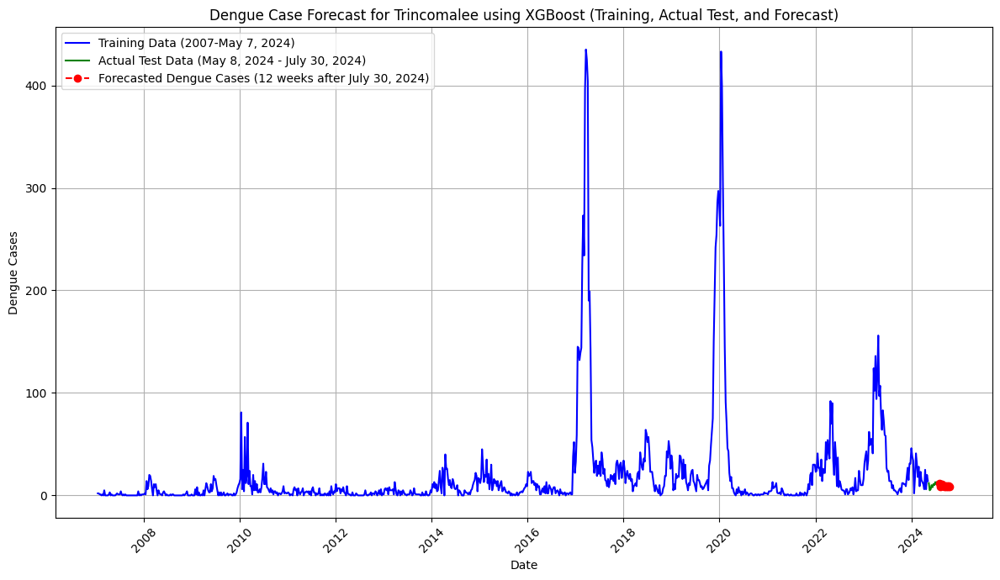


Evaluating LightGBM for district Trincomalee...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 681
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 19.180310
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

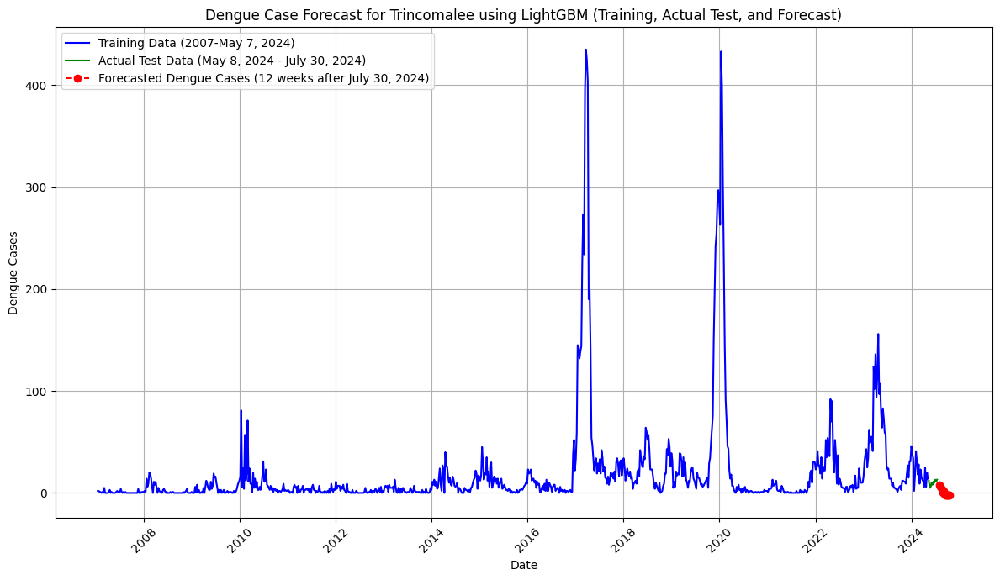


Evaluating CatBoost for district Trincomalee...


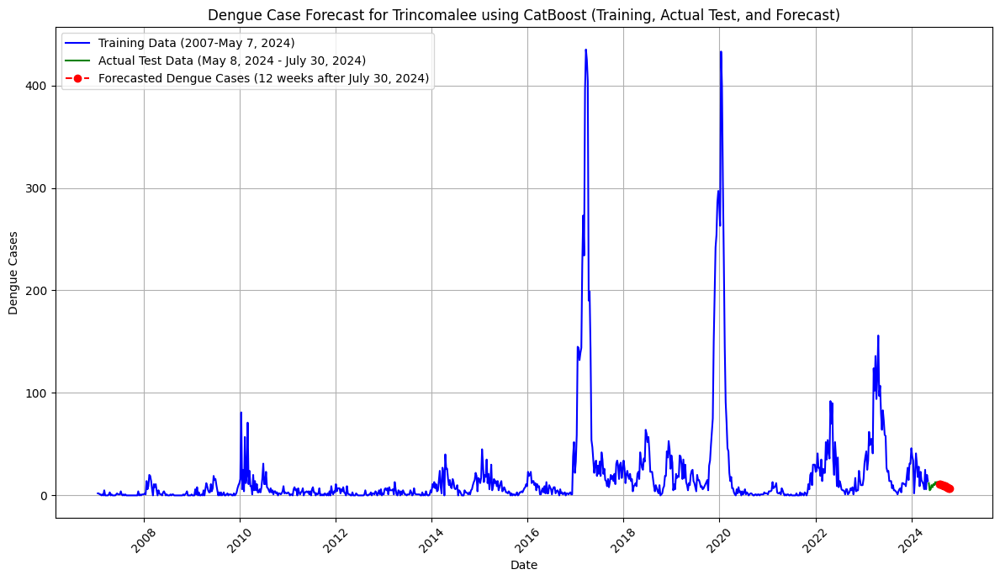


Evaluating RandomForest for district Trincomalee...


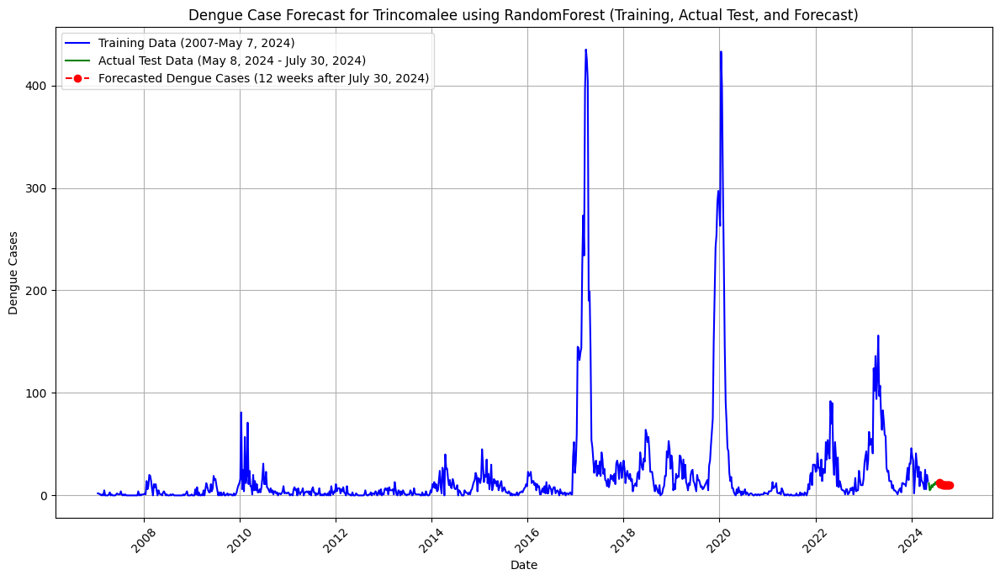


Evaluating GradientBoosting for district Hambantota...


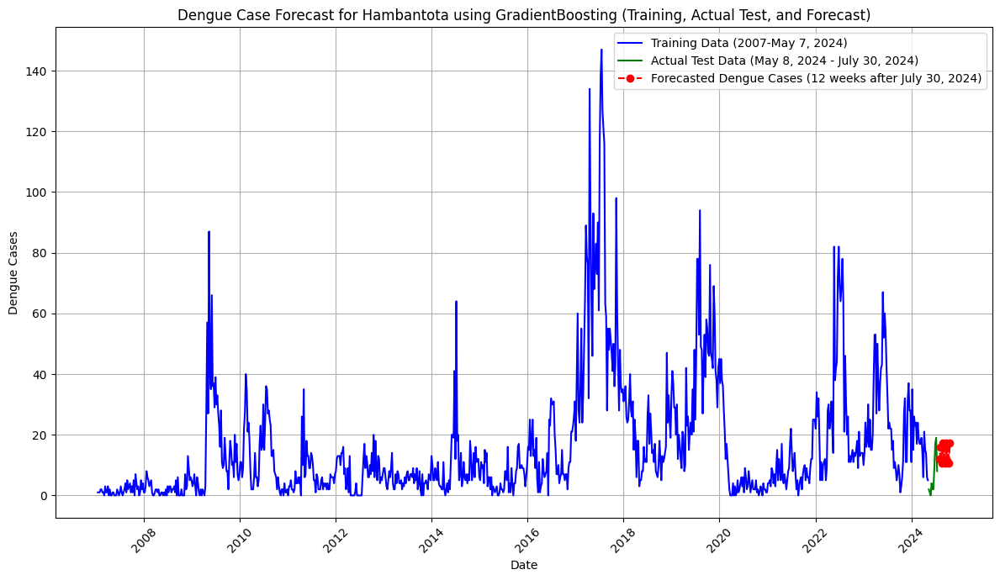


Evaluating XGBoost for district Hambantota...


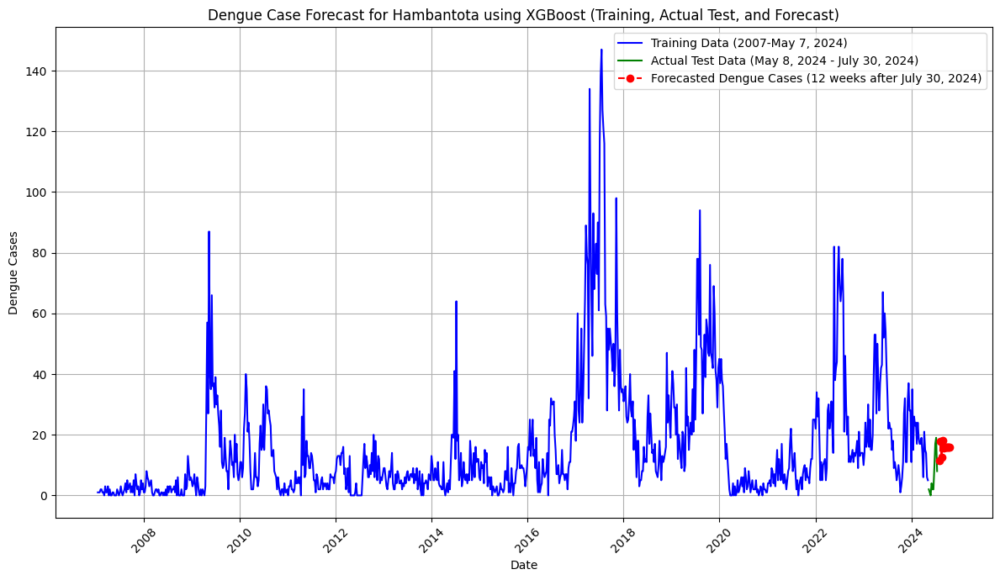


Evaluating LightGBM for district Hambantota...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 691
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 16.046460
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

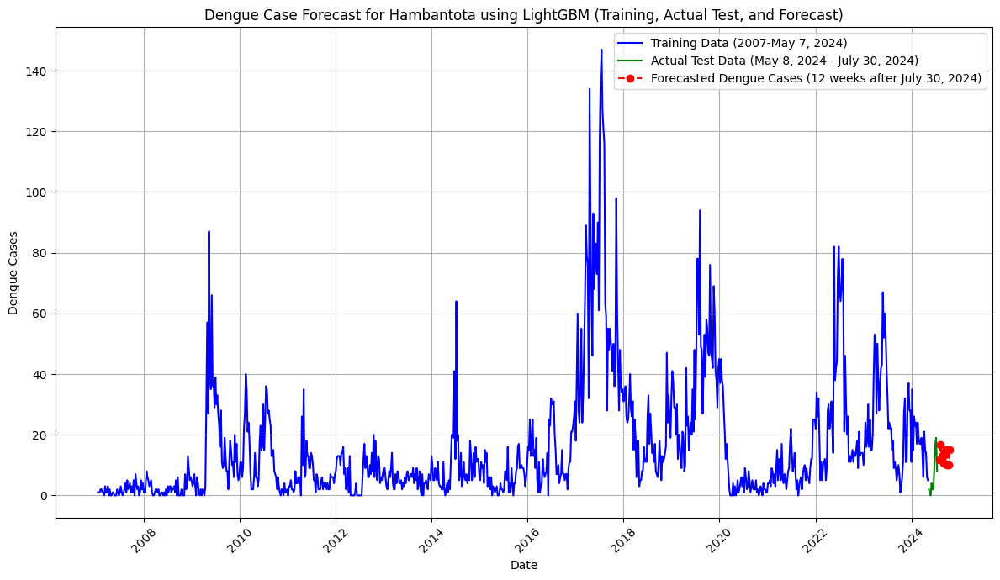


Evaluating CatBoost for district Hambantota...


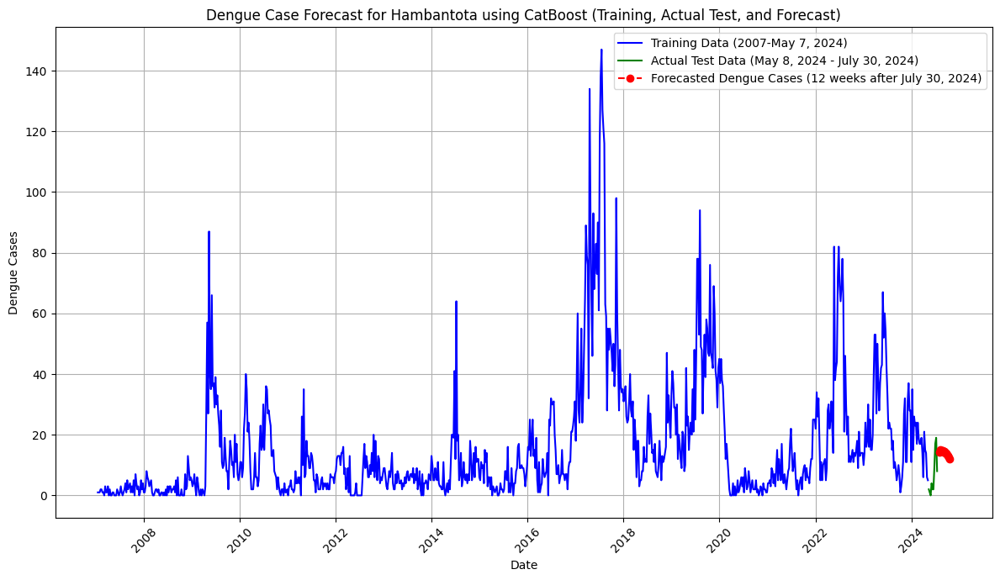


Evaluating RandomForest for district Hambantota...


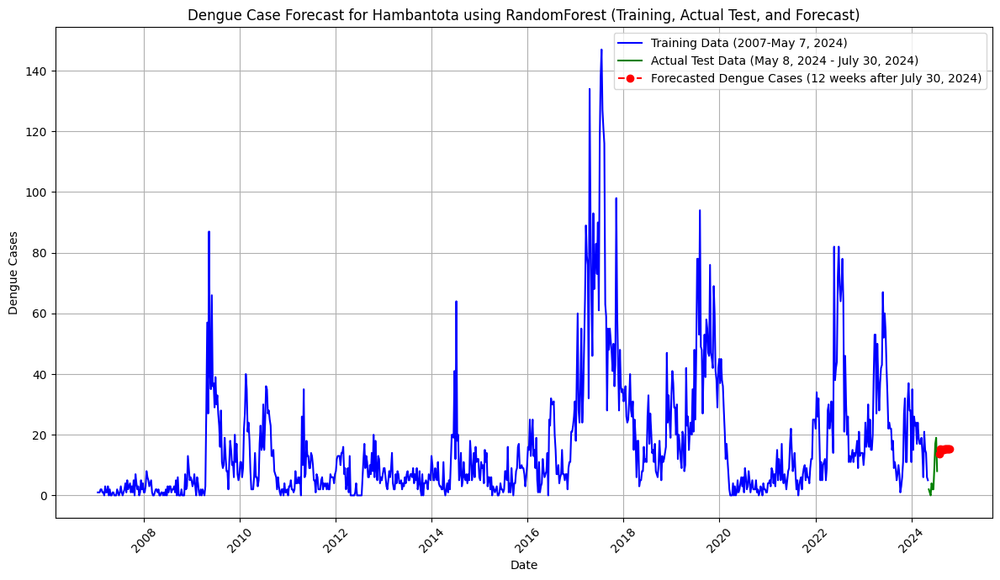


Evaluating GradientBoosting for district Kurunegala...


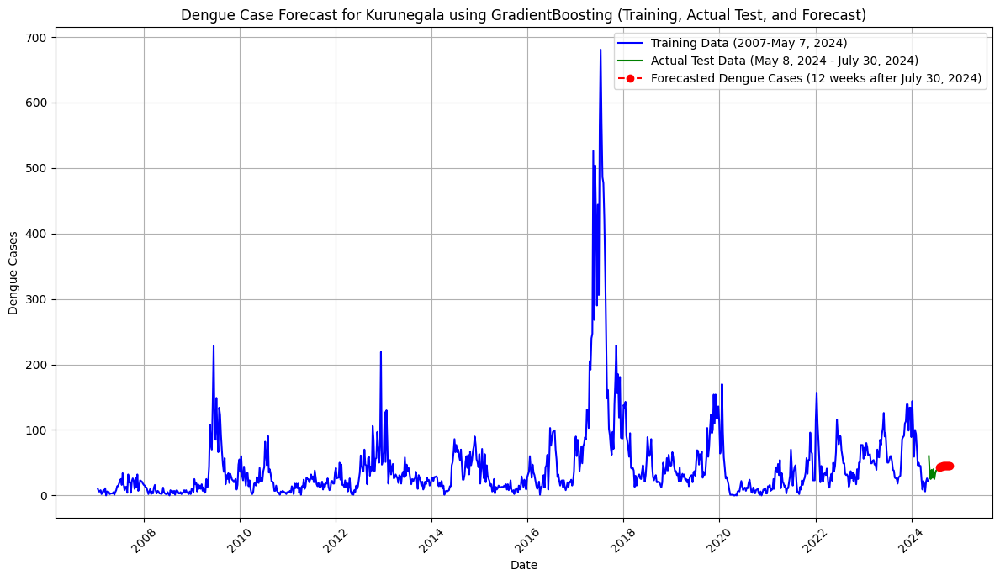


Evaluating XGBoost for district Kurunegala...


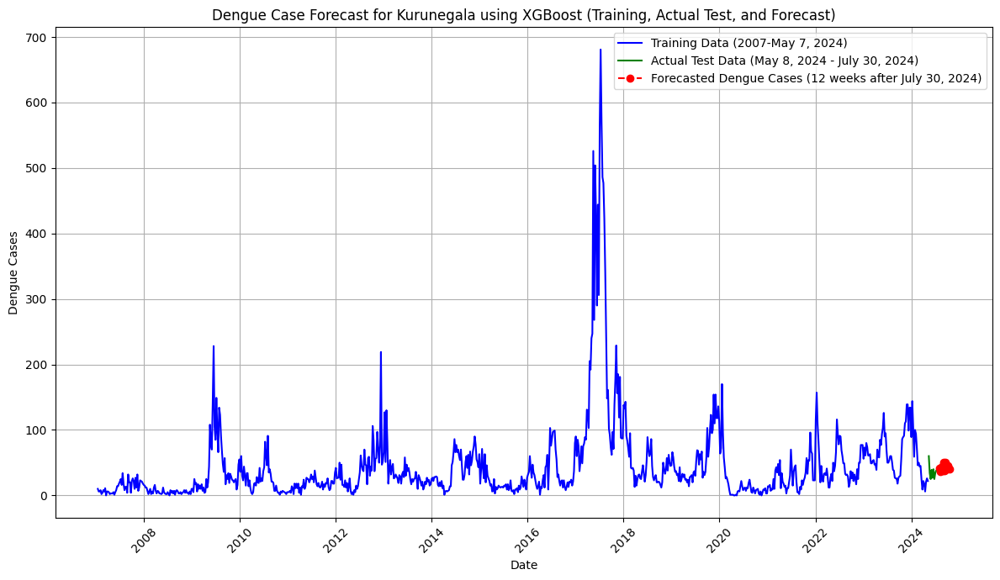


Evaluating LightGBM for district Kurunegala...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 44.266593
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

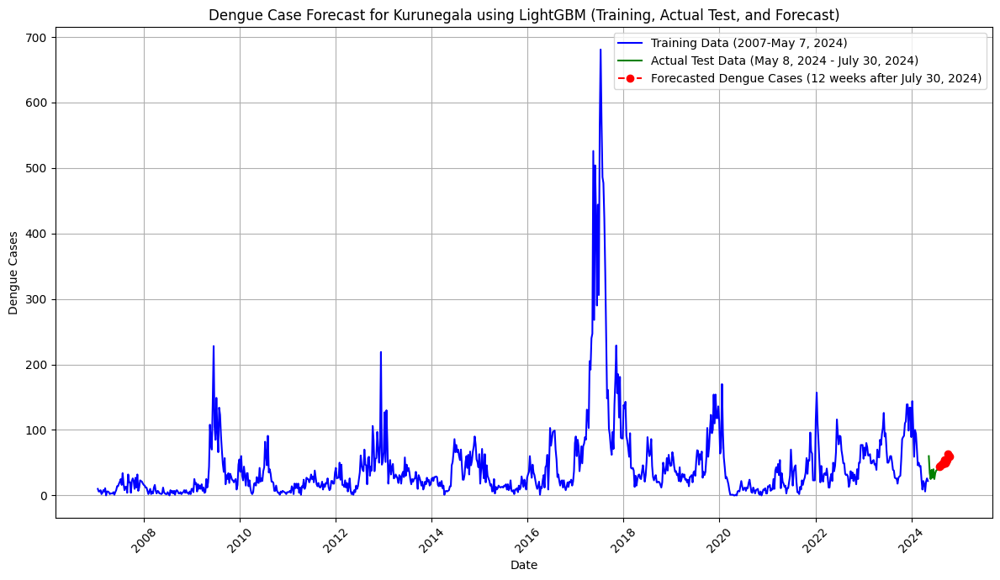


Evaluating CatBoost for district Kurunegala...


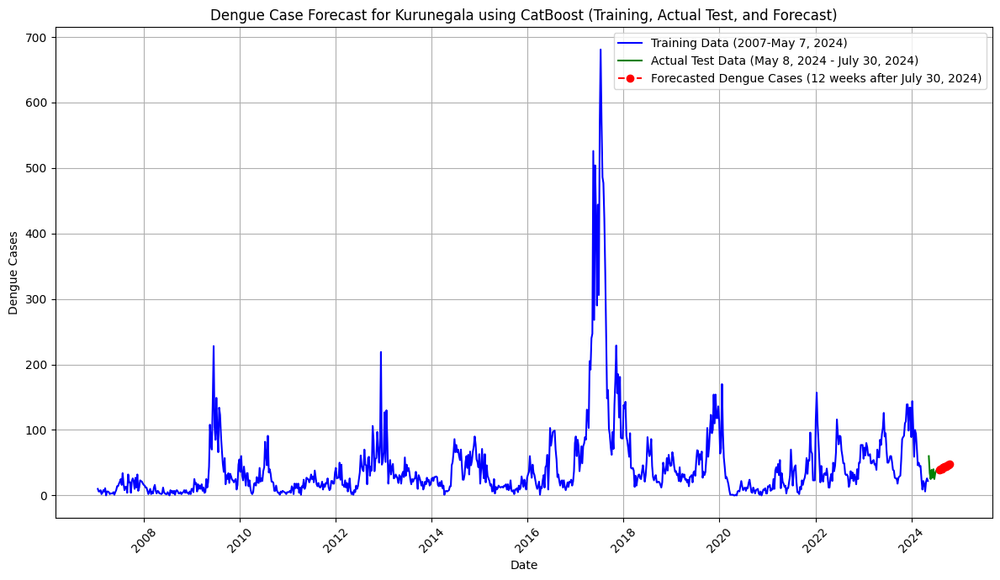


Evaluating RandomForest for district Kurunegala...


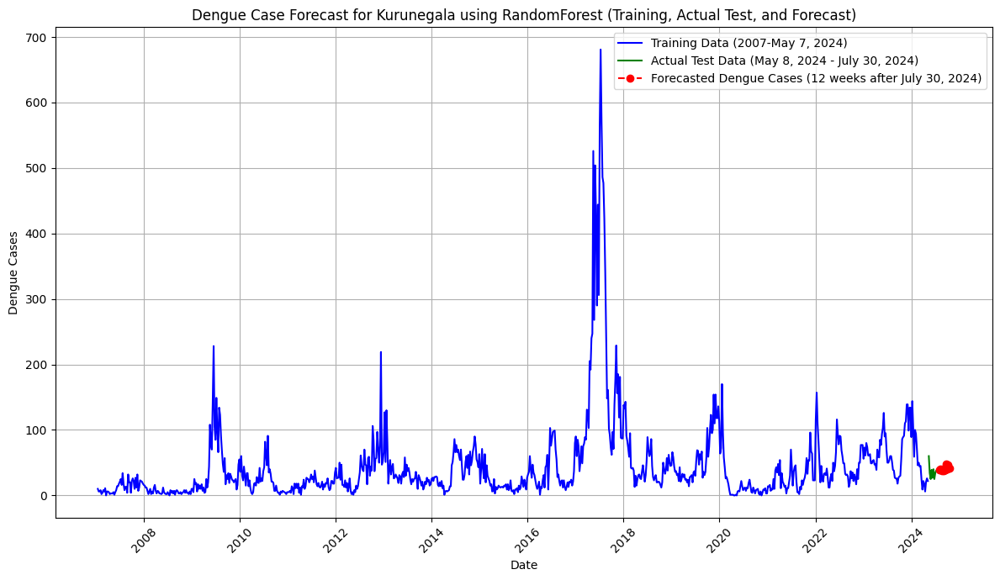


Evaluating GradientBoosting for district Ampara...


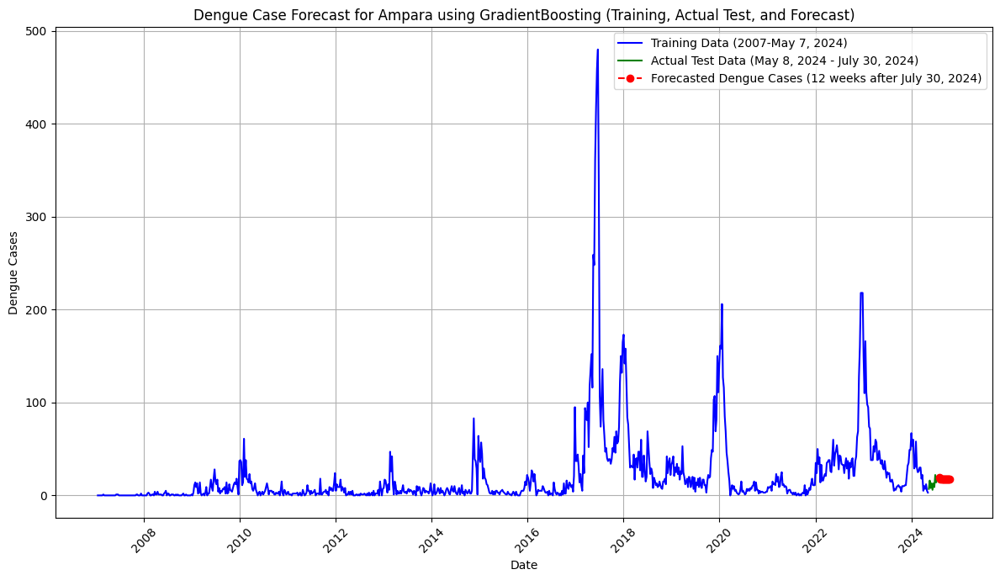


Evaluating XGBoost for district Ampara...


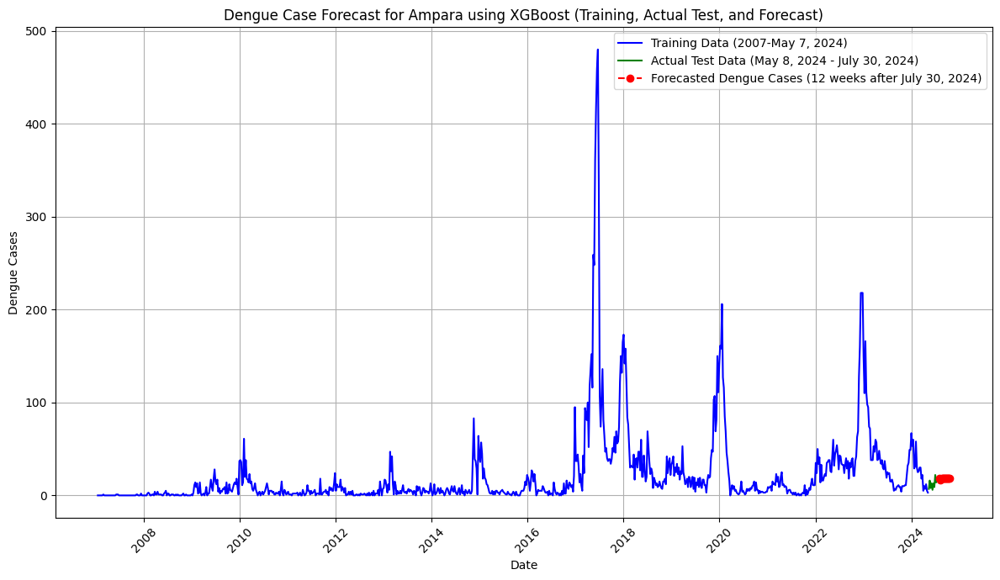


Evaluating LightGBM for district Ampara...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 710
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 21.464602
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

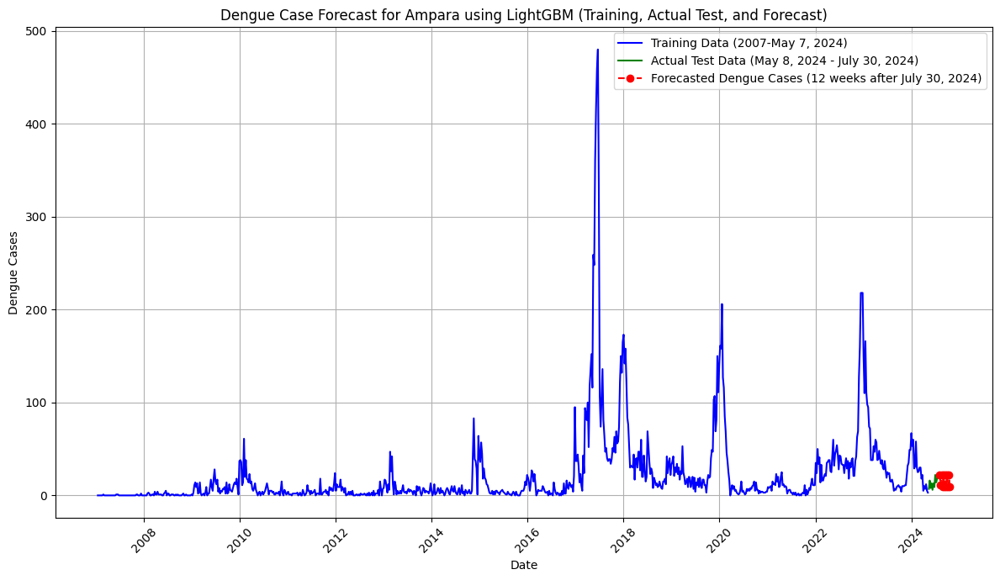


Evaluating CatBoost for district Ampara...


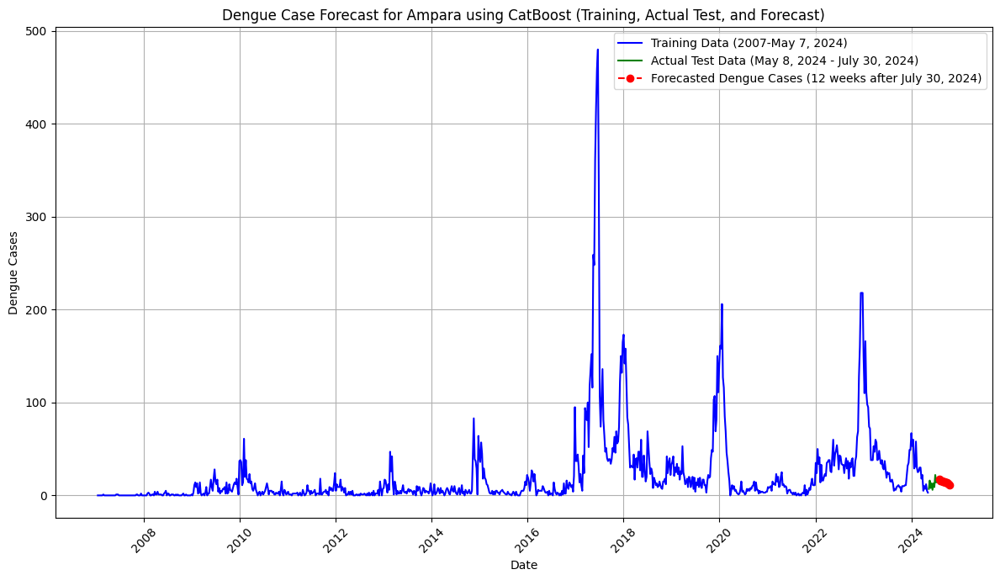


Evaluating RandomForest for district Ampara...


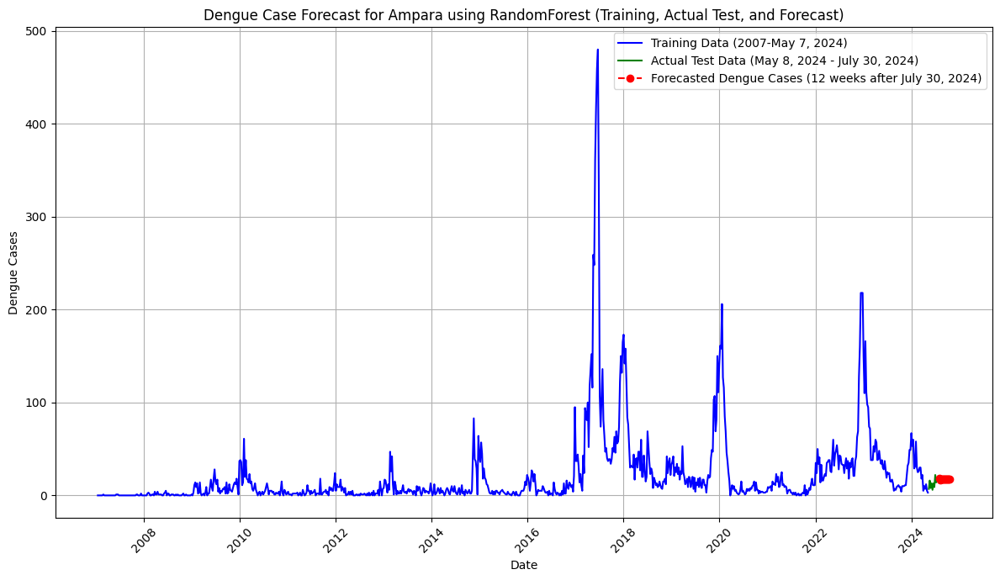


Evaluating GradientBoosting for district Mullaitivu...


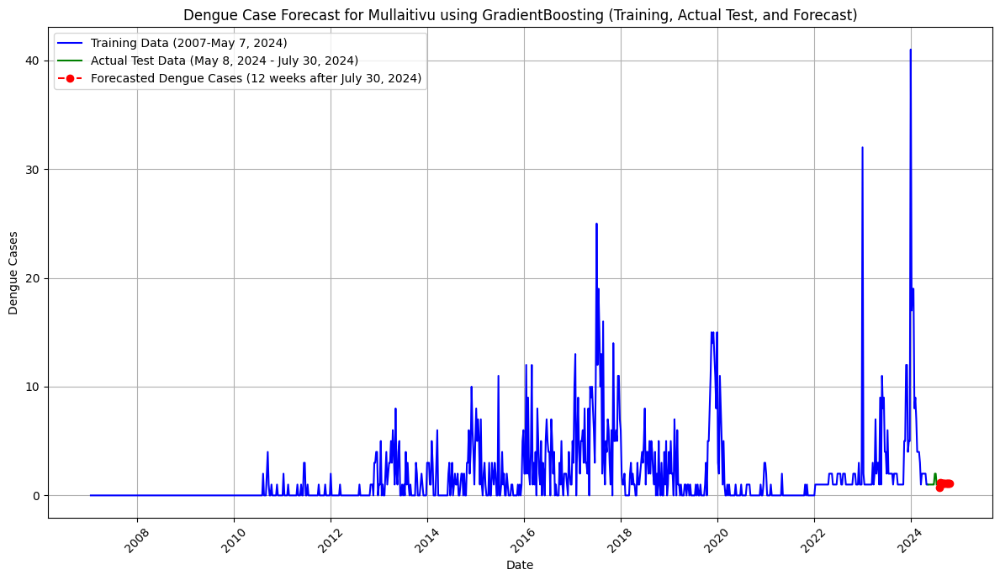


Evaluating XGBoost for district Mullaitivu...


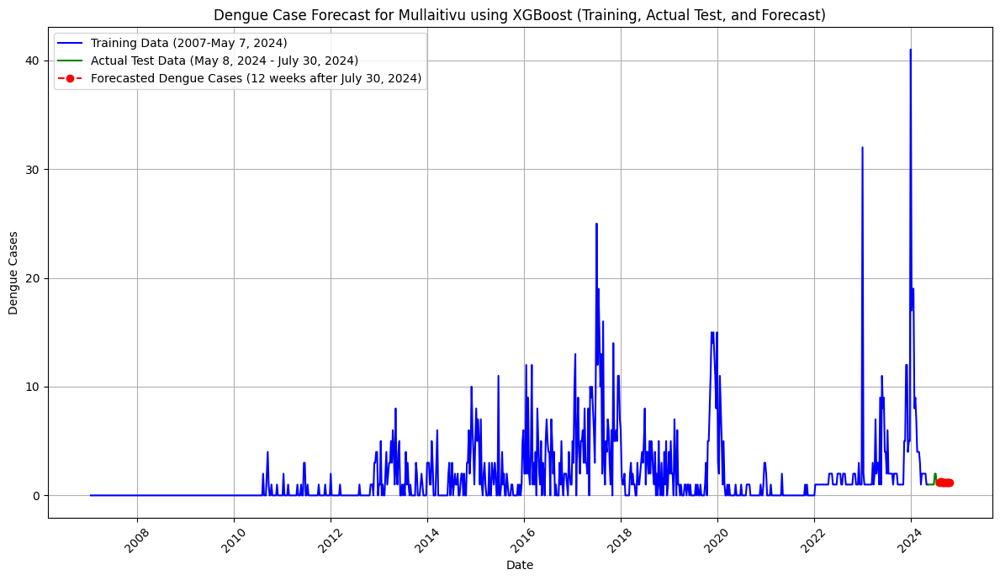


Evaluating LightGBM for district Mullaitivu...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 559
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 1.735619
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

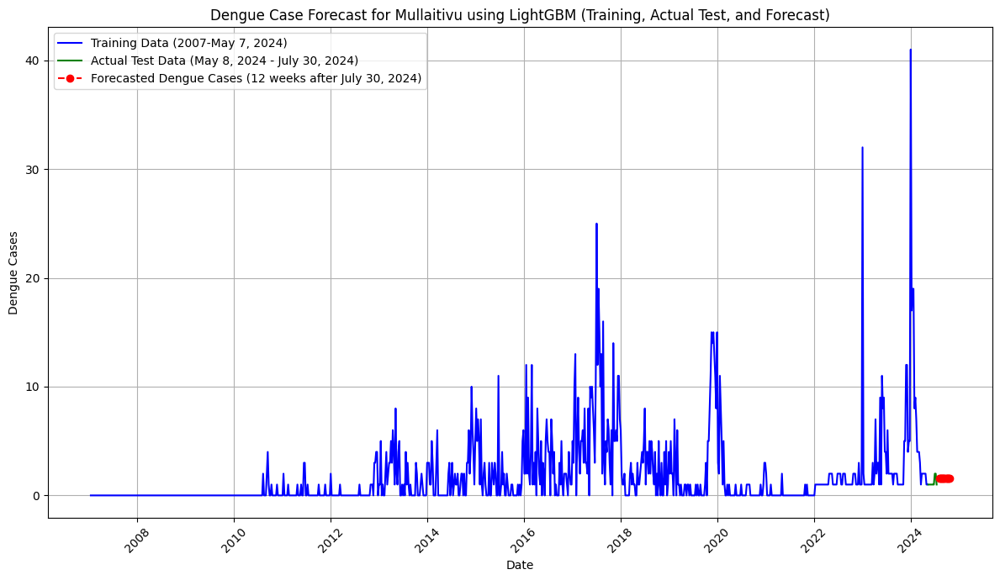


Evaluating CatBoost for district Mullaitivu...


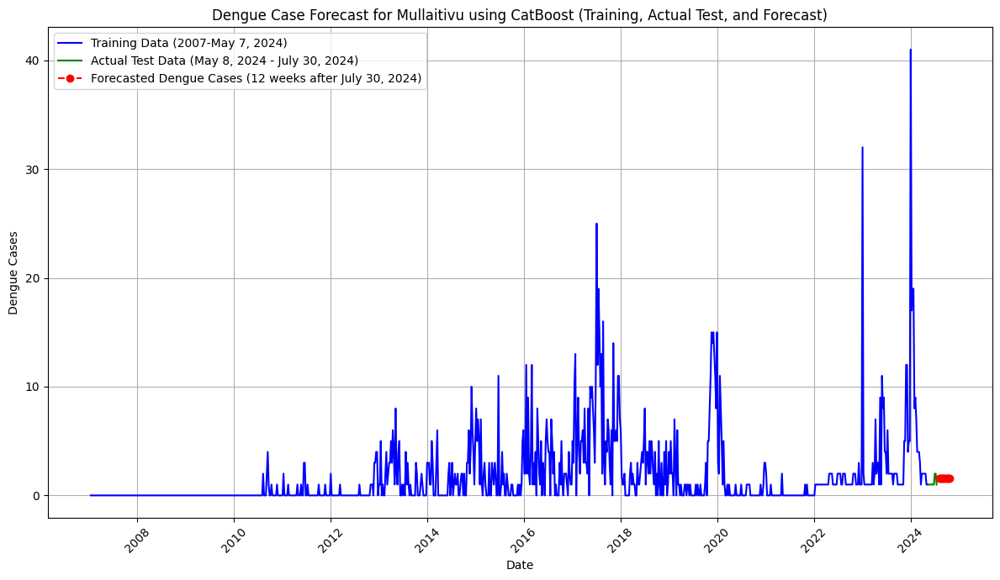


Evaluating RandomForest for district Mullaitivu...


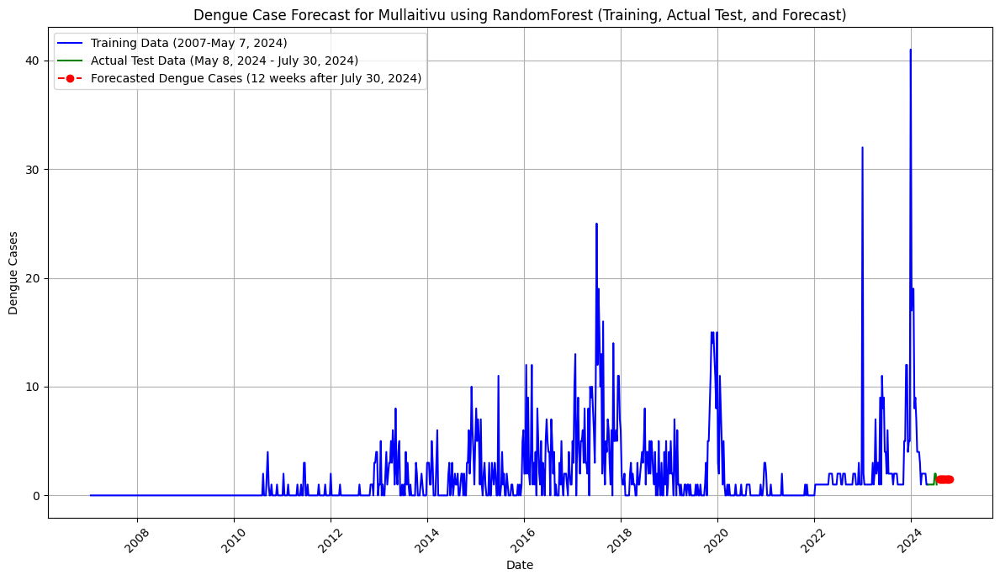


Evaluating GradientBoosting for district Mannar...


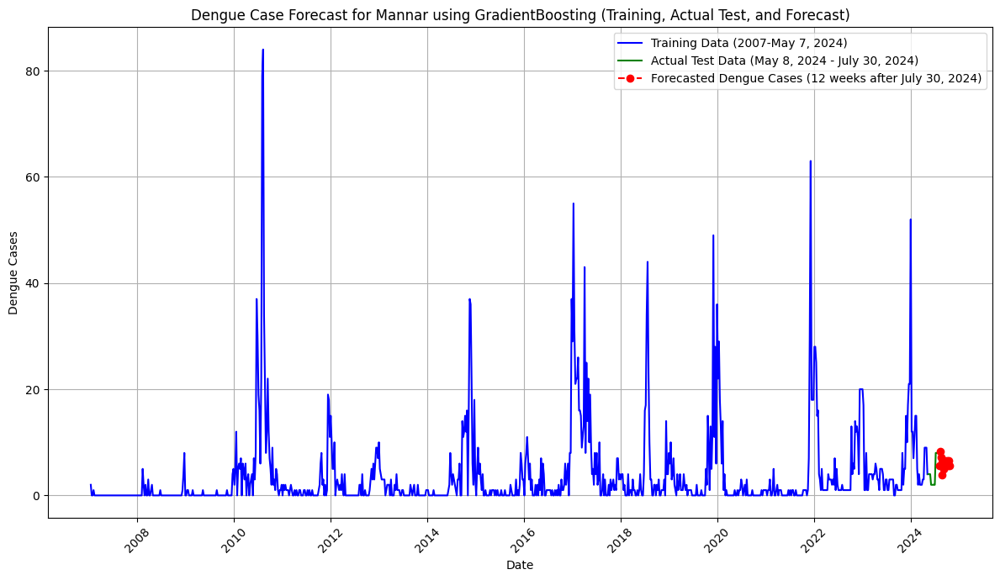


Evaluating XGBoost for district Mannar...


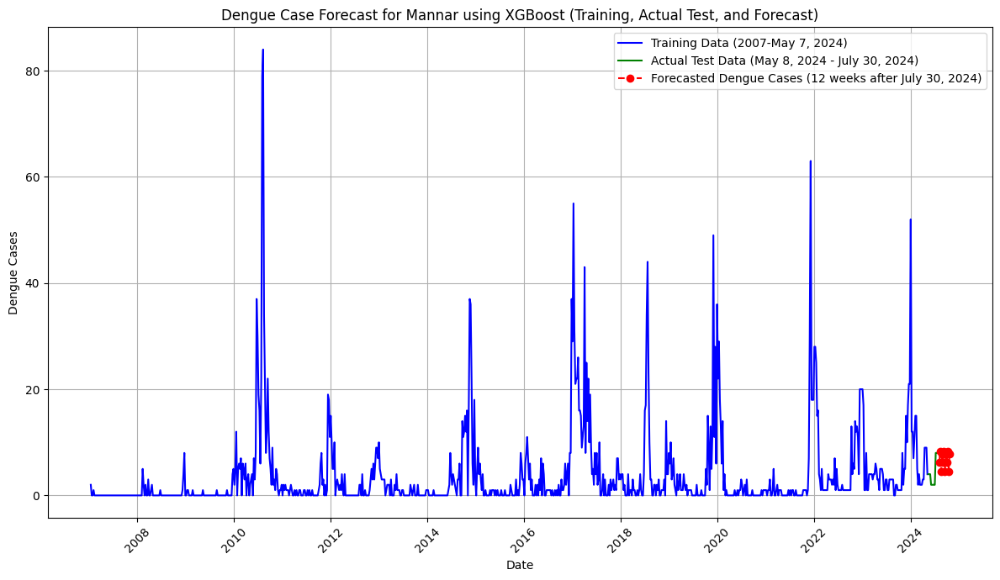


Evaluating LightGBM for district Mannar...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 598
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 3.800885
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

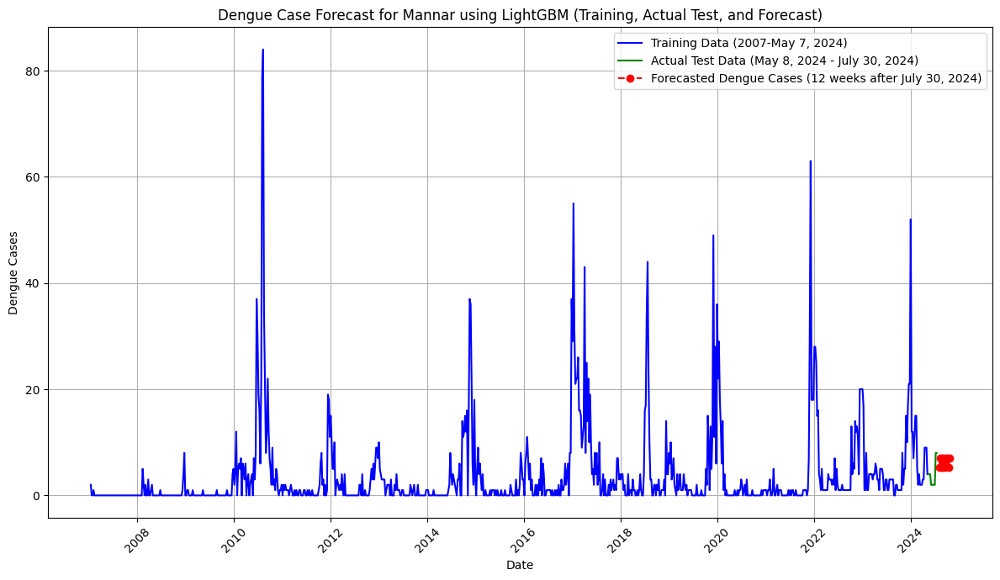


Evaluating CatBoost for district Mannar...


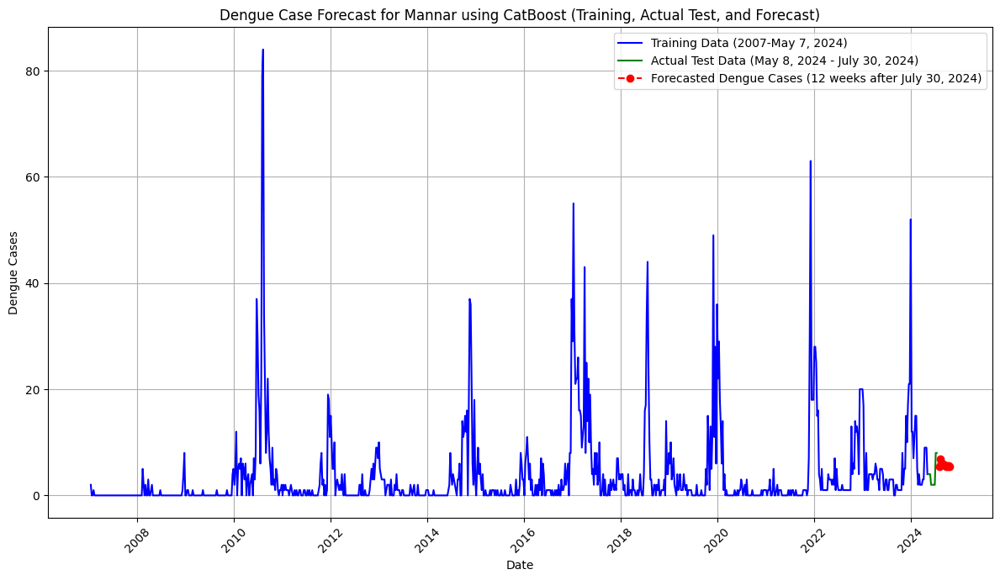


Evaluating RandomForest for district Mannar...


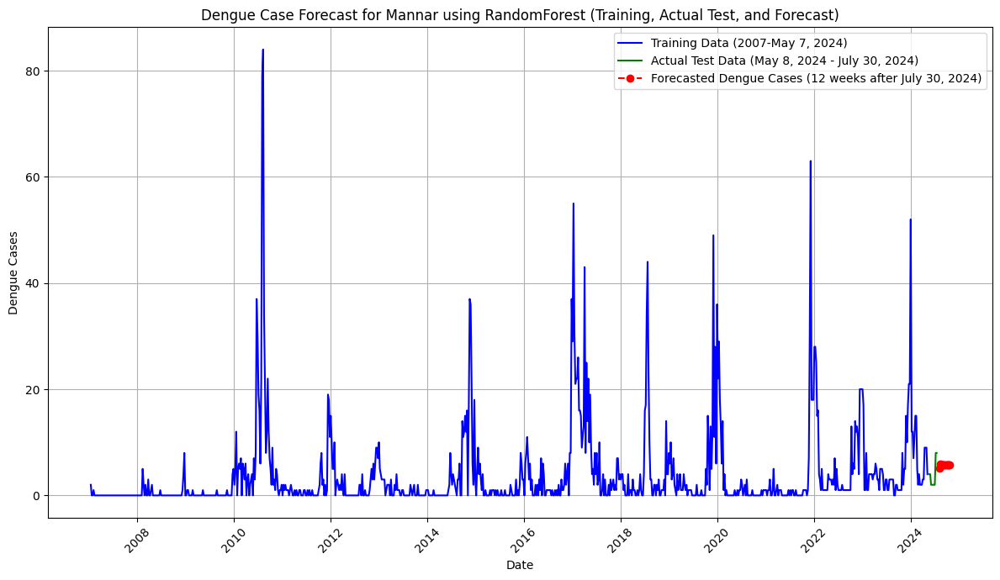


Evaluating GradientBoosting for district Colombo...


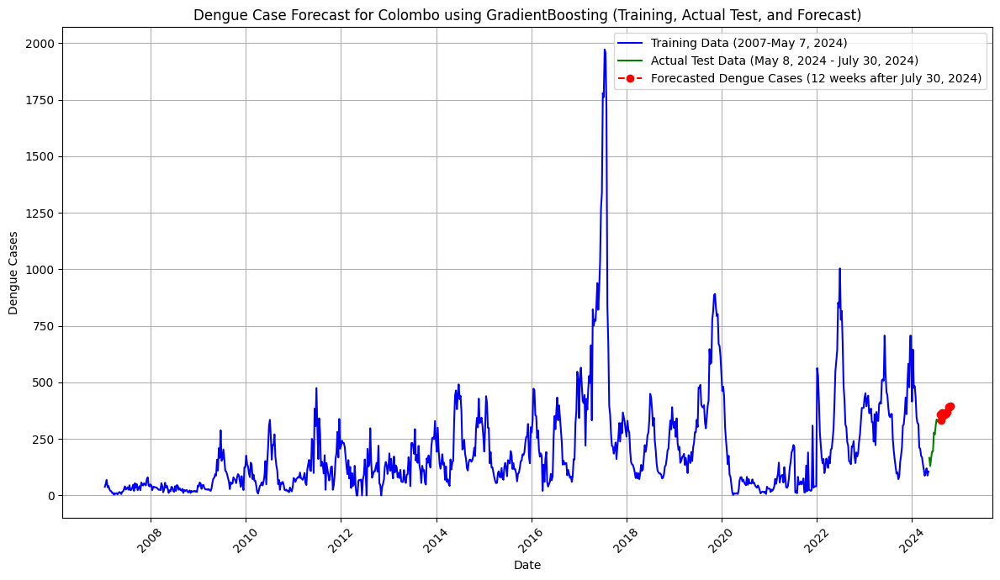


Evaluating XGBoost for district Colombo...


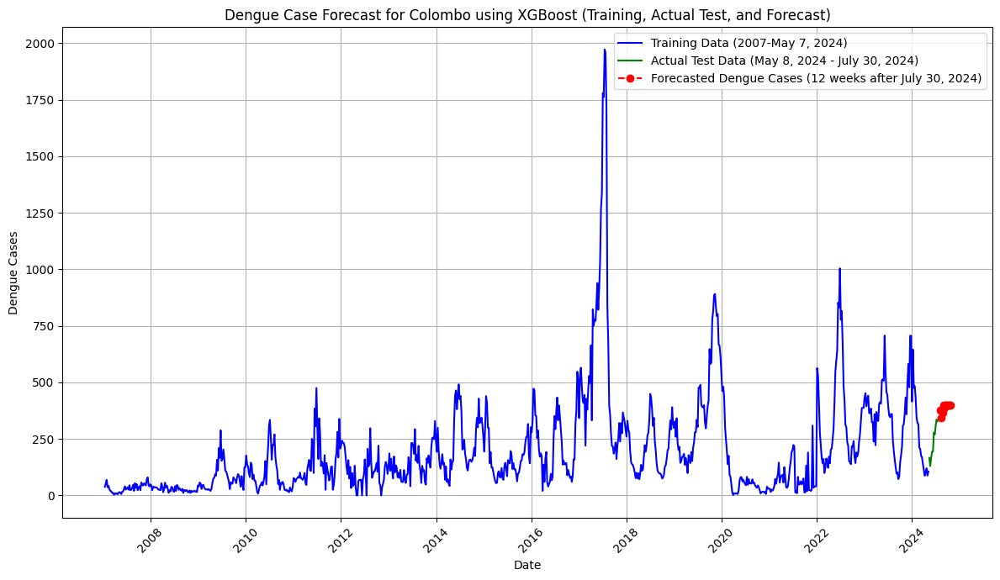


Evaluating LightGBM for district Colombo...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1018
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 196.217920
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

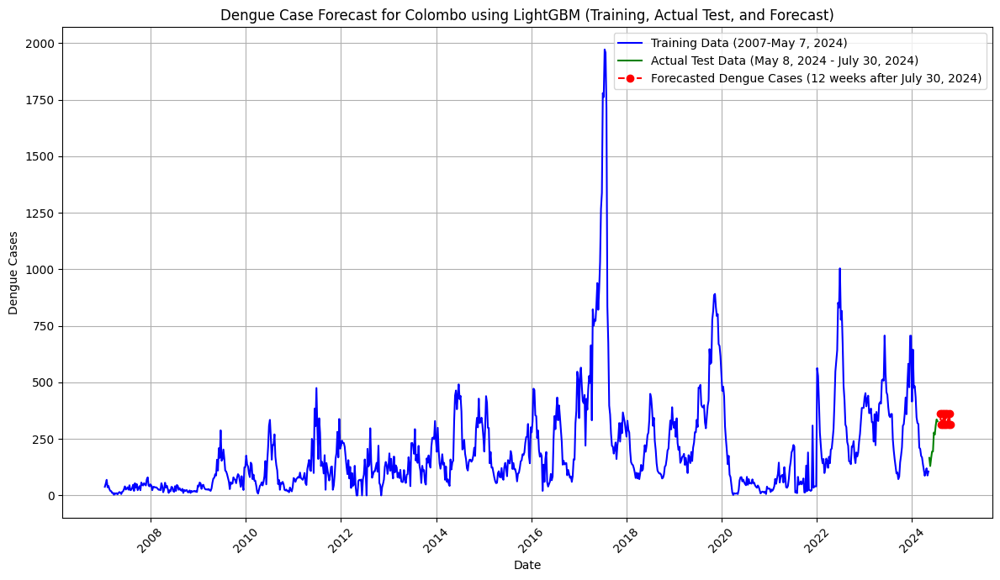


Evaluating CatBoost for district Colombo...


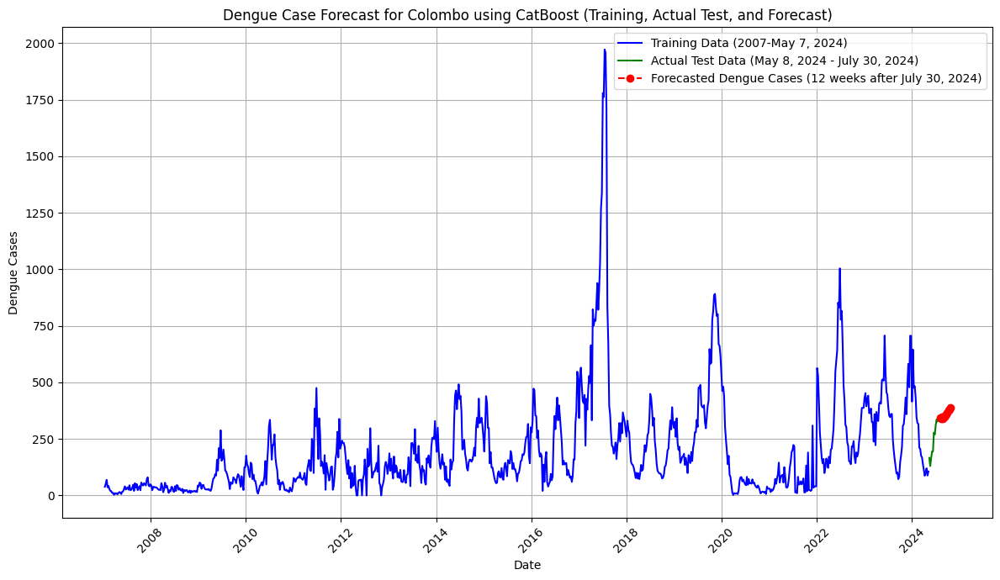


Evaluating RandomForest for district Colombo...


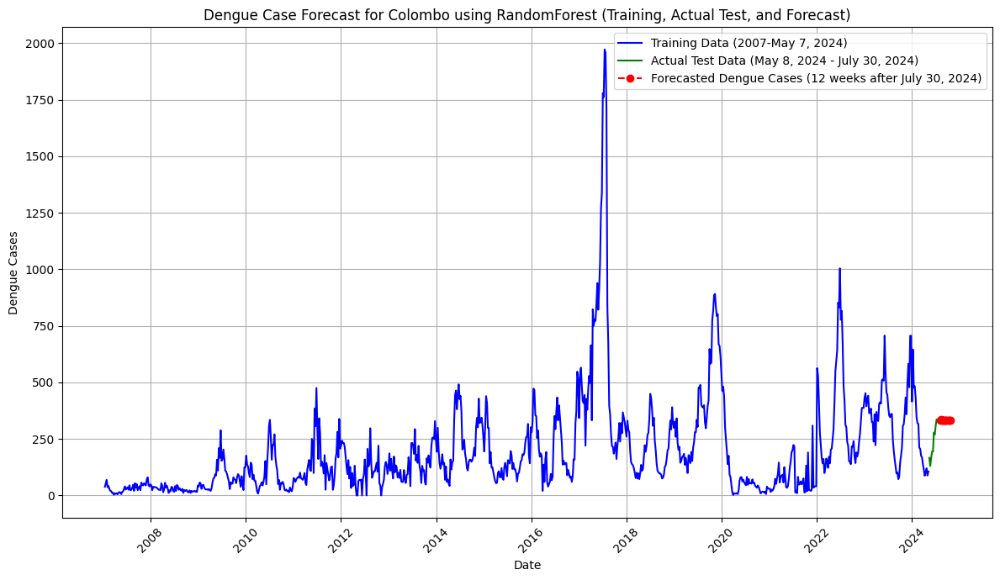


Evaluating GradientBoosting for district Kegalle...


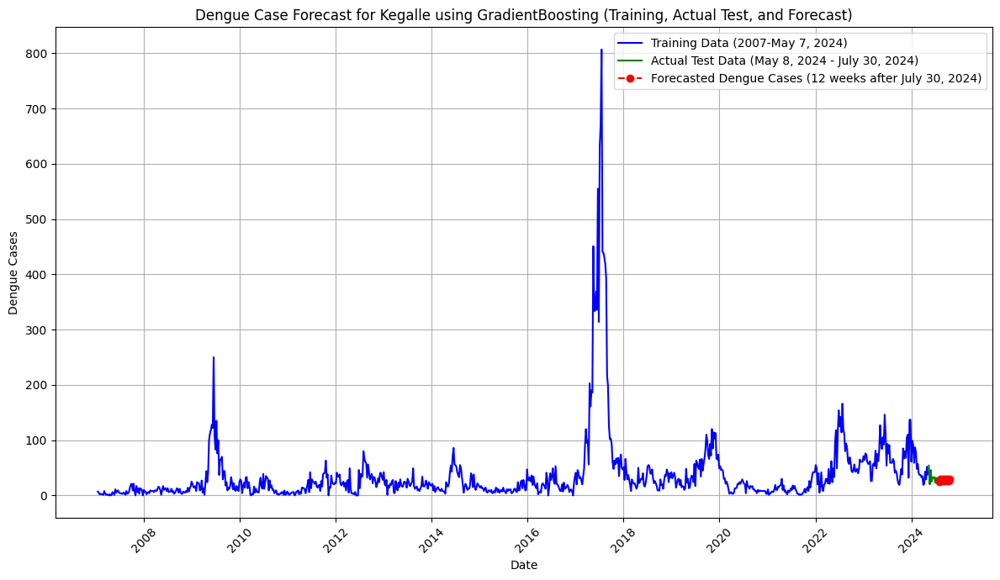


Evaluating XGBoost for district Kegalle...


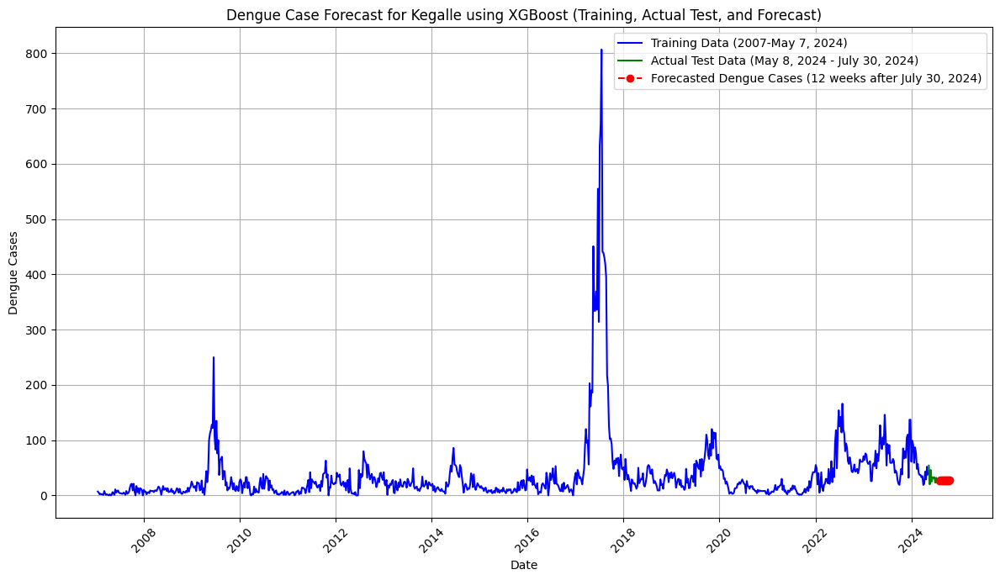


Evaluating LightGBM for district Kegalle...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 844
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 36.950221
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

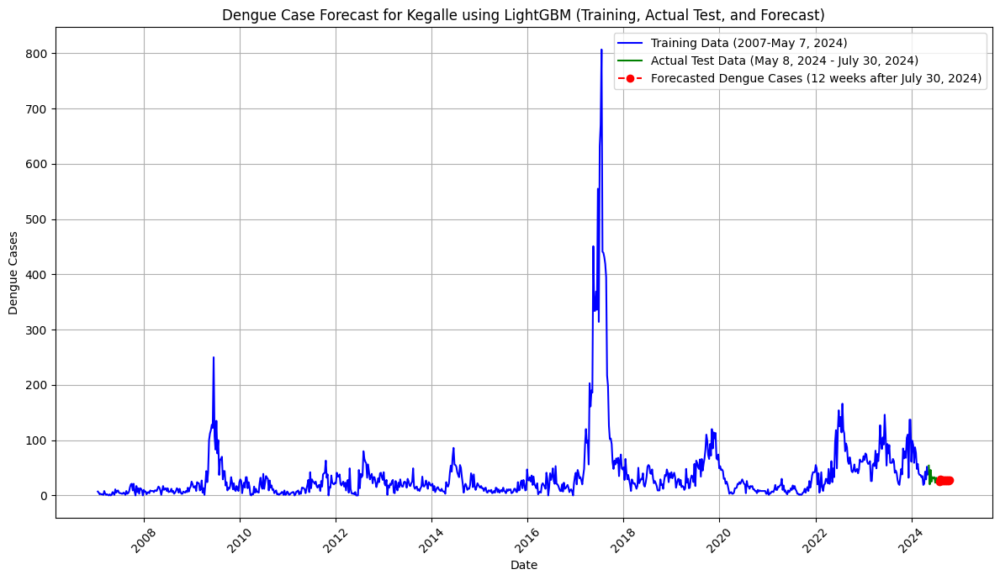


Evaluating CatBoost for district Kegalle...


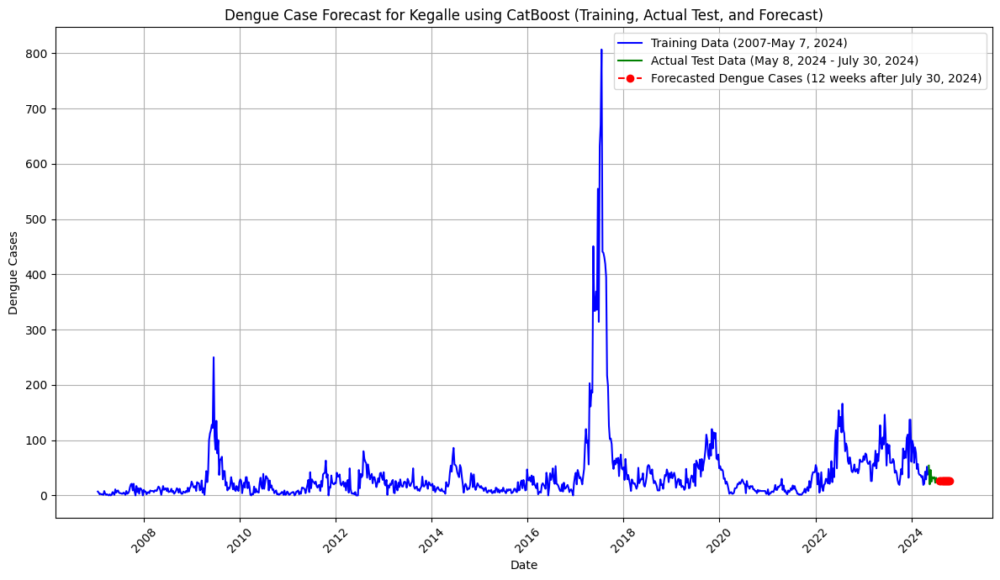


Evaluating RandomForest for district Kegalle...


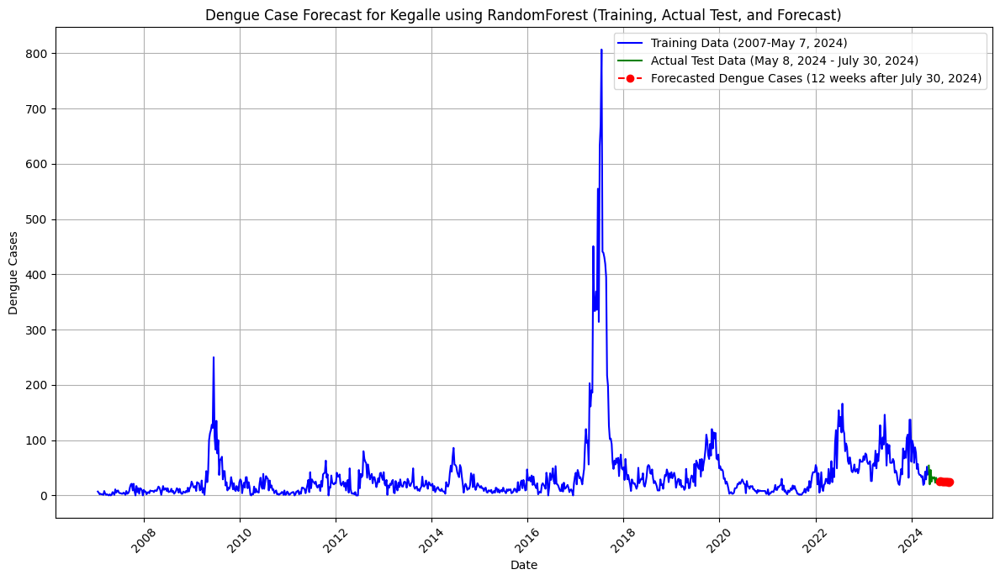


Evaluating GradientBoosting for district Matara...


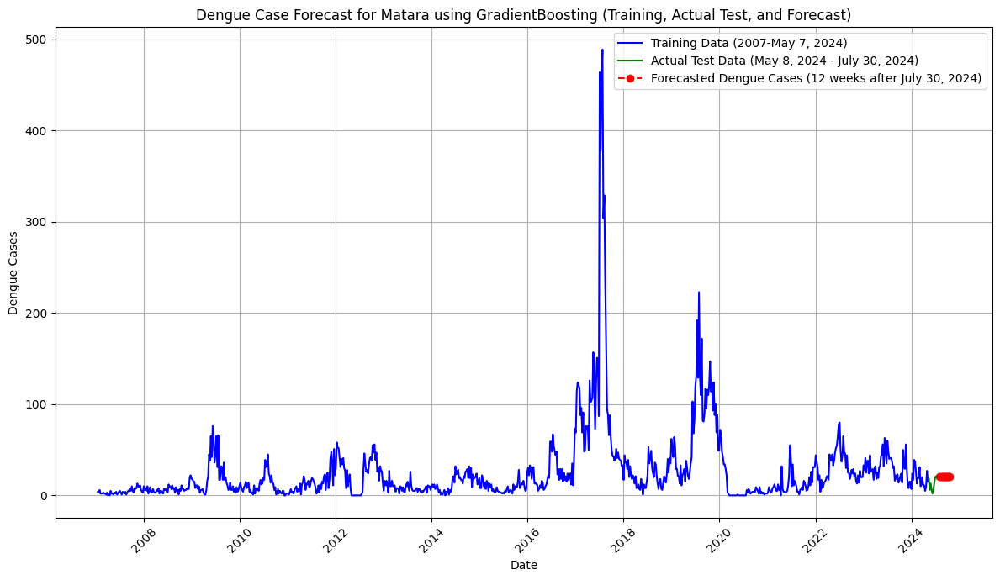


Evaluating XGBoost for district Matara...


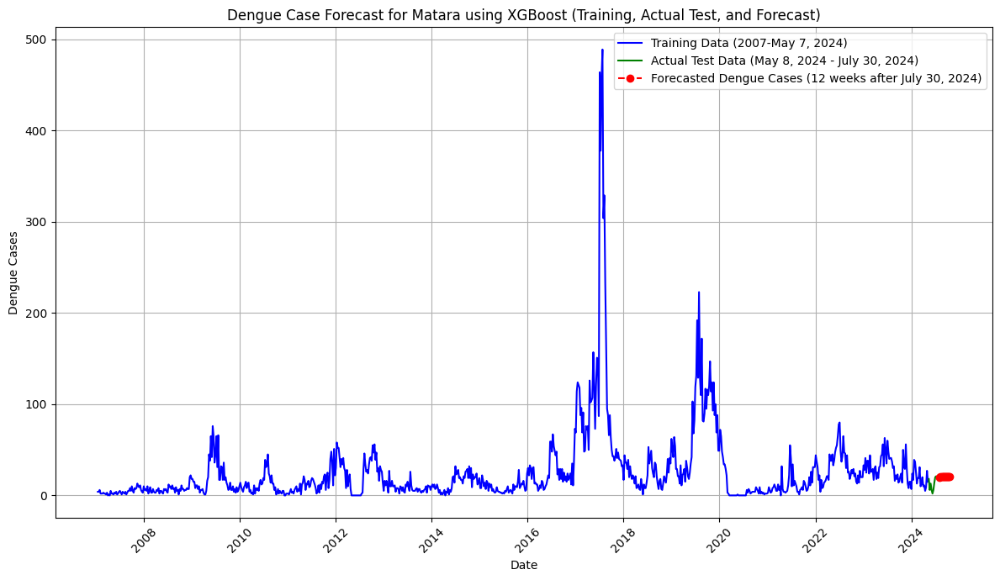


Evaluating LightGBM for district Matara...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 729
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 25.815265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

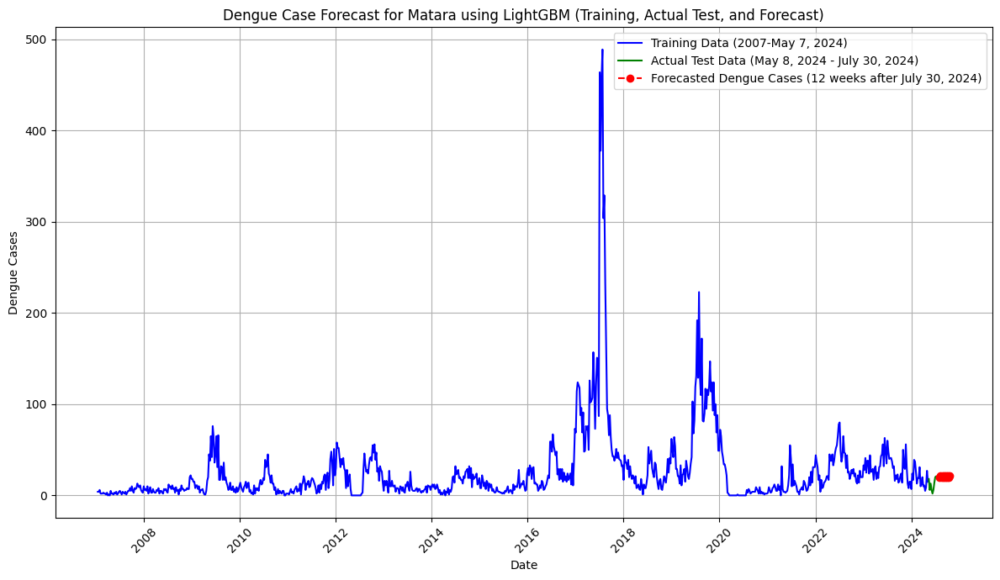


Evaluating CatBoost for district Matara...


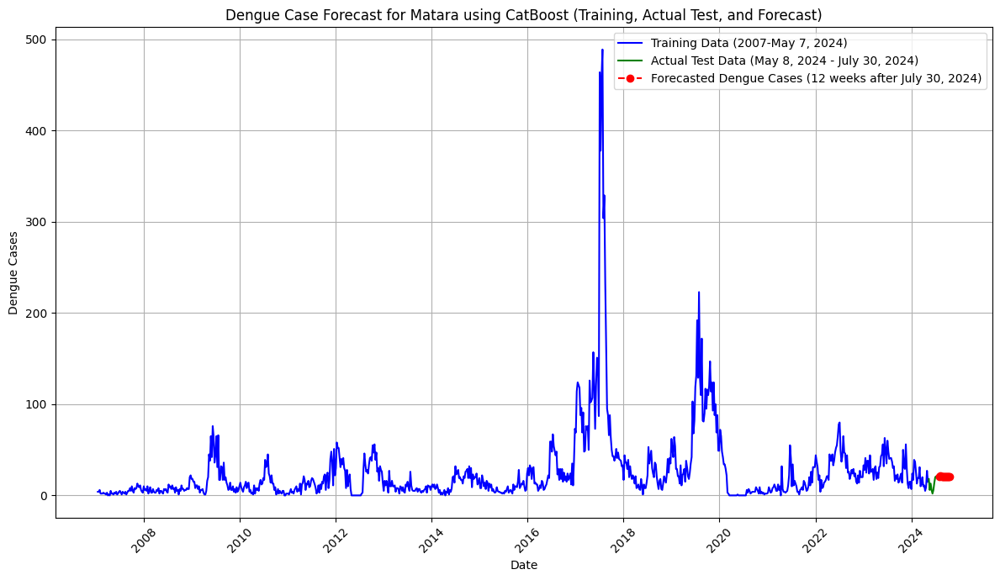


Evaluating RandomForest for district Matara...


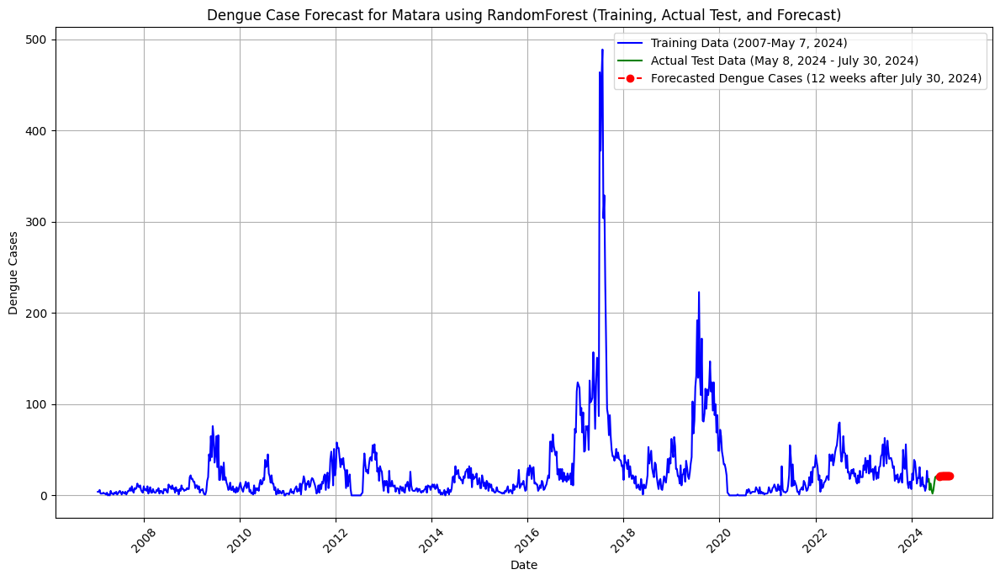


Evaluating GradientBoosting for district Anuradhapura...


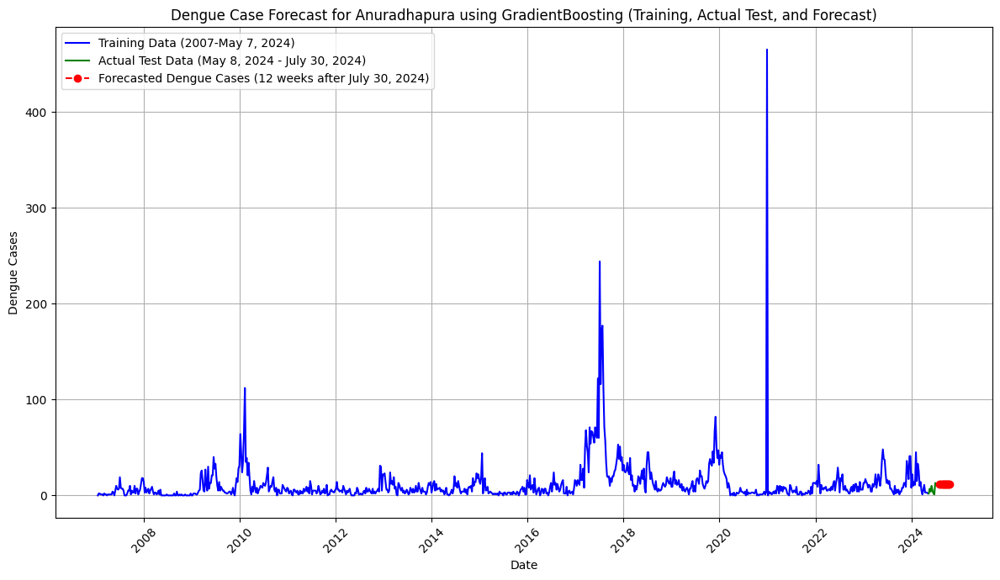


Evaluating XGBoost for district Anuradhapura...


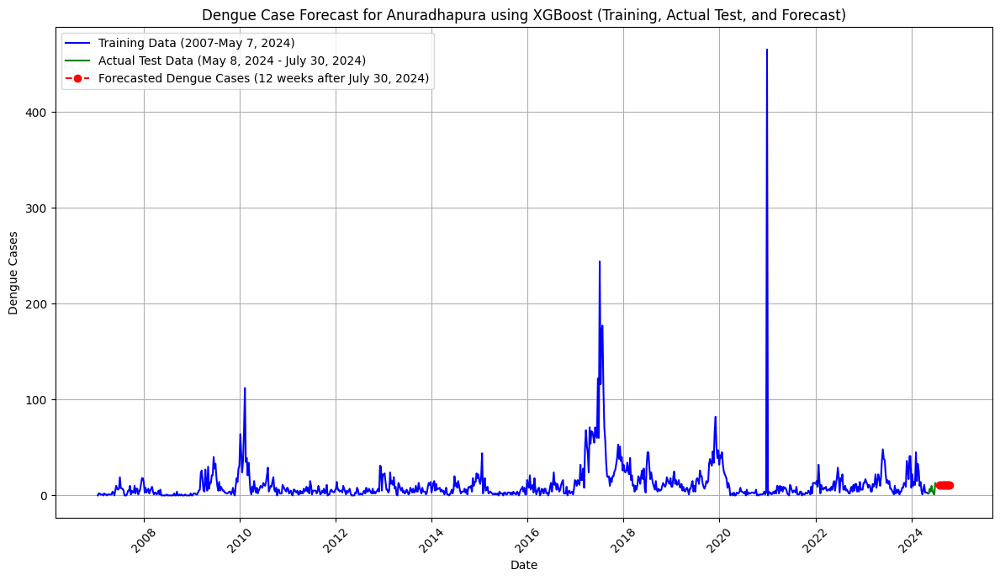


Evaluating LightGBM for district Anuradhapura...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 656
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 11.910398
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

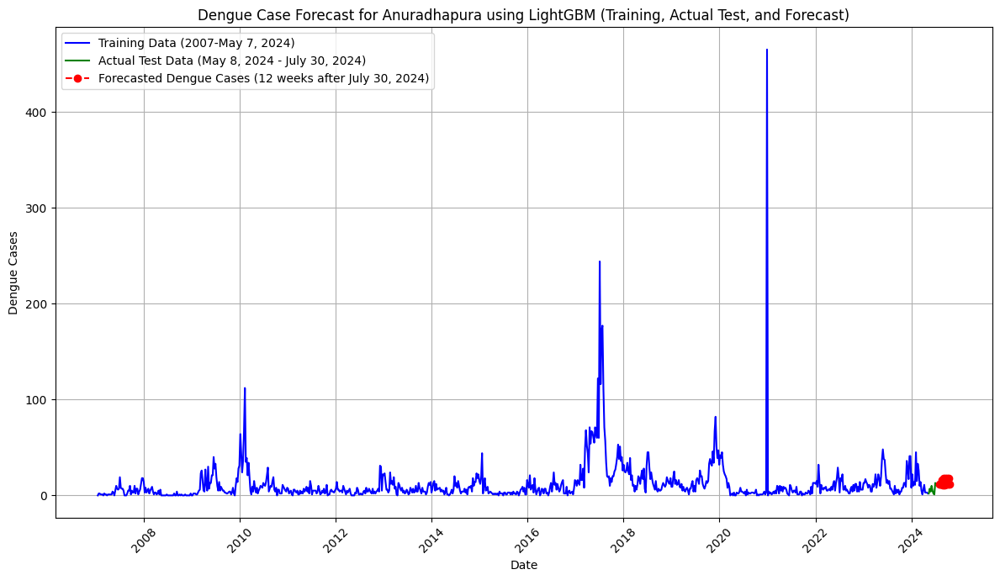


Evaluating CatBoost for district Anuradhapura...


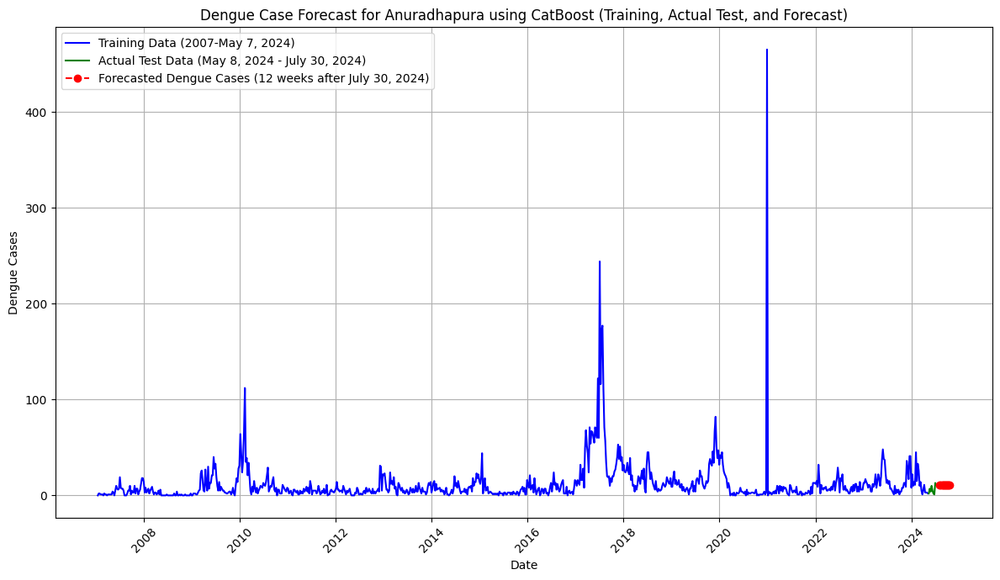


Evaluating RandomForest for district Anuradhapura...


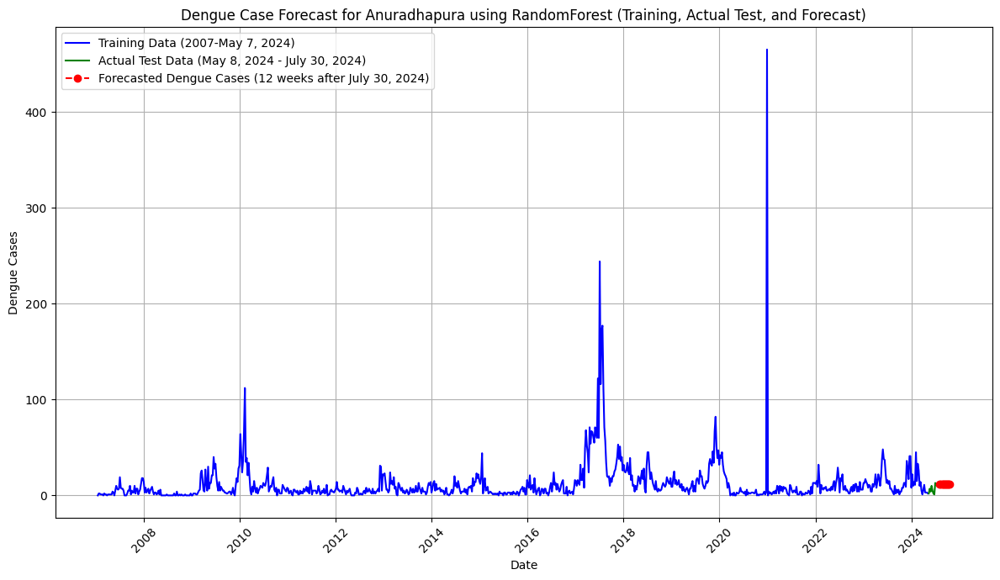


Evaluating GradientBoosting for district NuwaraEliya...


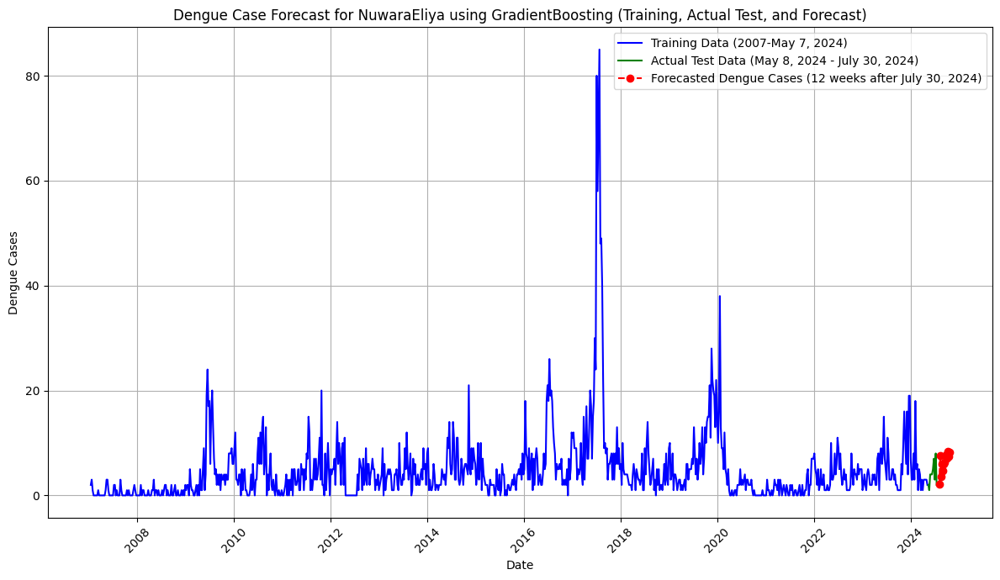


Evaluating XGBoost for district NuwaraEliya...


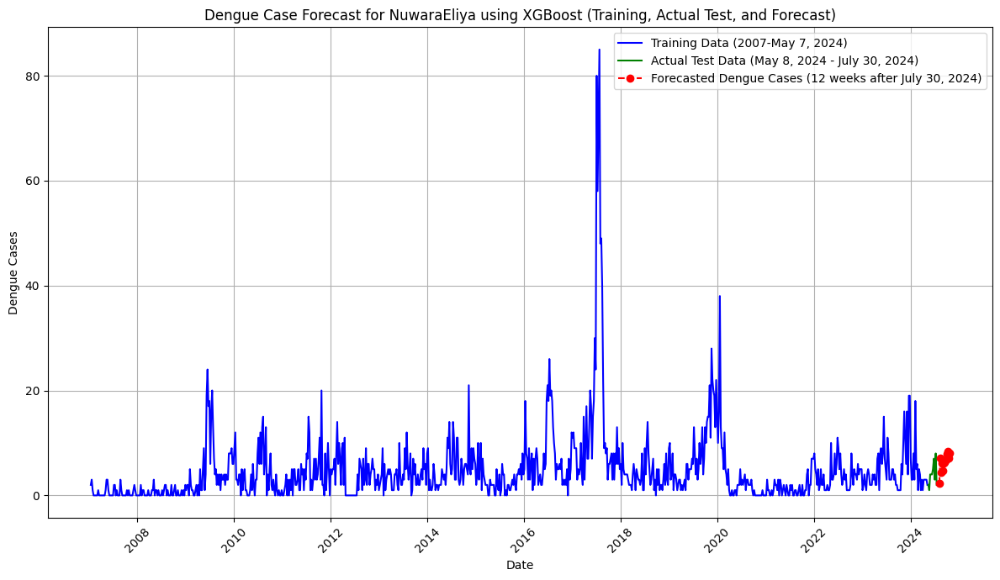


Evaluating LightGBM for district NuwaraEliya...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000123 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 588
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 4.782080
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

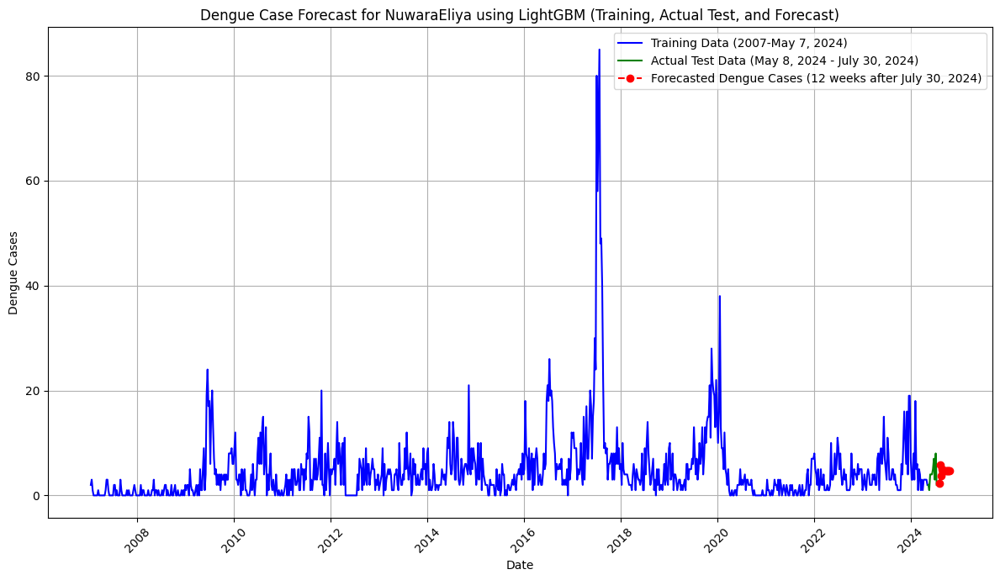


Evaluating CatBoost for district NuwaraEliya...


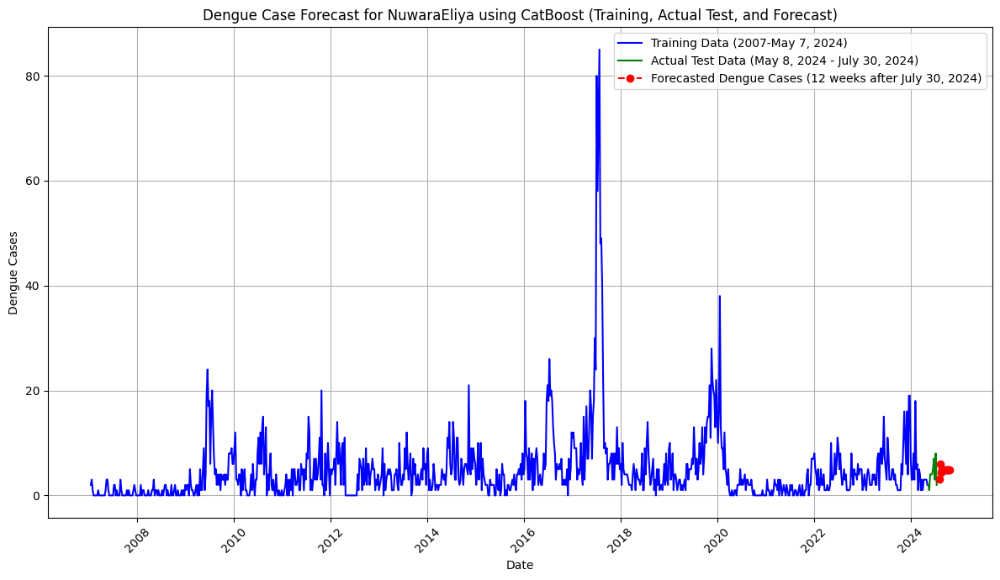


Evaluating RandomForest for district NuwaraEliya...


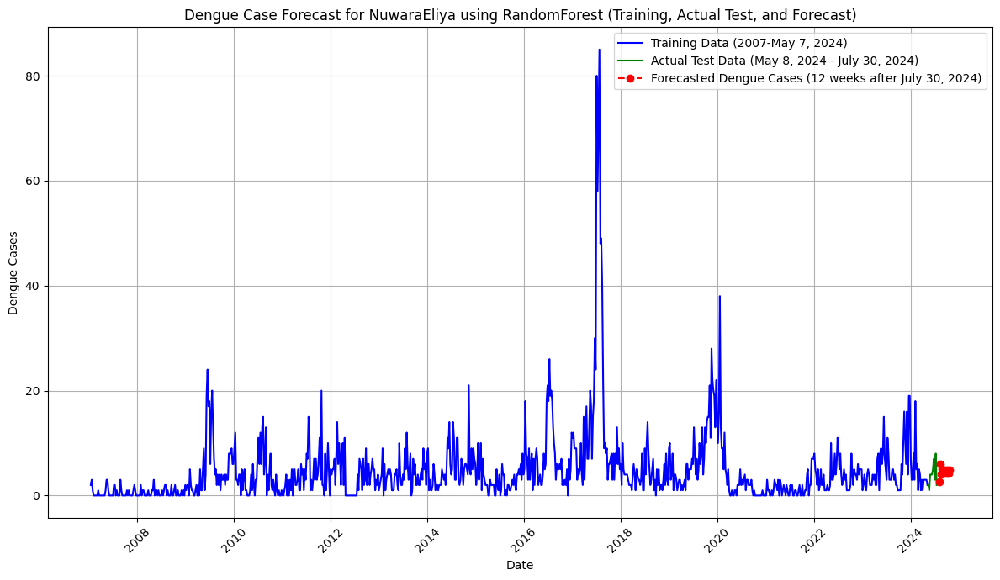


Evaluating GradientBoosting for district Gampaha...


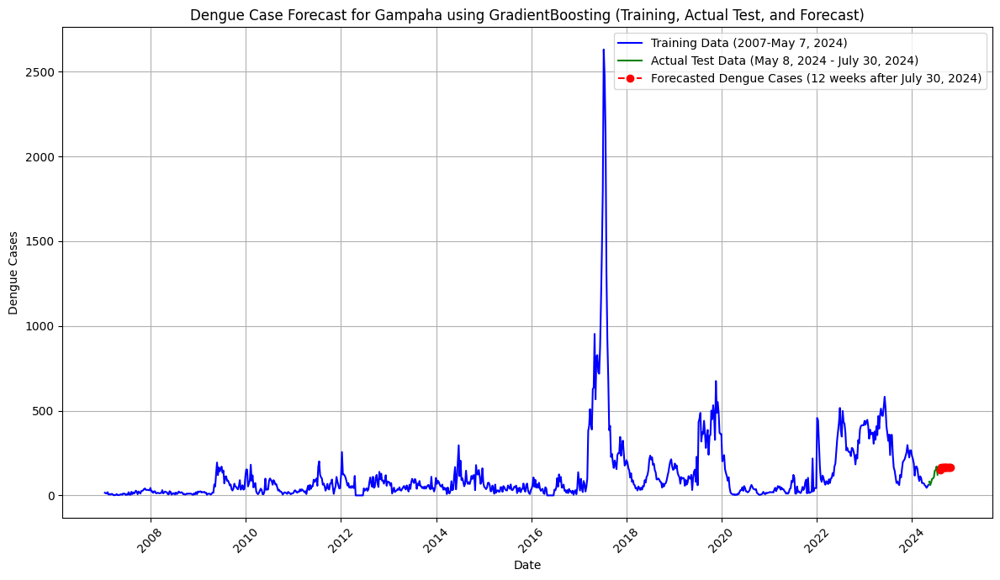


Evaluating XGBoost for district Gampaha...


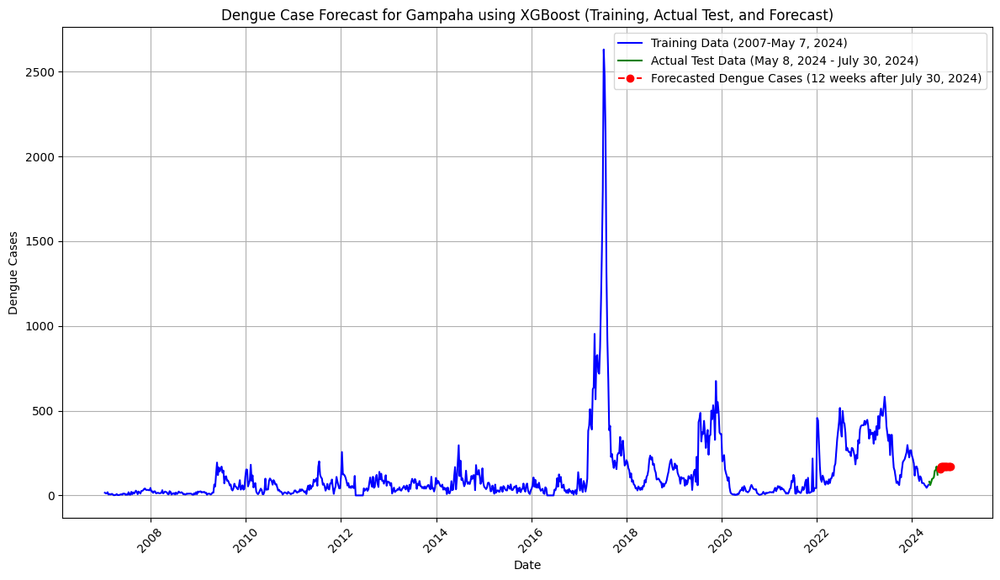


Evaluating LightGBM for district Gampaha...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1006
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 121.407080
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

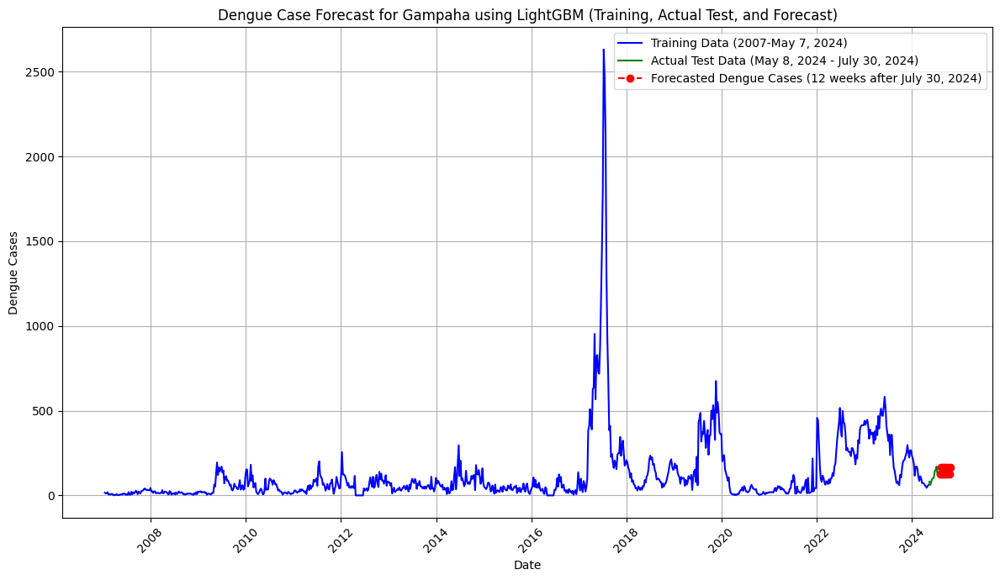


Evaluating CatBoost for district Gampaha...


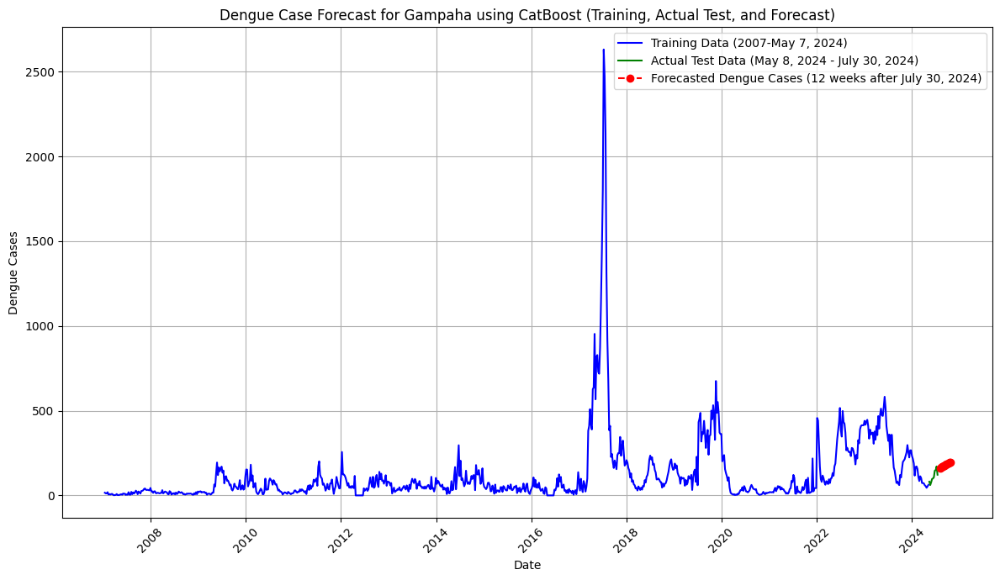


Evaluating RandomForest for district Gampaha...


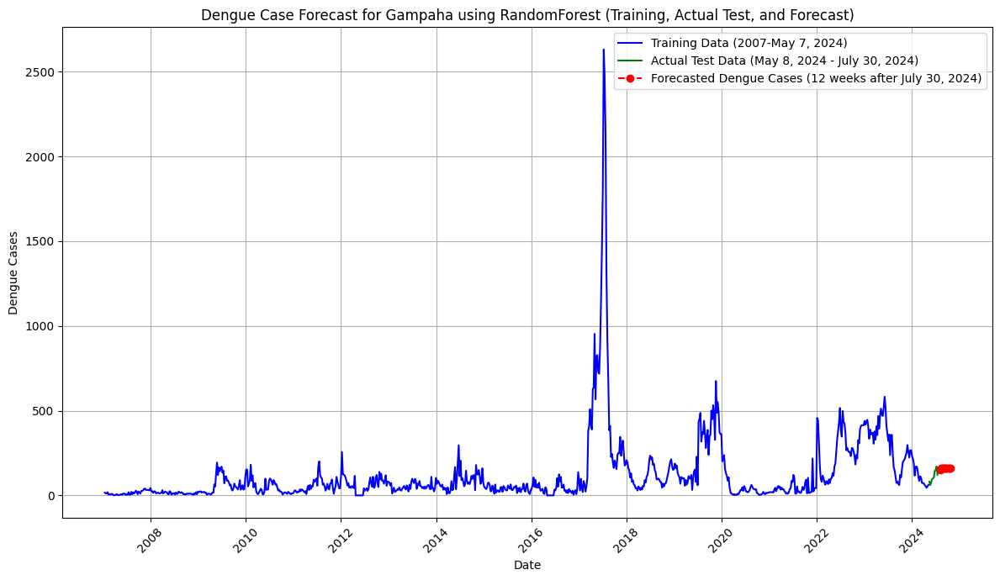


Evaluating GradientBoosting for district Kalutara...


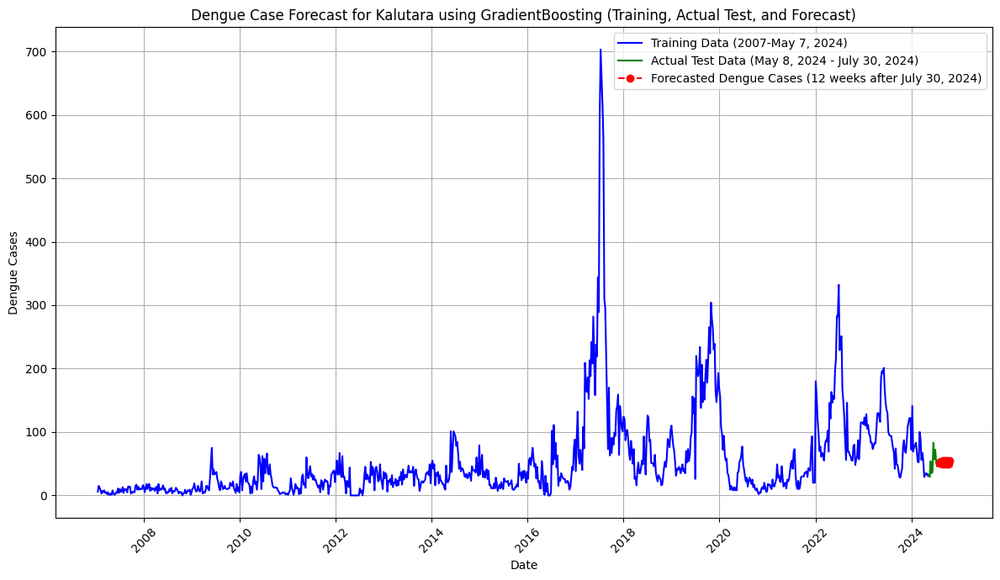


Evaluating XGBoost for district Kalutara...


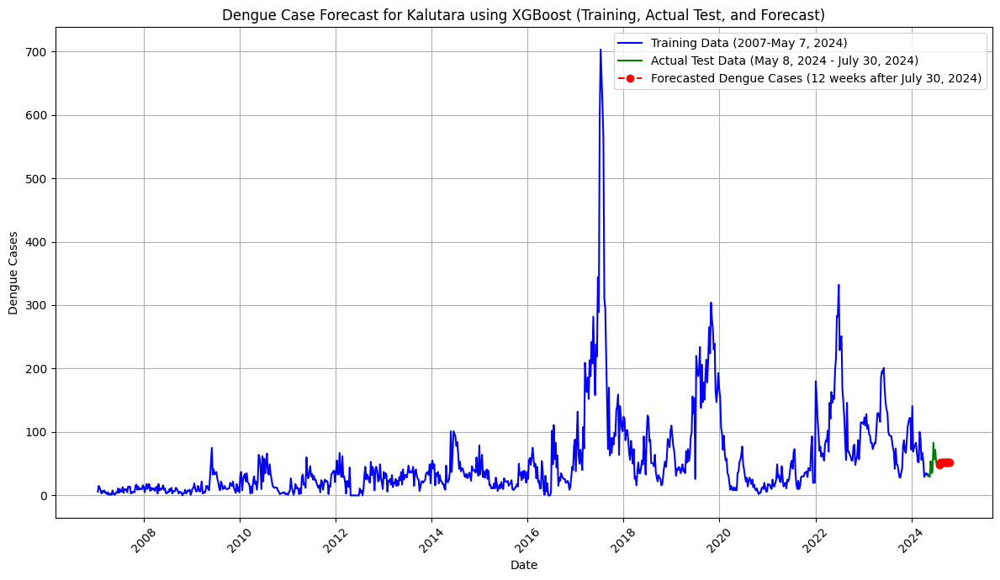


Evaluating LightGBM for district Kalutara...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 880
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 53.372788
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

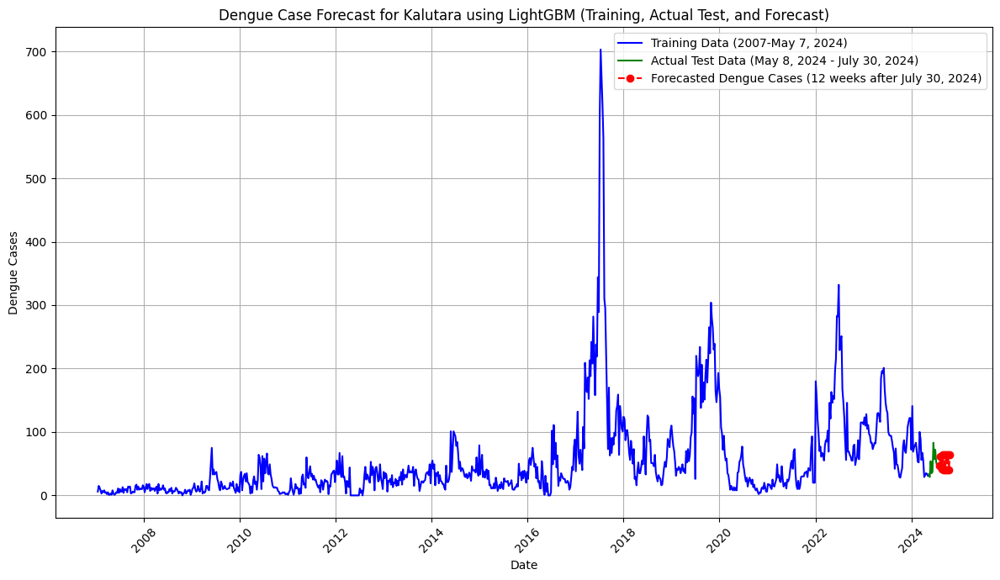


Evaluating CatBoost for district Kalutara...


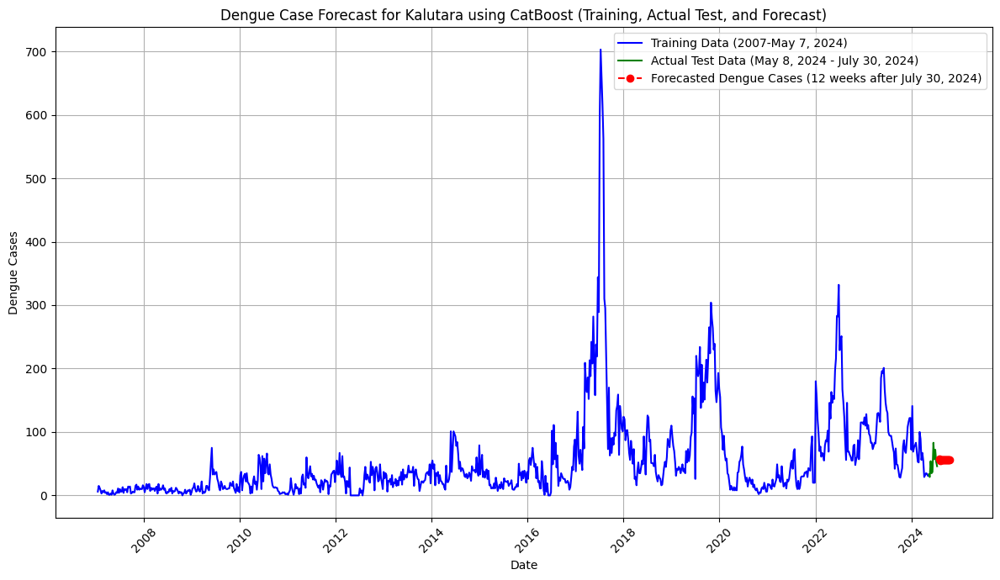


Evaluating RandomForest for district Kalutara...


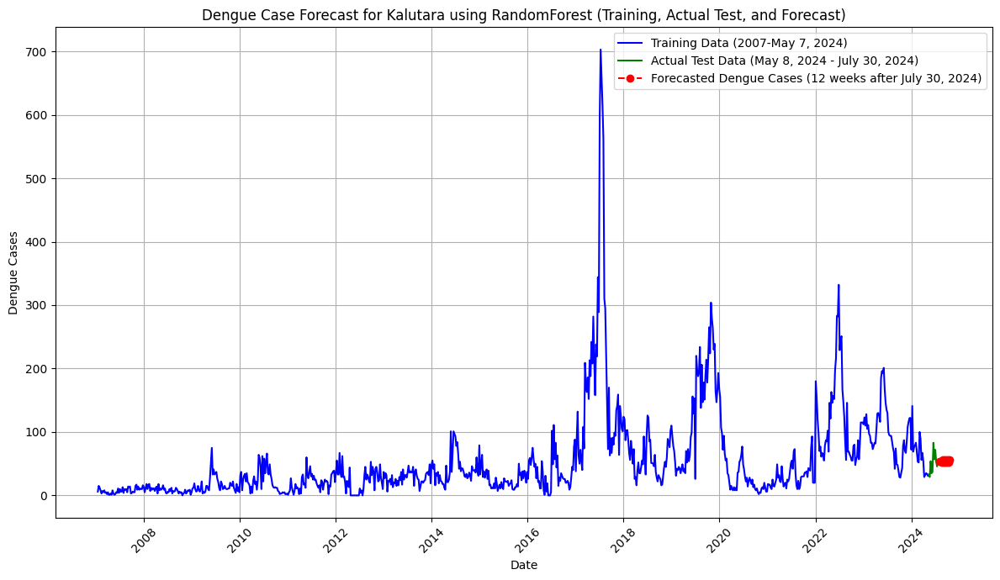


Evaluating GradientBoosting for district Monaragala...


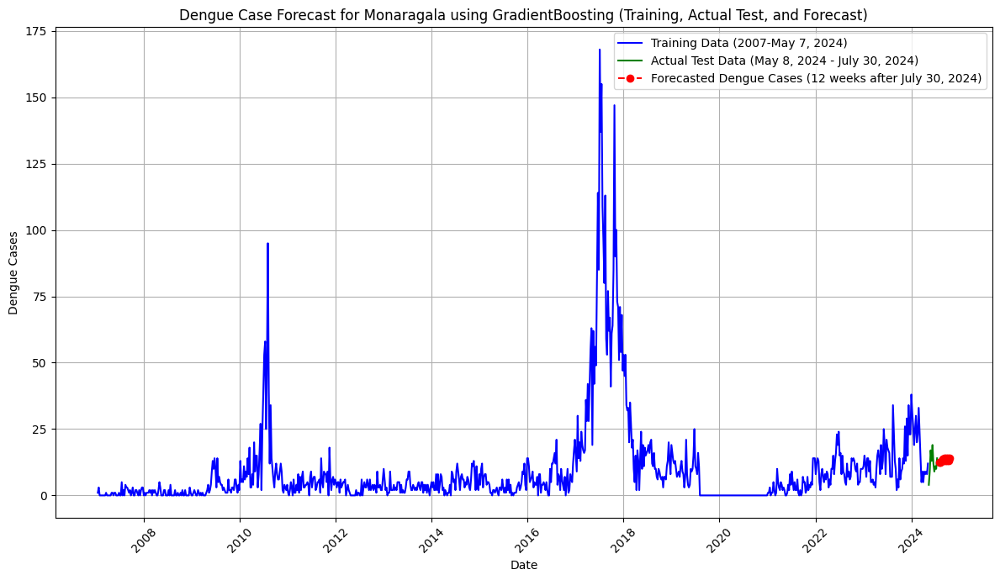


Evaluating XGBoost for district Monaragala...


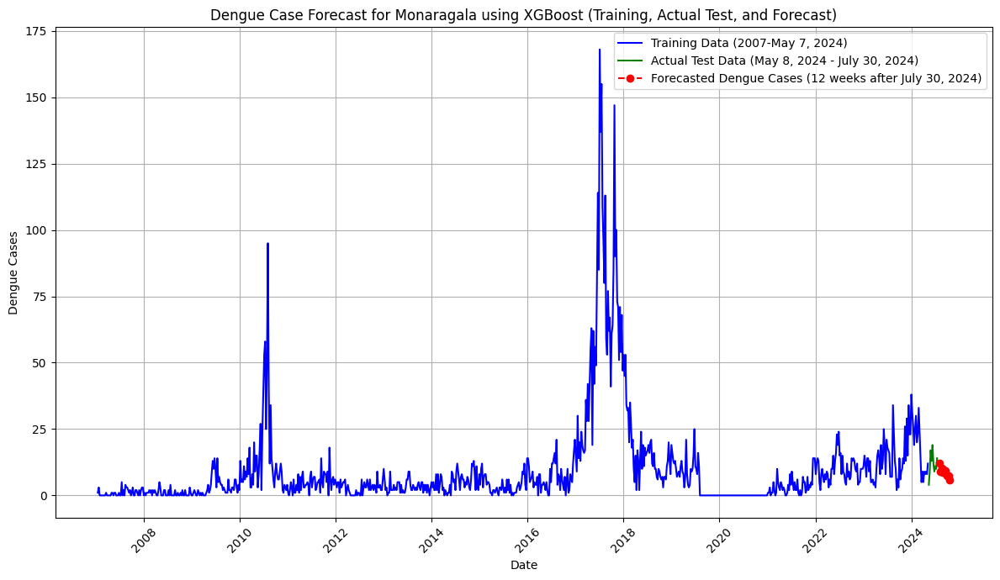


Evaluating LightGBM for district Monaragala...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 9.494469
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

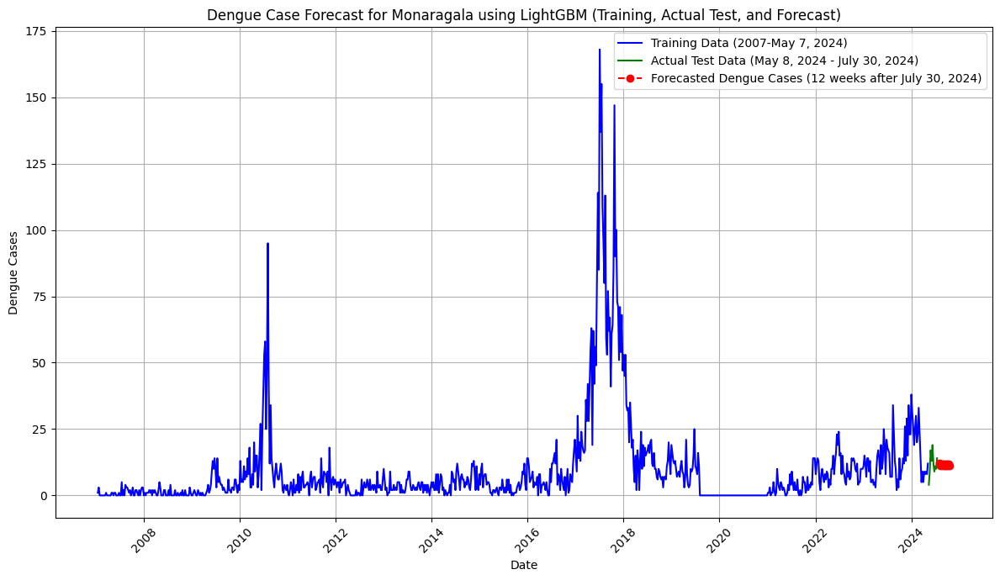


Evaluating CatBoost for district Monaragala...


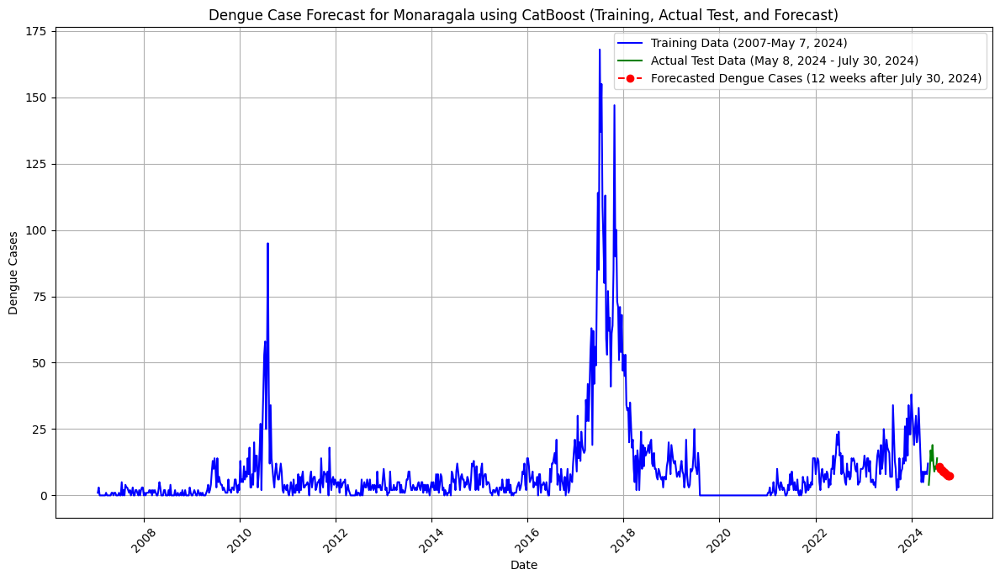


Evaluating RandomForest for district Monaragala...


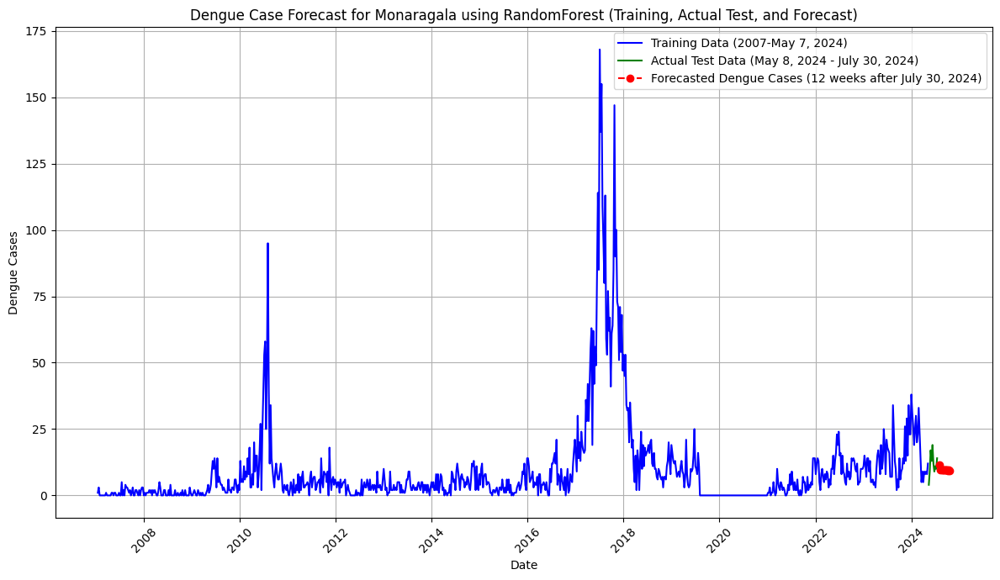


Evaluating GradientBoosting for district Polonnaruwa...


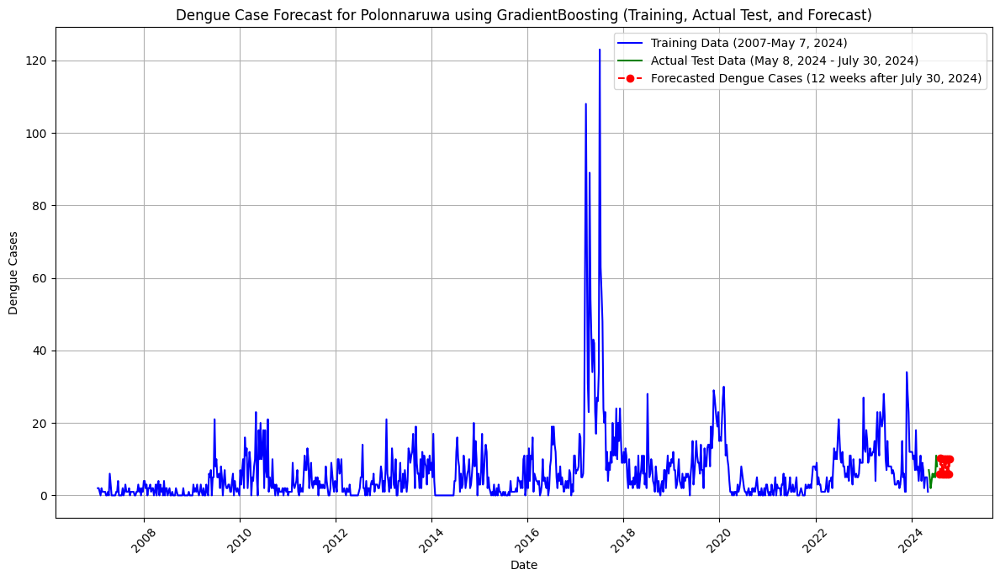


Evaluating XGBoost for district Polonnaruwa...


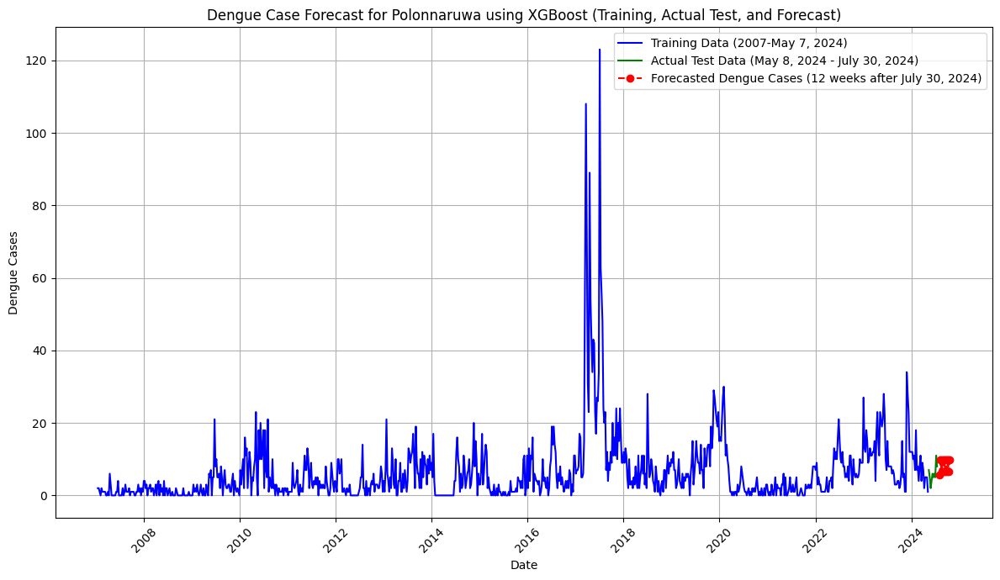


Evaluating LightGBM for district Polonnaruwa...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 602
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 6.379425
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

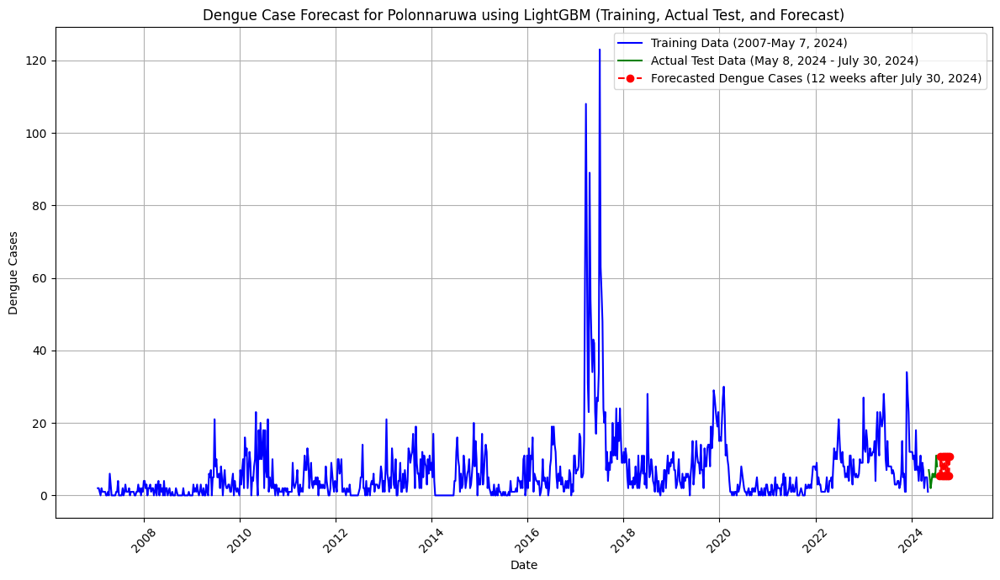


Evaluating CatBoost for district Polonnaruwa...


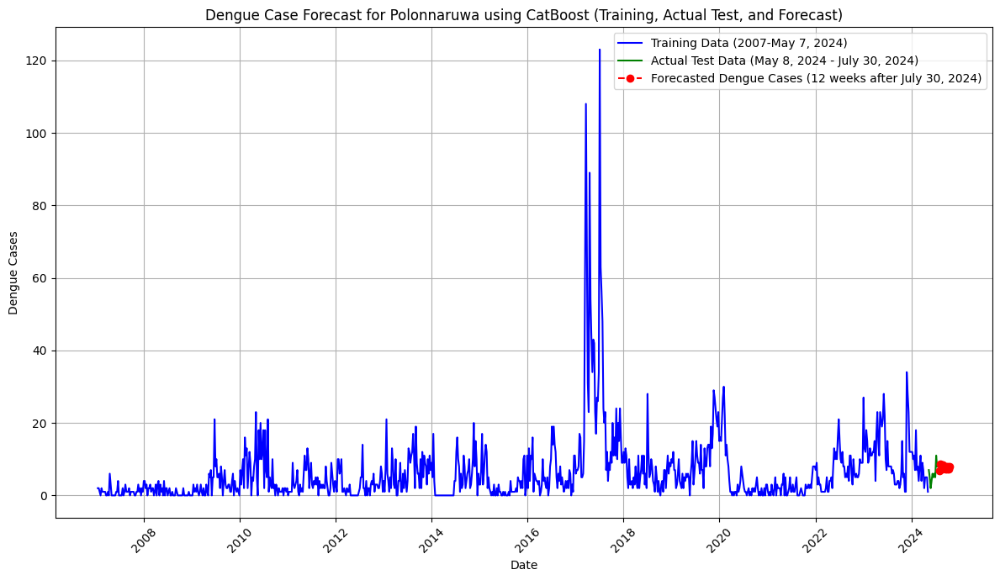


Evaluating RandomForest for district Polonnaruwa...


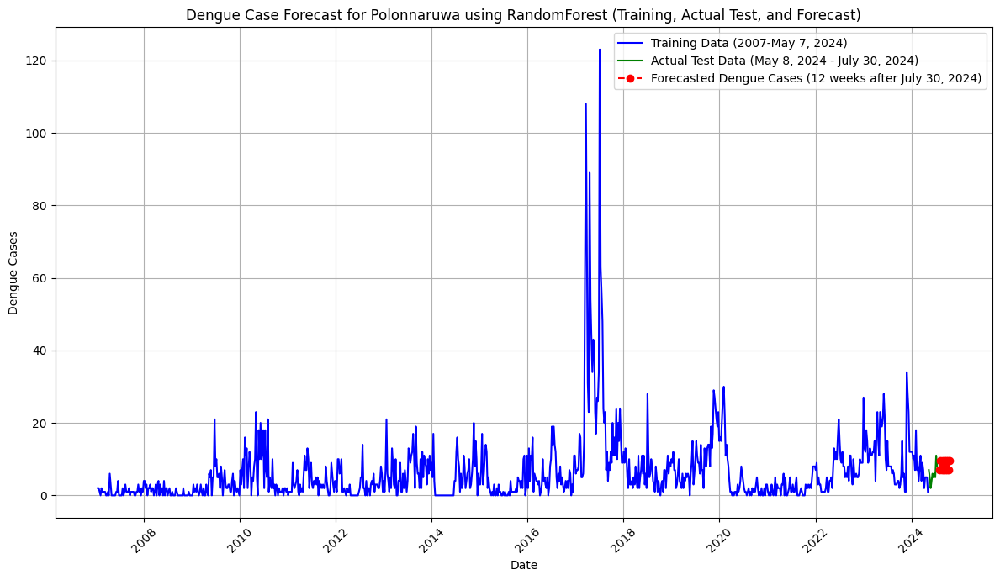


Evaluating GradientBoosting for district Kilinochchi...


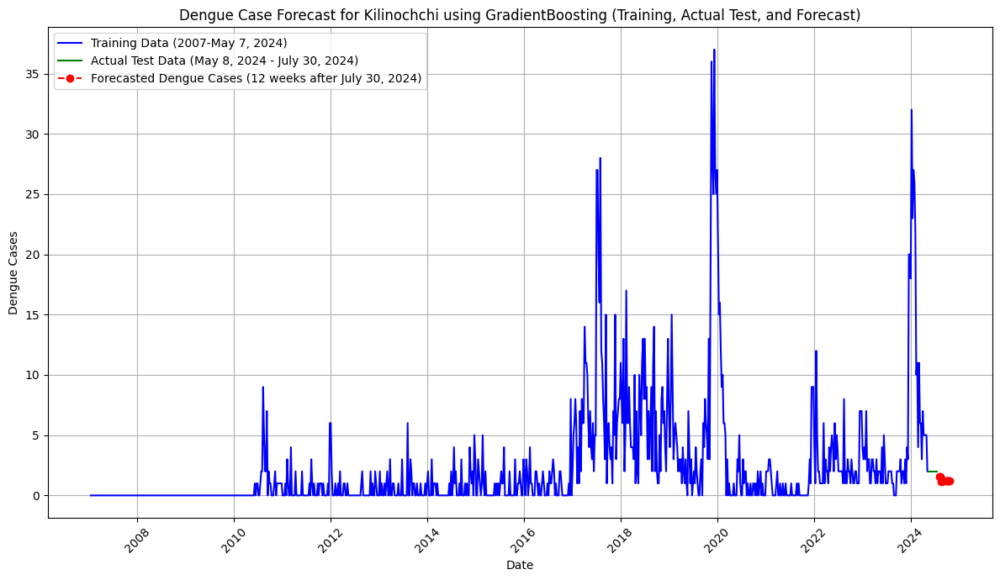


Evaluating XGBoost for district Kilinochchi...


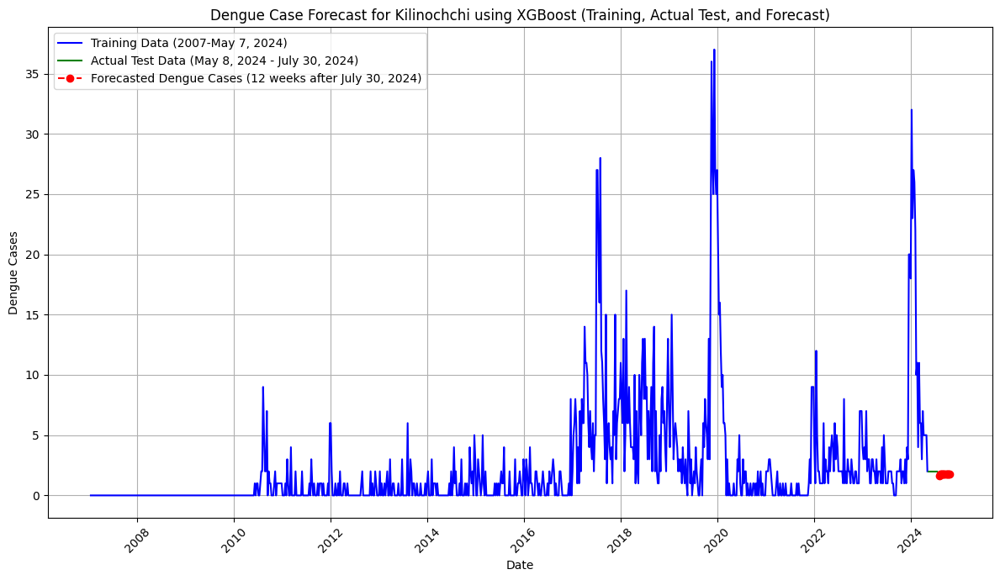


Evaluating LightGBM for district Kilinochchi...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 571
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 2.348451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

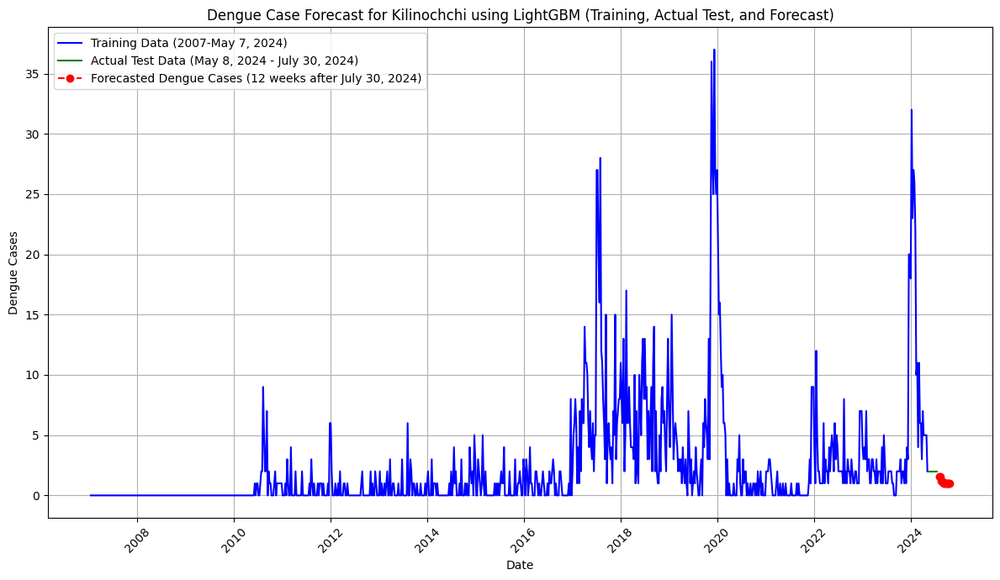


Evaluating CatBoost for district Kilinochchi...


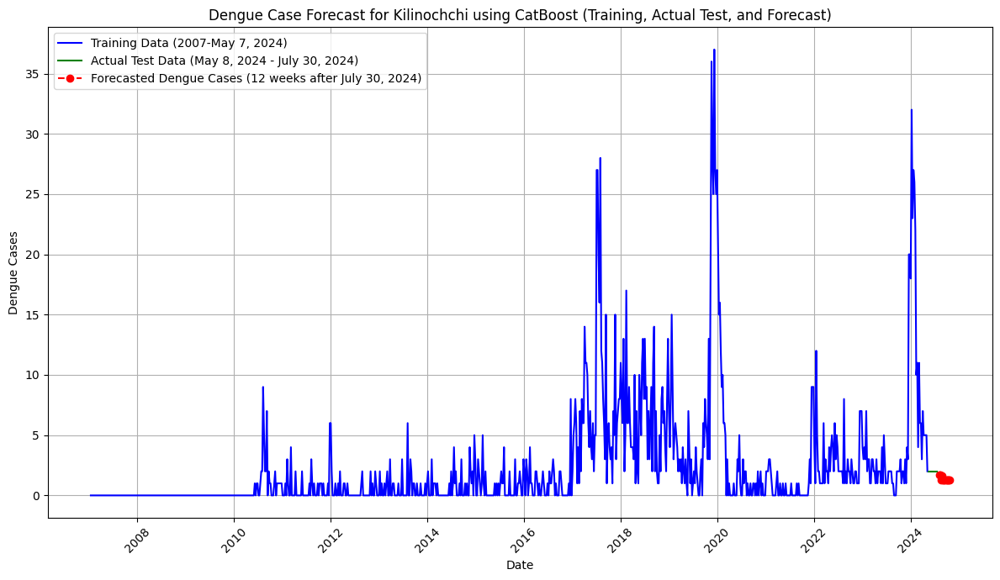


Evaluating RandomForest for district Kilinochchi...


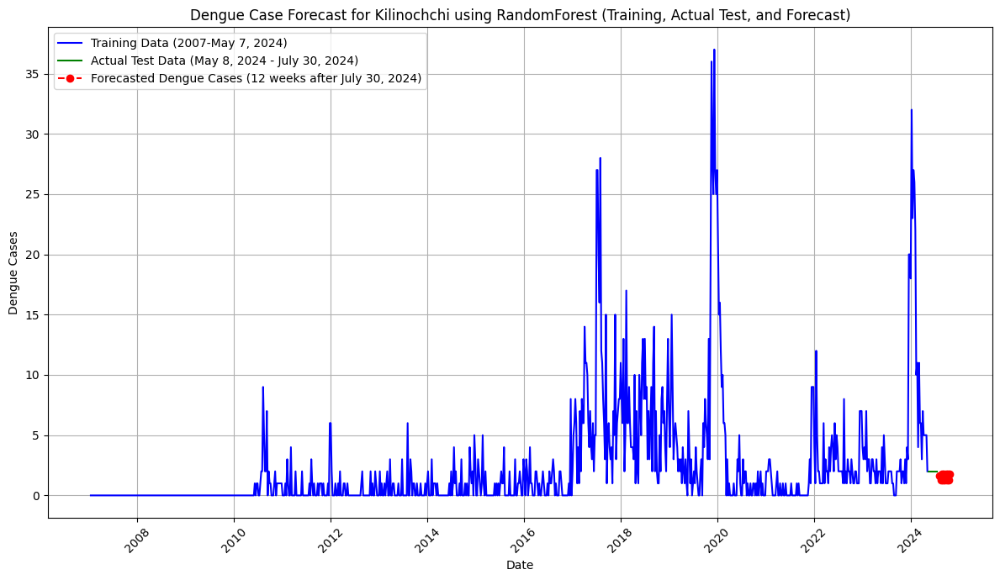


Evaluating GradientBoosting for district Kandy...


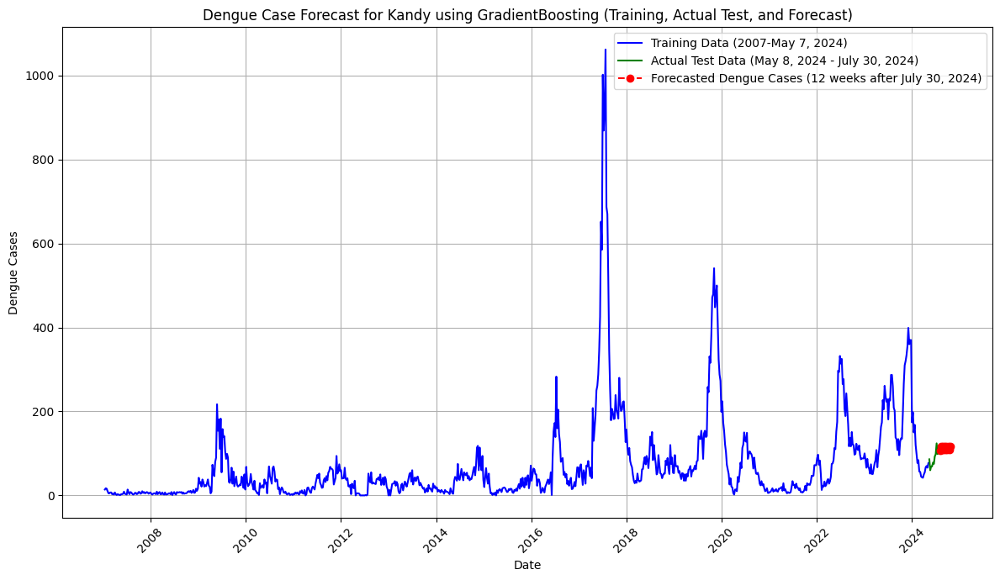


Evaluating XGBoost for district Kandy...


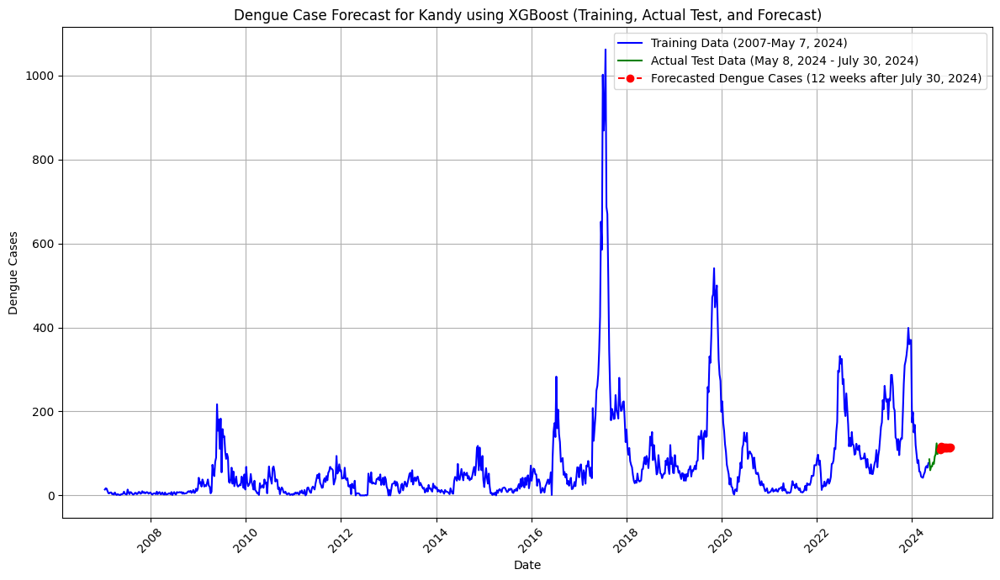


Evaluating LightGBM for district Kandy...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 905
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 70.898230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

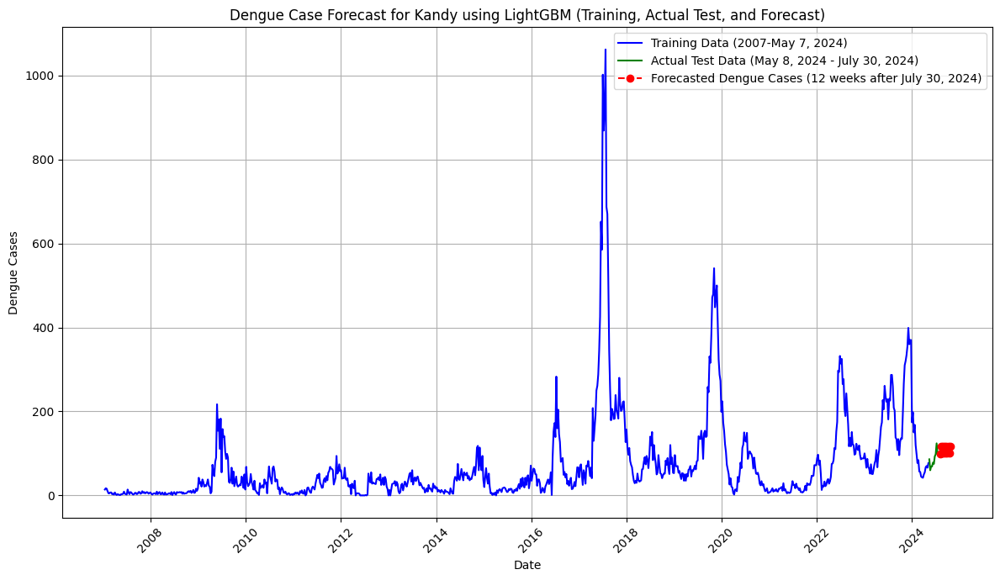


Evaluating CatBoost for district Kandy...


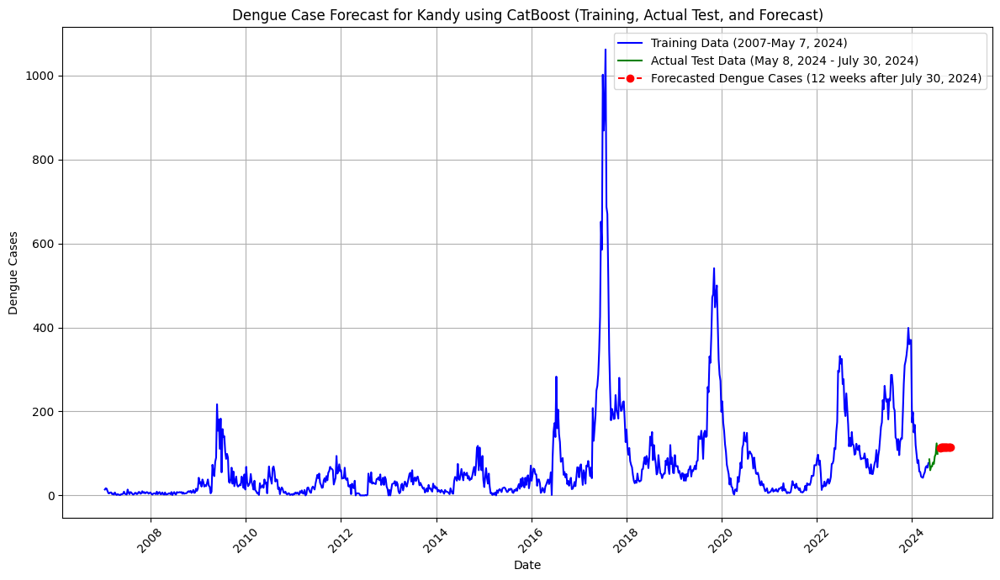


Evaluating RandomForest for district Kandy...


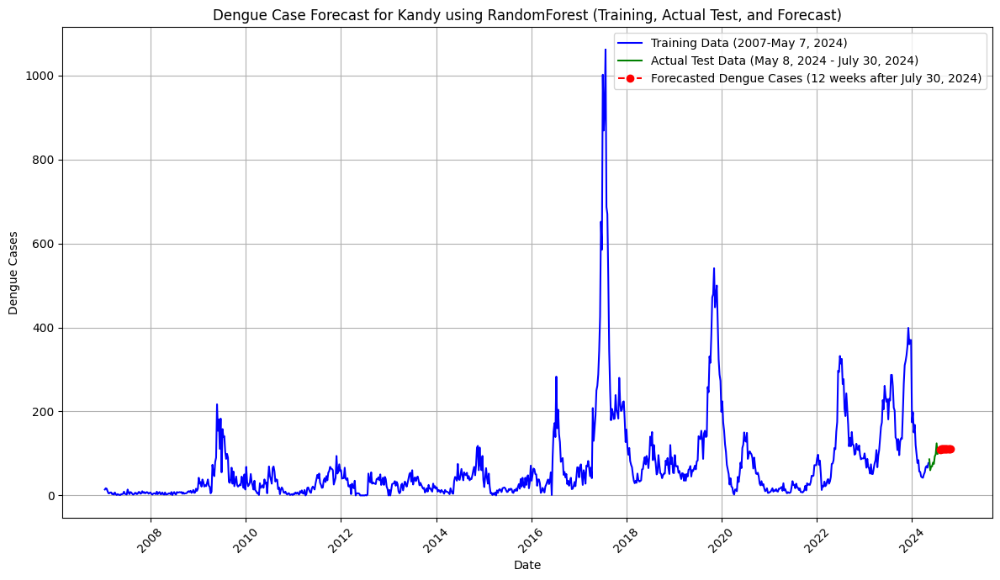


Evaluating GradientBoosting for district Ratnapura...


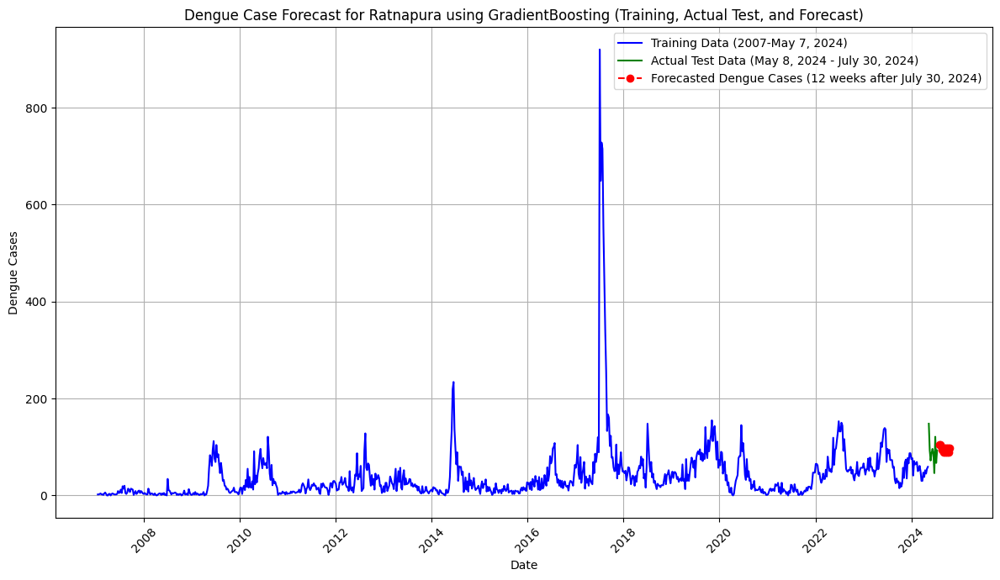


Evaluating XGBoost for district Ratnapura...


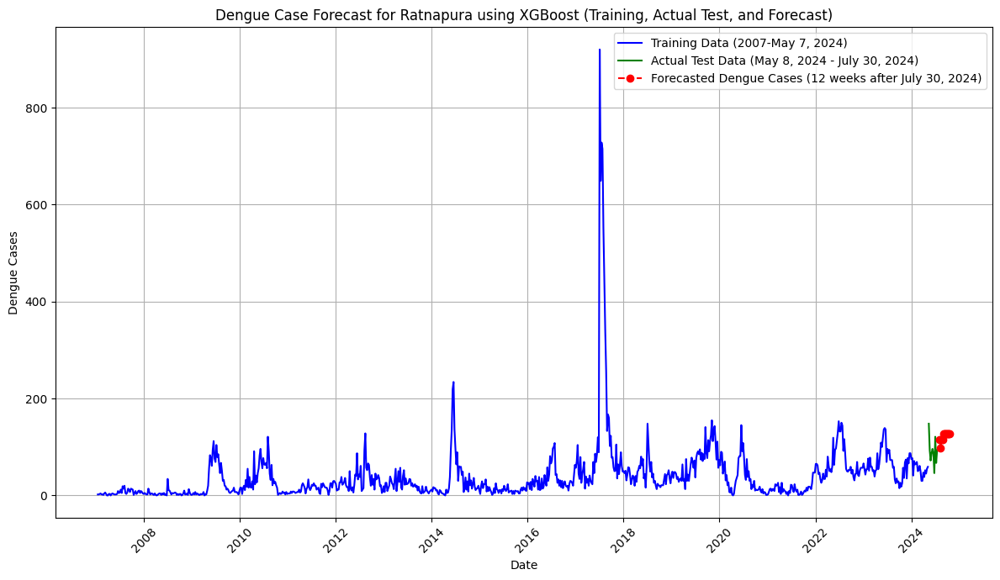


Evaluating LightGBM for district Ratnapura...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 863
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 39.384956
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

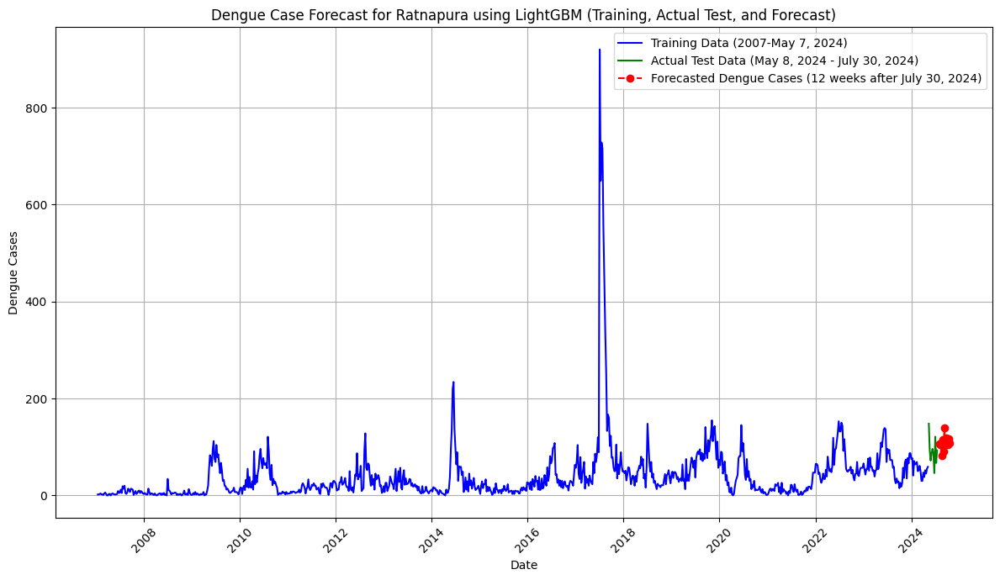


Evaluating CatBoost for district Ratnapura...


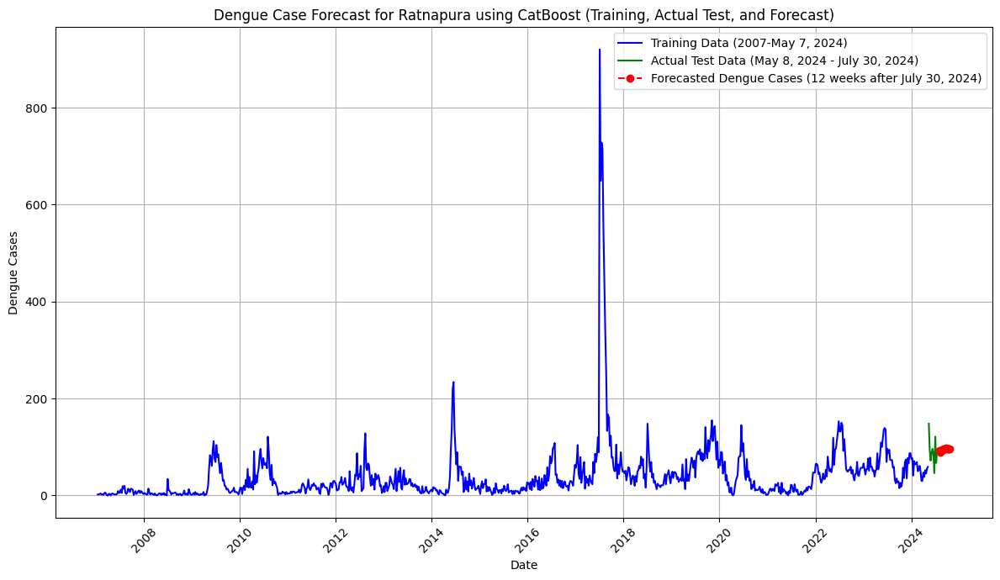


Evaluating RandomForest for district Ratnapura...


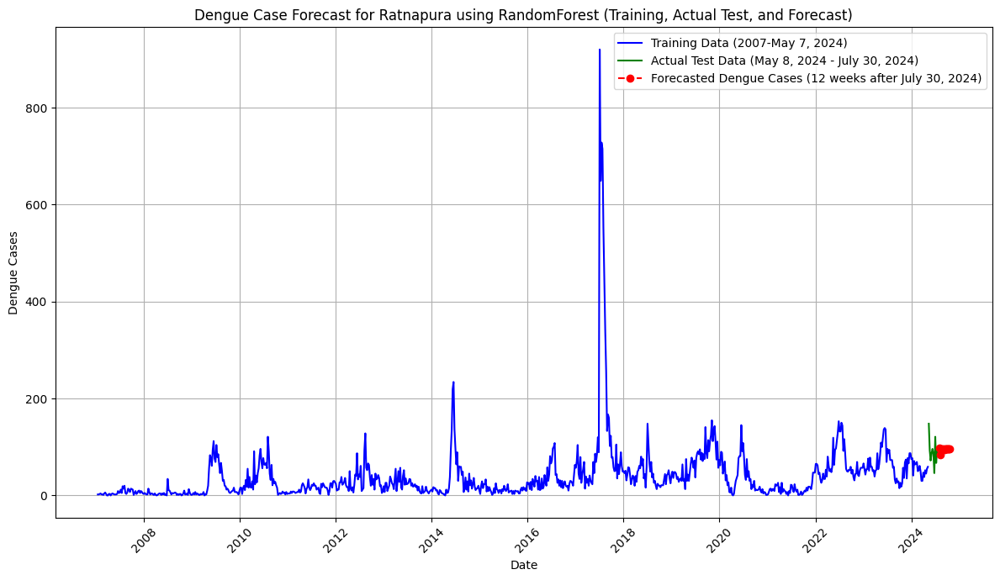


Evaluating GradientBoosting for district Batticaloa...


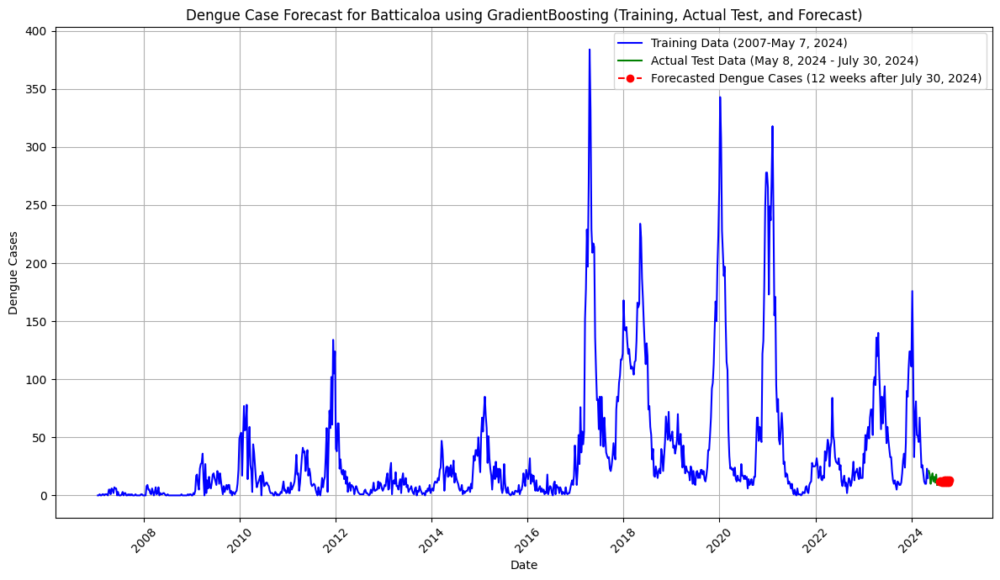


Evaluating XGBoost for district Batticaloa...


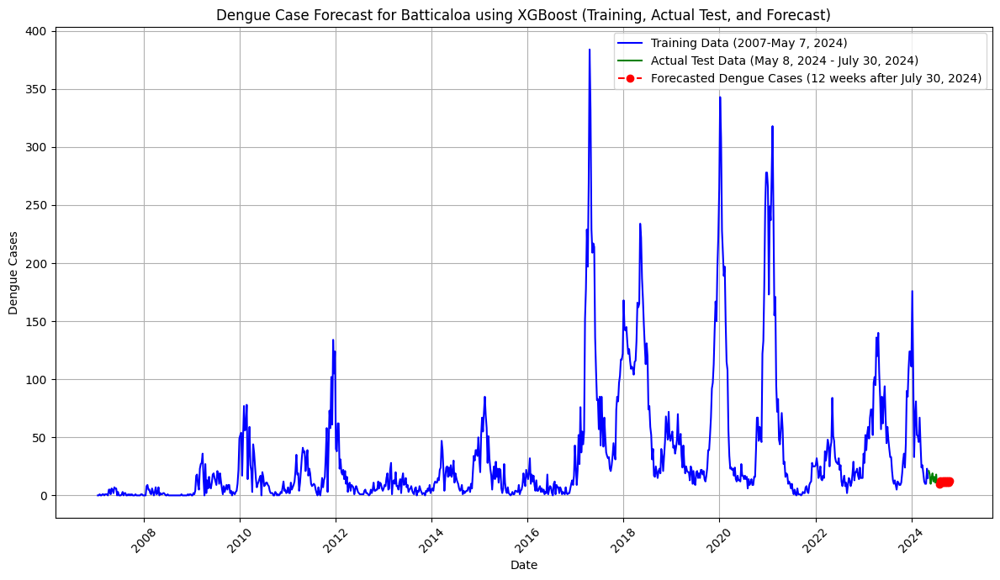


Evaluating LightGBM for district Batticaloa...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 855
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 34.401549
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

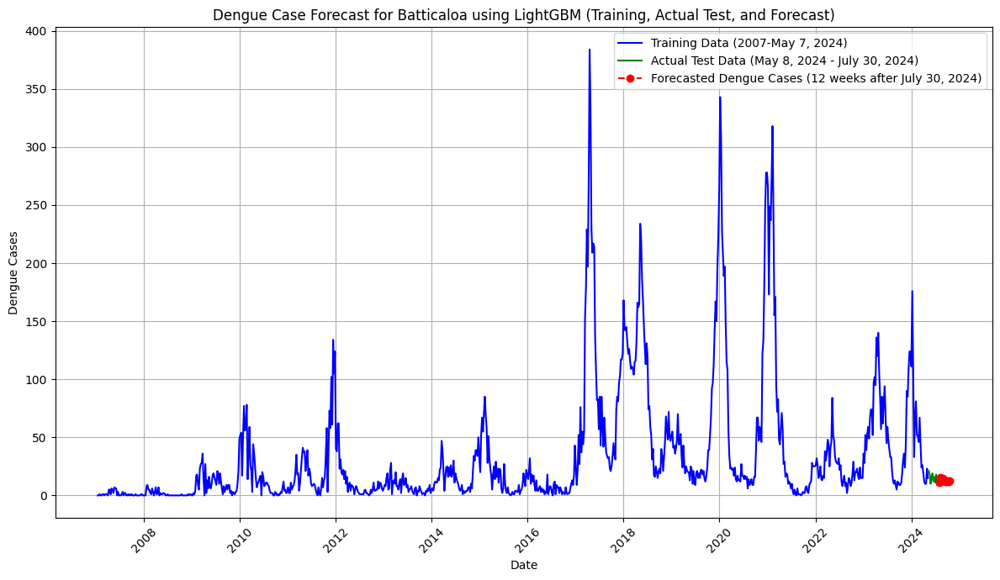


Evaluating CatBoost for district Batticaloa...


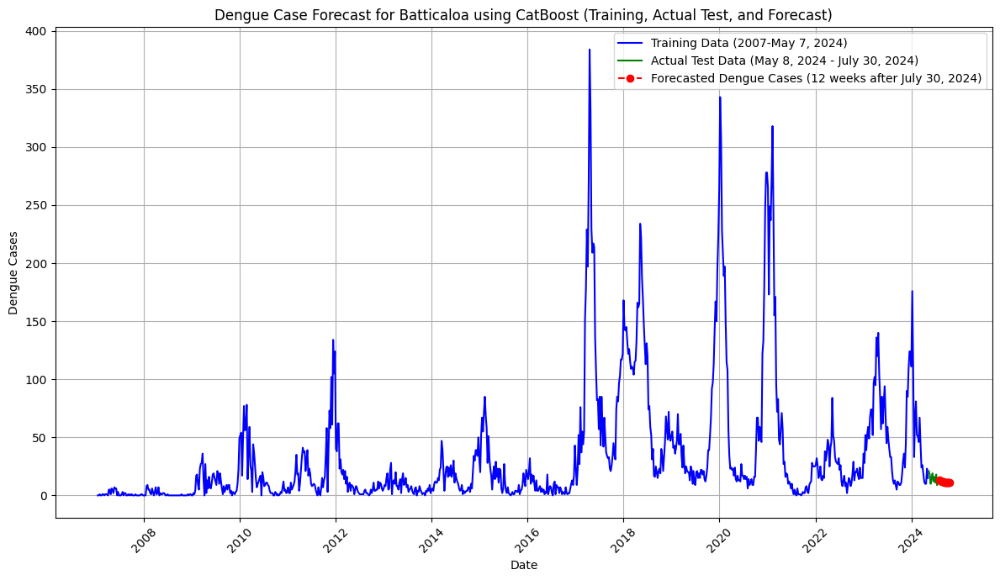


Evaluating RandomForest for district Batticaloa...


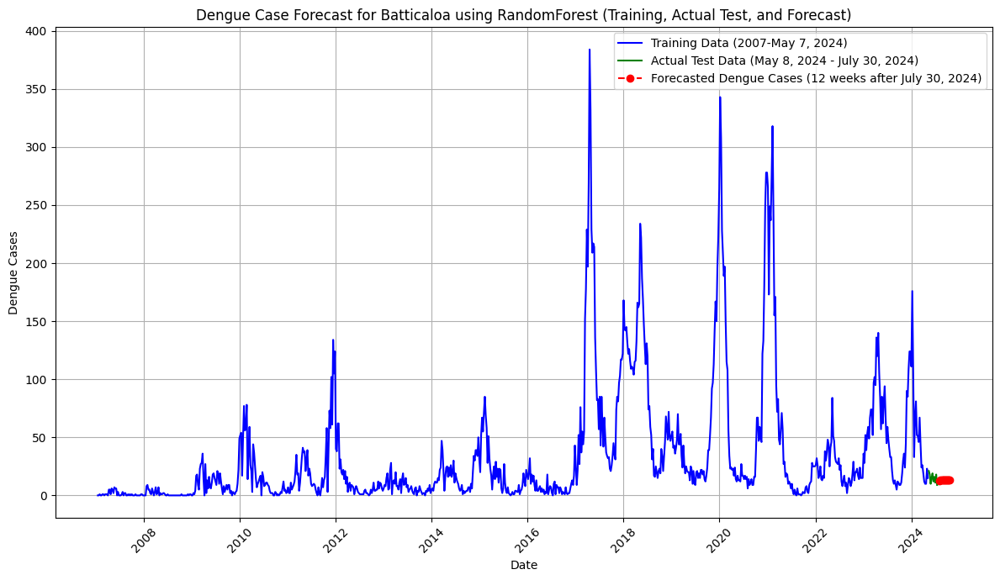


Evaluating GradientBoosting for district Matale...


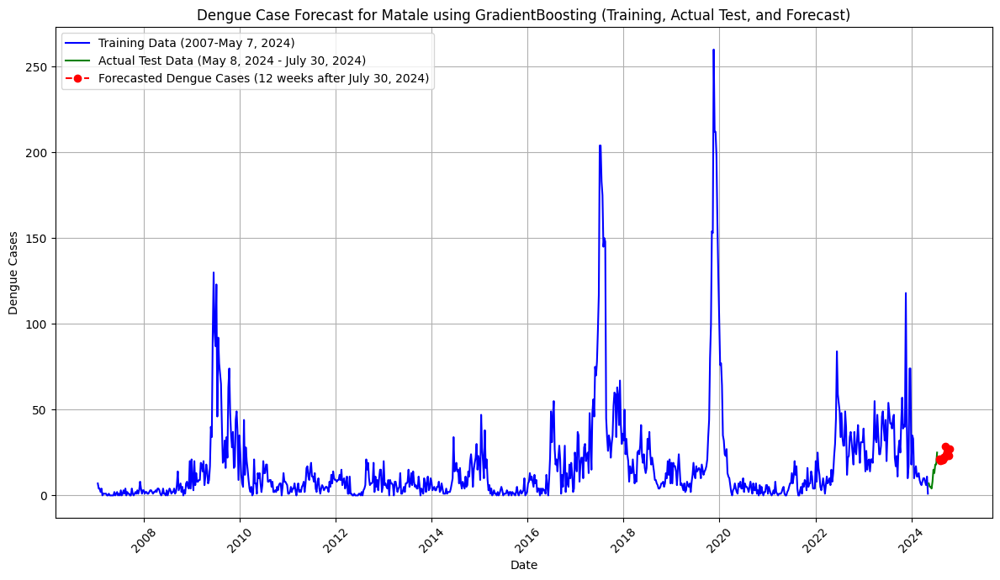


Evaluating XGBoost for district Matale...


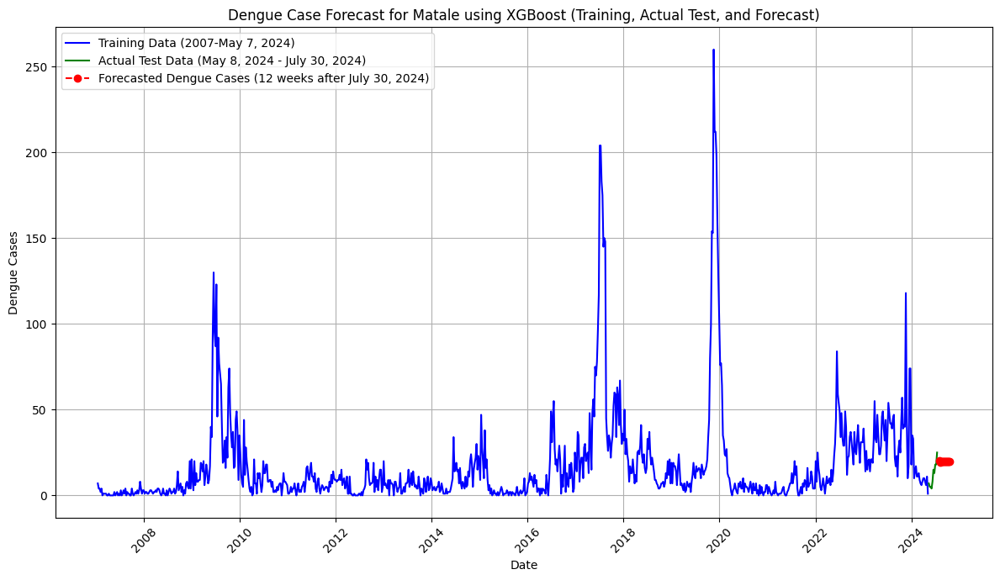


Evaluating LightGBM for district Matale...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 692
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 17.186947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

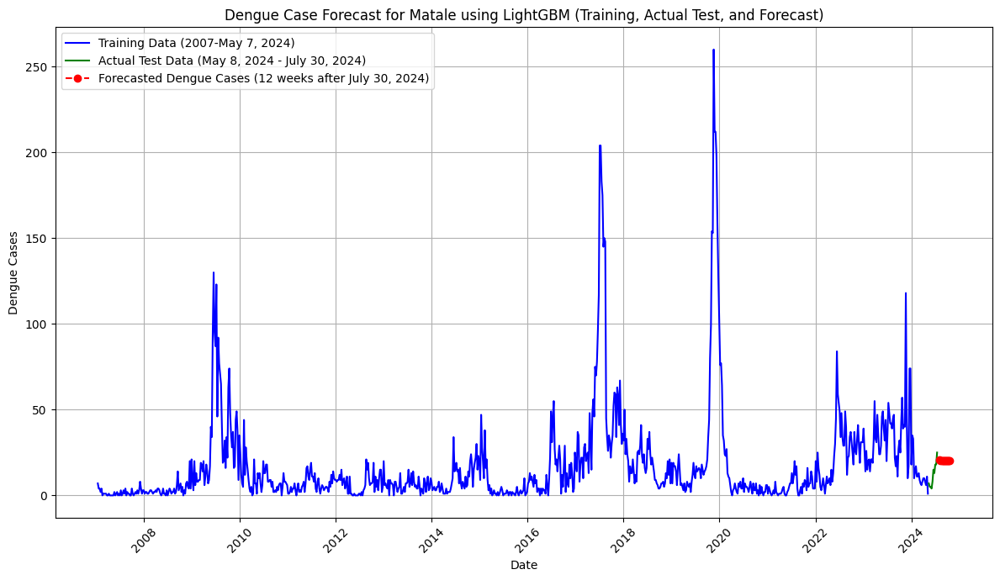


Evaluating CatBoost for district Matale...


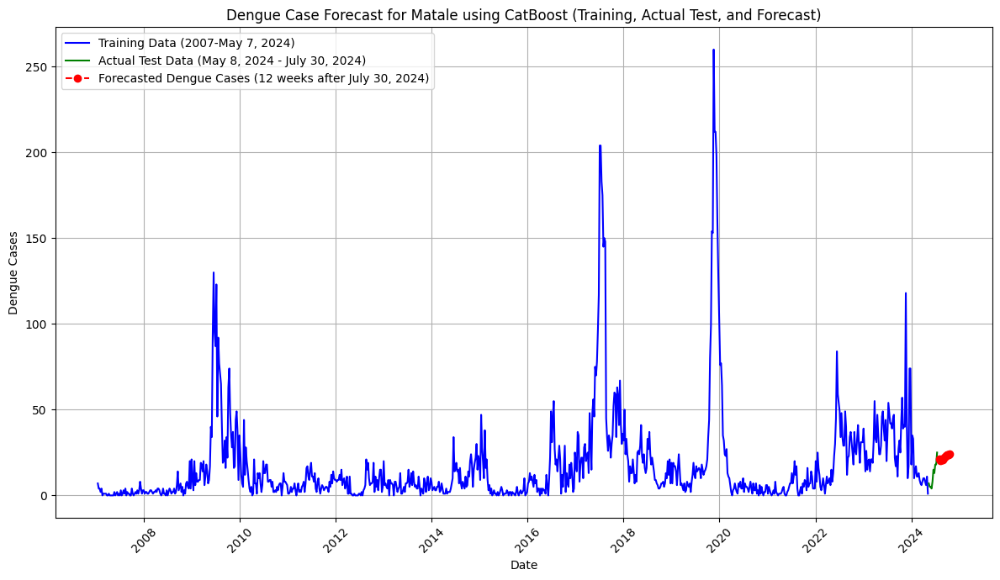


Evaluating RandomForest for district Matale...


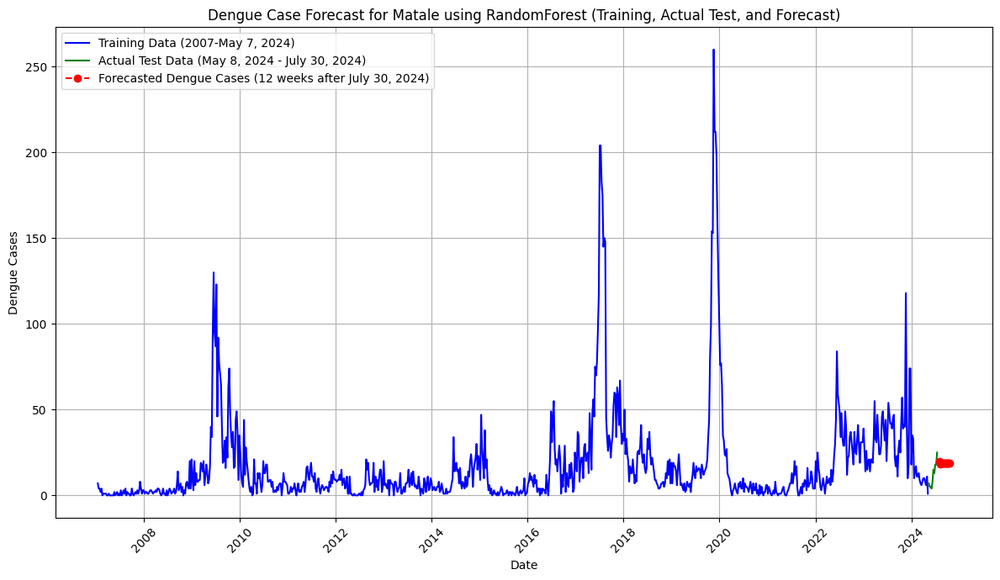


Evaluating GradientBoosting for district Jaffna...


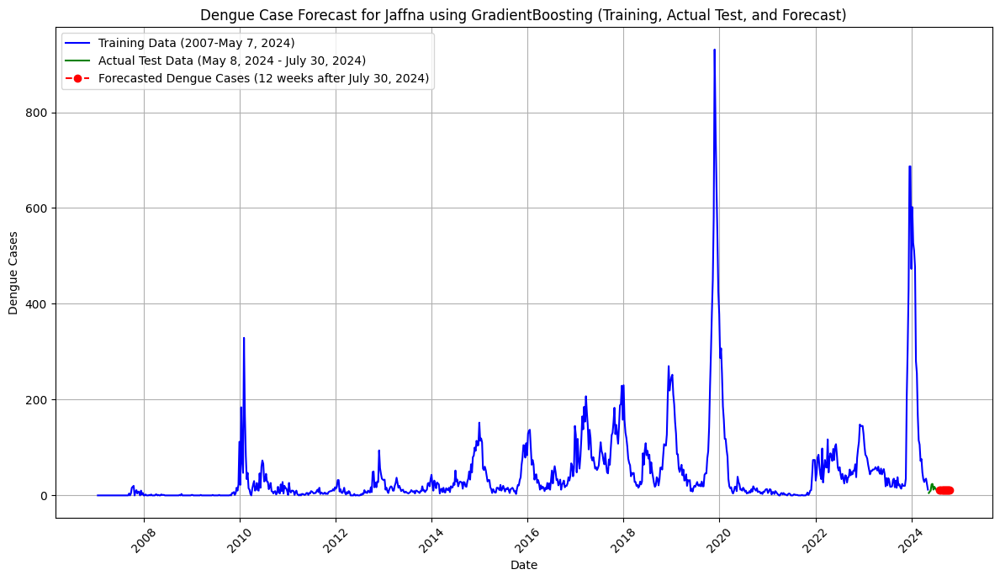


Evaluating XGBoost for district Jaffna...


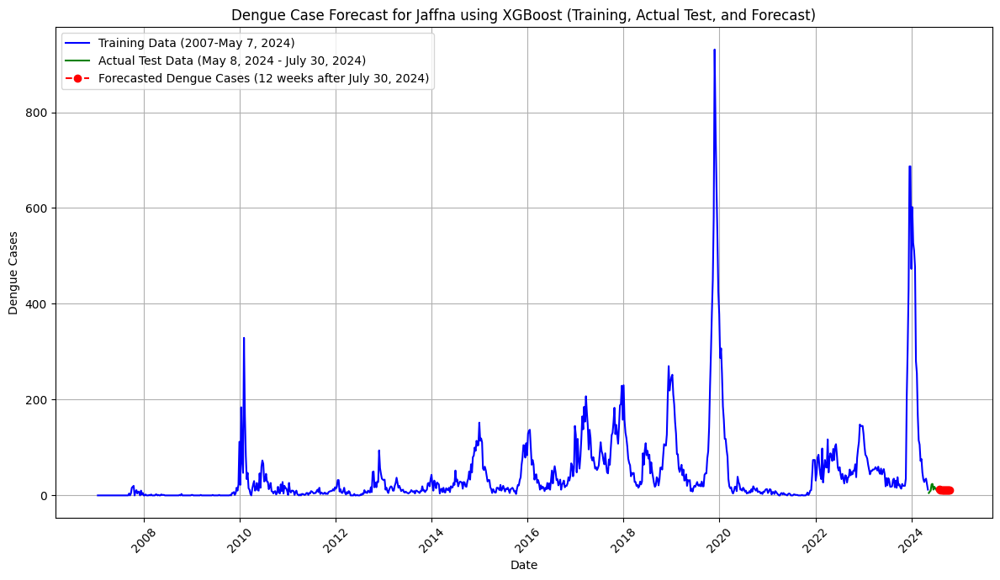


Evaluating LightGBM for district Jaffna...
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 869
[LightGBM] [Info] Number of data points in the train set: 904, number of used features: 4
[LightGBM] [Info] Start training from score 46.617257
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

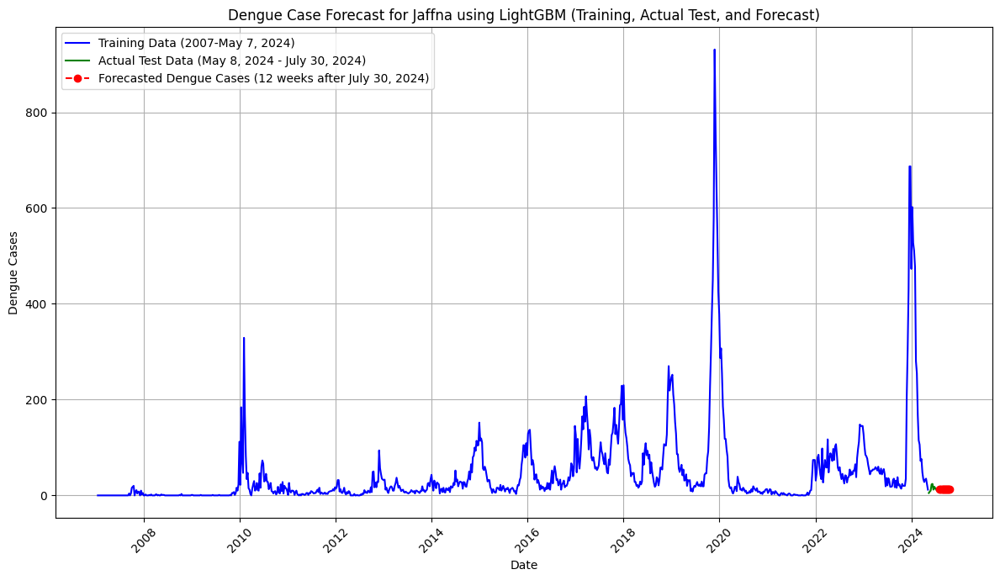


Evaluating CatBoost for district Jaffna...


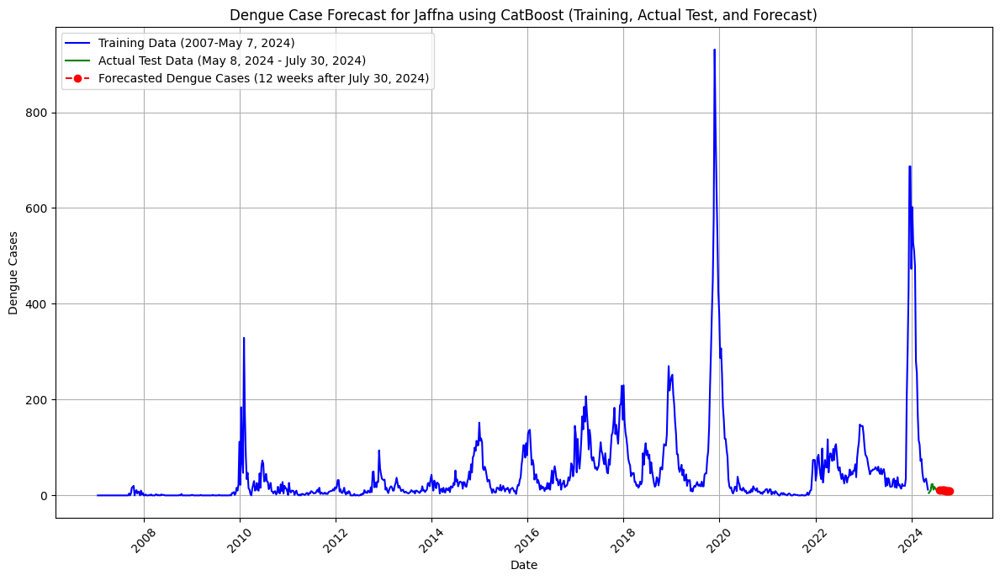


Evaluating RandomForest for district Jaffna...


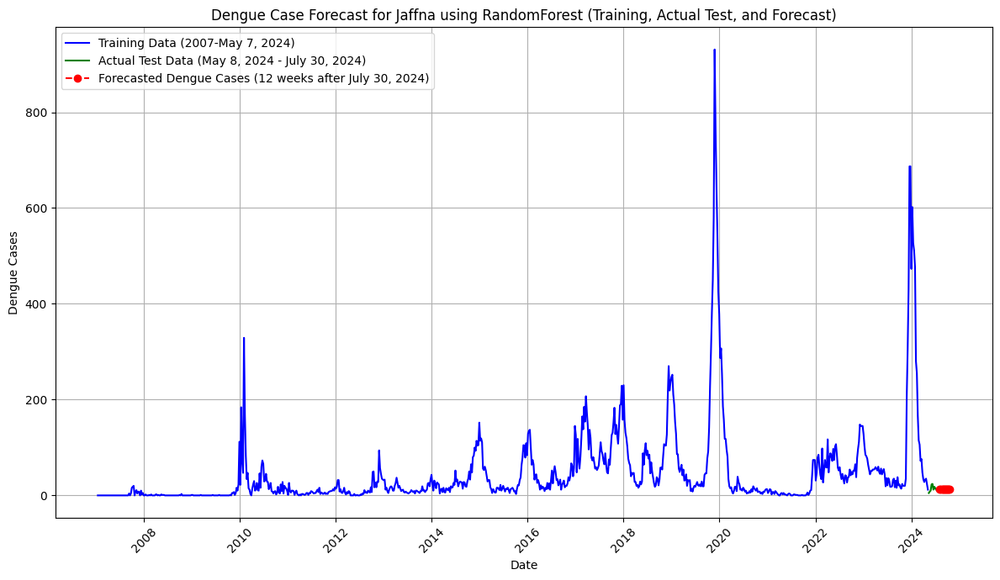


Regression RMSE per district for each model:
Puttalam - GradientBoosting: 3.6153671928619344
Puttalam - XGBoost: 3.9662331009018237
Puttalam - LightGBM: 3.672389297904032
Puttalam - CatBoost: 3.1847555619954715
Puttalam - RandomForest: 3.4669302887784617
Galle - GradientBoosting: 7.2259978962720695
Galle - XGBoost: 6.625711281538714
Galle - LightGBM: 6.130918083583304
Galle - CatBoost: 5.909257388382142
Galle - RandomForest: 4.472568212278311
Badulla - GradientBoosting: 3.800601774037672
Badulla - XGBoost: 3.5043837316469575
Badulla - LightGBM: 3.7585481790308624
Badulla - CatBoost: 3.3568382448492193
Badulla - RandomForest: 3.4738233880807883
Vavuniya - GradientBoosting: 0.7167750525789452
Vavuniya - XGBoost: 0.6430361619490771
Vavuniya - LightGBM: 1.4613683559395358
Vavuniya - CatBoost: 0.811995432913394
Vavuniya - RandomForest: 0.7340854734446142
Trincomalee - GradientBoosting: 2.450511614258753
Trincomalee - XGBoost: 2.4385759117255197
Trincomalee - LightGBM: 2.7569393020919133
Tr

In [39]:
import pandas as pd
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb
import catboost
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')

# Load the dataset
data = pd.read_csv('/kaggle/input/final-sri-lanka-dengue-cases-weather-weekly-07-24/Final Sri_lanka_dengue_cases_weather_weekly_2007_2024.csv')

# Ensure the date is in datetime format
data['Week_Start_Date'] = pd.to_datetime(data['Week_Start_Date'])

# Sort the data by date
data = data.sort_values(by='Week_Start_Date')

# Feature Engineering: Adding Lag and Rolling Mean Features
data['lag_1'] = data.groupby('District')['Number_of_Cases'].shift(1)
data['rolling_mean_3'] = data.groupby('District')['Number_of_Cases'].rolling(window=3).mean().reset_index(0, drop=True)
data = data.dropna()  # Drop rows with missing values after feature engineering

# Select features and target
features = ['Avg Max Temp (°C)', 'Total Precipitation (mm)', 'lag_1', 'rolling_mean_3']
target = 'Number_of_Cases'

# Initialize dictionary to store forecasts and RMSE
forecast_results = {}
rmse_comparison = []

# Initialize models
models = {
    'GradientBoosting': GradientBoostingRegressor(n_estimators=1000, learning_rate=0.01, max_depth=6),
    'XGBoost': xgb.XGBRegressor(n_estimators=1000, learning_rate=0.01, max_depth=6),
    'LightGBM': lgb.LGBMRegressor(n_estimators=1000, learning_rate=0.01, max_depth=6),
    'CatBoost': catboost.CatBoostRegressor(iterations=1000, learning_rate=0.01, depth=6, verbose=0),
    'RandomForest': RandomForestRegressor(n_estimators=1000, max_depth=6)
}

# Iterate through districts
for district in data['District'].unique():
    # Filter data for the current district
    district_data = data[data['District'] == district]
    
    # Ensure there are enough data points
    if len(district_data) < 532:
        print(f"Not enough data for {district}. Skipping.")
        continue

    X = district_data[features]
    y = district_data[target]

    # Split training data (2007 up to May 7, 2024)
    train_data = district_data[district_data['Week_Start_Date'] <= '2024-05-07']
    
    # Split testing data (May 8, 2024 to July 30, 2024)
    test_data = district_data[(district_data['Week_Start_Date'] > '2024-05-07') & 
                              (district_data['Week_Start_Date'] <= '2024-07-30')]
    
    # Prepare the data for 12 weeks forecasting beyond July 30, 2024
    forecast_start_date = '2024-07-30'
    forecast_end_date = pd.to_datetime(forecast_start_date) + pd.Timedelta(weeks=12)
    forecast_data = pd.DataFrame(pd.date_range(forecast_start_date, periods=12, freq='W'), columns=['Week_Start_Date'])
    
    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]

    # Train and evaluate models
    for model_name, model in models.items():
        print(f"\nEvaluating {model_name} for district {district}...")
        
        # Train the model
        model.fit(X_train, y_train)
        
        # Test period forecast (May 8, 2024 to July 30, 2024)
        y_pred = model.predict(X_test)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        rmse_comparison.append((district, model_name, rmse))
        
        # Keep actual test data (May 8, 2024, to July 30, 2024)
        forecast_actual_data = pd.DataFrame({
            'Week_Start_Date': test_data['Week_Start_Date'],
            'Actual_Dengue_Cases': test_data[target].values
        })
        
        # Forecast 12 weeks ahead from July 30, 2024
        X_forecast = X_test.iloc[-1].values.reshape(1, -1)  # Use the last row from the test data for initial forecast
        future_forecasts = []

        for _ in range(12):
            y_forecast = model.predict(X_forecast)[0]
            future_forecasts.append(y_forecast)
            
            # Update lag and rolling mean for the next prediction
            lag_1 = y_forecast
            rolling_mean_3 = np.mean([lag_1, X_forecast[0, 2], X_forecast[0, 3]])  # Update rolling mean with last 3 values
            avg_max_temp = X_forecast[0, 0]  # Keep weather features the same (or update if available)
            total_precipitation = X_forecast[0, 1]
            
            # Prepare the new row with updated features for next forecast
            X_forecast = np.array([avg_max_temp, total_precipitation, lag_1, rolling_mean_3]).reshape(1, -1)
        
        forecast_12_weeks = pd.DataFrame({
            'Week_Start_Date': forecast_data['Week_Start_Date'],
            'Forecasted_Dengue_Cases': future_forecasts
        })
        
        # Store forecast results
        forecast_results[(district, model_name)] = {
            'test_period': forecast_actual_data,
            'future_forecast': forecast_12_weeks
        }
        
        # Plot training, test, and forecast results for this district
        plt.figure(figsize=(12, 7))
        
        # Plot training data
        plt.plot(train_data['Week_Start_Date'], train_data[target], label='Training Data (2007-May 7, 2024)', color='blue')
        
        # Plot test data (actual)
        plt.plot(forecast_actual_data['Week_Start_Date'], forecast_actual_data['Actual_Dengue_Cases'], label='Actual Test Data (May 8, 2024 - July 30, 2024)', color='green')
        
        # Plot forecast data for 12 weeks ahead
        plt.plot(forecast_12_weeks['Week_Start_Date'], forecast_12_weeks['Forecasted_Dengue_Cases'], 
                 label='Forecasted Dengue Cases (12 weeks after July 30, 2024)', linestyle='--', color='red', marker='o')
        
        # Formatting the graph
        plt.xlabel('Date')
        plt.ylabel('Dengue Cases')
        plt.title(f'Dengue Case Forecast for {district} using {model_name} (Training, Actual Test, and Forecast)')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        
        # Show the plot
        plt.show()

# Calculate mean RMSE across all districts for each model
mean_rmse_per_model = {}
for model_name in models.keys():
    model_rmse = [rmse for district, name, rmse in rmse_comparison if name == model_name]
    mean_rmse_per_model[model_name] = np.mean(model_rmse)

# Print RMSE results for each district and each model
print("\nRegression RMSE per district for each model:")
for district, model_name, rmse in rmse_comparison:
    print(f"{district} - {model_name}: {rmse}")

print("\nMean RMSE across all districts for each model:")
for model_name, mean_rmse in mean_rmse_per_model.items():
    print(f"{model_name}: {mean_rmse}")